Loading Data

In [ ]:
import tensorflow as tf
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt
from numpy import zeros
from numpy import ones
from numpy.random import randn
from numpy.random import randint
from keras.datasets.cifar100 import load_data
from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout


In [ ]:
import keras
from keras.datasets import cifar10

# Load the CIFAR-10 dataset
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

# Print the shape of the training set
print("Training set shape:", x_train.shape)
print("Training labels shape:", y_train.shape)

# Print the shape of the test set
print("Test set shape:", x_test.shape)
print("Test labels shape:", y_test.shape)


170498071/170498071 [==============================] - 5s 0us/step
Training set shape: (50000, 32, 32, 3)
Training labels shape: (50000, 1)
Test set shape: (10000, 32, 32, 3)
Test labels shape: (10000, 1)


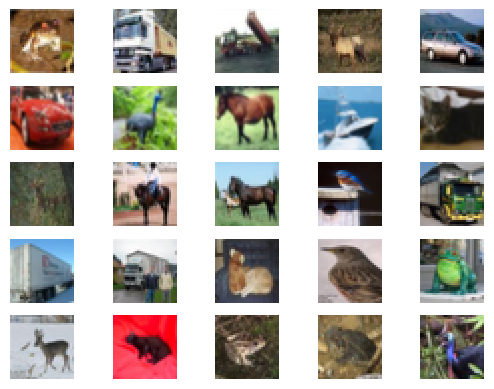

In [ ]:
# plot 25 images
for i in range(25):
	plt.subplot(5, 5, 1 + i)
	plt.axis('off')
	plt.imshow(x_train[i])
plt.show()


In [ ]:
# #   Normalize the pixel values to be between -1 and 1
# x_train = (x_train.astype("float32") - 127.5) / 127.5
# x_test  =  (x_test.astype("float32") - 127.5) / 127.5

In [ ]:
# in_shape is the shape of inou images -> 32x32  
def define_discriminator(in_shape=(32,32,3)):
	model = Sequential()
	model.add(Conv2D(256, (3,3), strides=(2,2), padding='same', input_shape=in_shape)) #16x16x256
	model.add(LeakyReLU(alpha=0.2))
	
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same')) #8x8x128
	model.add(LeakyReLU(alpha=0.2))

	model.add(Conv2D(64, (3,3), strides=(2,2), padding='same')) #8x8x64
	model.add(LeakyReLU(alpha=0.2))
 
	model.add(Conv2D(32, (3,3), strides=(2,2), padding='same')) #8x8x32
	model.add(LeakyReLU(alpha=0.2))
 
	model.add(Conv2D(16, (3,3), strides=(2,2), padding='same')) #8x8x16
	model.add(LeakyReLU(alpha=0.2))


	model.add(Flatten()) 
	model.add(Dropout(0.4))
 
	#shape = 1
	model.add(Dense(1, activation='sigmoid')) 
	# compiling model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
	return model

test_discr = define_discriminator()
print(test_discr.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 16, 16, 256)       7168      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 16, 16, 256)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         295040    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 64)          73792     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 4, 4, 64)          0         
                                                                 
 conv2d_3 (Conv2D)           (None, 2, 2, 32)          1

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [ ]:
# define the  generator model

def define_generator(latent_dim):   
	model = Sequential()
	n_nodes = 128 * 8 * 8  # 8192 nodes
	model.add(Dense(n_nodes, input_dim=latent_dim)) # Dense layer so we can work with 1D latent vector
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((8, 8, 128)))  #8x8x128 dataset from the latent vector. 
	# upsample to 16x16
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')) #16x16x128
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 32x32
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')) #32x32x128
	model.add(LeakyReLU(alpha=0.2))
	# generate
	model.add(Conv2D(3, (8,8), activation='tanh', padding='same')) #32x32x3

  # Model not compiled as it is not directly trained like the discriminator.
  # Generator is trained via GAN combined model. 
	return model  

test_gen = define_generator(100)
print(test_gen.summary())


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 8192)              827392    
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 8192)              0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 128)      262272    
 nspose)                                                         
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 32, 32, 128)      262272    
 ranspose)                                            

In [ ]:
def define_gan(generator, discriminator):
    discriminator.trainable = False

    generator._name = 'generator'
    discriminator._name = 'discriminator'

    model = Sequential(name='gan')
    model.add(generator)
    model.add(discriminator)

    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    return model


In [ ]:
# load cifar training images
def load_real_samples():
	(trainX, _), (_, _) = load_data()
	X = trainX.astype('float32')
	X = (X - 127.5) / 127.5  
	return X

def generate_real_samples(dataset, n_samples):
	ix = randint(0, dataset.shape[0], n_samples)
	X = dataset[ix]
	y = ones((n_samples, 1))
	return X, y

def generate_latent_points(latent_dim, n_samples):
	x_input = randn(latent_dim * n_samples)
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input


def generate_fake_samples(generator, latent_dim, n_samples):
	x_input = generate_latent_points(latent_dim, n_samples)
	X = generator.predict(x_input)
	y = zeros((n_samples, 1))  
	return X, y



In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:

# Plot generated images 
def show_plot(examples, n):
	for i in range(n * n):
		plt.subplot(n, n, 1 + i)
		plt.axis('off')
		plt.imshow(examples[i, :, :, :])
	plt.show()
 

def save_image(image, save_path):
    plt.imsave(save_path, image)



In [ ]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=100, n_batch=128):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)  
    
    for i in range(n_epochs):
        for j in range(bat_per_epo):           
            # Train the discriminator on real and fake images, separately (half batch each)
            X_real, y_real = generate_real_samples(dataset, half_batch)
            # update discriminator model weights
            d_loss_real, _ = d_model.train_on_batch(X_real, y_real) 

            # generate 'fake' examples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)

            # update discriminator model weights
            d_loss_fake, _ = d_model.train_on_batch(X_fake, y_fake)

            # prepare points in latent space as input for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)

            # This is where the generator is trying to trick discriminator into believing
            y_gan = ones((n_batch, 1))
            g_loss = gan_model.train_on_batch(X_gan, y_gan)

            # Print losses on this batch
            print('Epoch>%d, Batch %d/%d, d1=%.3f, d2=%.3f g=%.3f' % (i+1, j+1, bat_per_epo, d_loss_real, d_loss_fake, g_loss))

        # generate images after each epoch
        latent_points = generate_latent_points(100, 25)  #Latent dim and n_samples
        # generate images
        X = g_model.predict(latent_points)
        # scale from [-1,1] to [0,1]
        X = (X + 1) / 2.0
        import numpy as np
        X = (X*255).astype(np.uint8)
        # plot the result
        show_plot(X, 5)

    # save the generated images after each epoch
        for k in range(len(X)):
          img_name = f'epoch{i+1}_img{k+1}.png'
          save_path = '/content/drive/MyDrive/GAN/generated_images_3/' + img_name
          save_image(X[k], save_path)

    # save the generator model
    g_model.save('/content/drive/MyDrive/GAN/cifar_GAN_3.h5')


2/2 [==============================] - 0s 9ms/step
Epoch>1, Batch 1/390, d1=0.693, d2=0.695 g=0.692
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 2/390, d1=0.658, d2=0.697 g=0.689
2/2 [==============================] - 0s 9ms/step
Epoch>1, Batch 3/390, d1=0.631, d2=0.705 g=0.682
2/2 [==============================] - 0s 10ms/step
Epoch>1, Batch 4/390, d1=0.575, d2=0.722 g=0.668
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 5/390, d1=0.542, d2=0.744 g=0.649
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 6/390, d1=0.474, d2=0.780 g=0.632
2/2 [==============================] - 0s 8ms/step
Epoch>1, Batch 7/390, d1=0.425, d2=0.811 g=0.625
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 8/390, d1=0.386, d2=0.804 g=0.654
2/2 [==============================] - 0s 9ms/step
Epoch>1, Batch 9/390, d1=0.364, d2=0.737 g=0.714
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 10/390, d1=0.359, d2=0.673 g=0.73

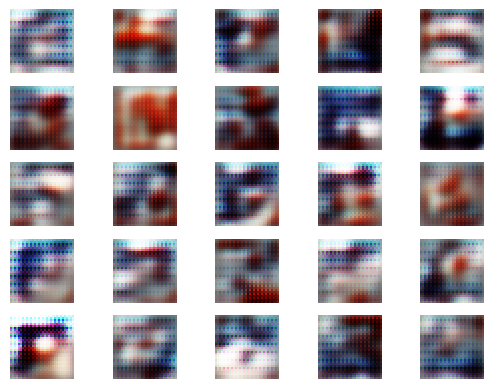

2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 1/390, d1=0.665, d2=0.593 g=0.862
2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 2/390, d1=0.583, d2=0.624 g=0.864
2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 3/390, d1=0.566, d2=0.634 g=0.902
2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 4/390, d1=0.657, d2=0.647 g=0.907
2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 5/390, d1=0.588, d2=0.579 g=0.950
2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 6/390, d1=0.640, d2=0.568 g=0.981
2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 7/390, d1=0.616, d2=0.573 g=1.021
2/2 [==============================] - 0s 10ms/step
Epoch>2, Batch 8/390, d1=0.611, d2=0.578 g=1.048
2/2 [==============================] - 0s 4ms/step
Epoch>2, Batch 9/390, d1=0.670, d2=0.559 g=1.034
2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 10/390, d1=0.604, d2=0.566 g=1.00

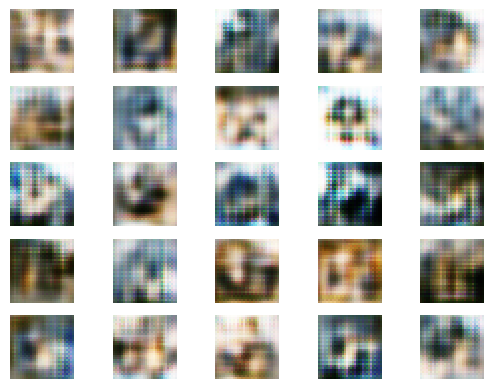

2/2 [==============================] - 0s 11ms/step
Epoch>3, Batch 1/390, d1=0.588, d2=0.709 g=0.769
2/2 [==============================] - 0s 10ms/step
Epoch>3, Batch 2/390, d1=0.629, d2=0.745 g=0.744
2/2 [==============================] - 0s 9ms/step
Epoch>3, Batch 3/390, d1=0.670, d2=0.713 g=0.758
2/2 [==============================] - 0s 9ms/step
Epoch>3, Batch 4/390, d1=0.642, d2=0.699 g=0.737
2/2 [==============================] - 0s 8ms/step
Epoch>3, Batch 5/390, d1=0.677, d2=0.724 g=0.749
2/2 [==============================] - 0s 10ms/step
Epoch>3, Batch 6/390, d1=0.629, d2=0.704 g=0.755
2/2 [==============================] - 0s 9ms/step
Epoch>3, Batch 7/390, d1=0.604, d2=0.751 g=0.758
2/2 [==============================] - 0s 8ms/step
Epoch>3, Batch 8/390, d1=0.613, d2=0.710 g=0.792
2/2 [==============================] - 0s 9ms/step
Epoch>3, Batch 9/390, d1=0.622, d2=0.704 g=0.801
2/2 [==============================] - 0s 8ms/step
Epoch>3, Batch 10/390, d1=0.580, d2=0.685 g=0.

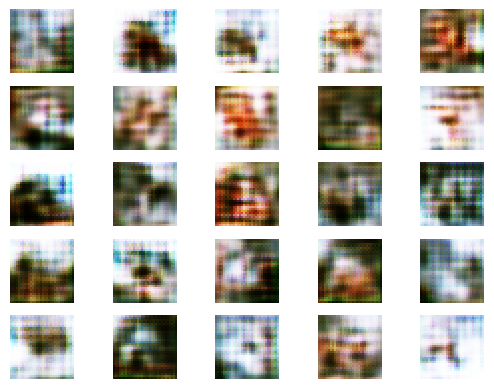

2/2 [==============================] - 0s 11ms/step
Epoch>4, Batch 1/390, d1=0.636, d2=0.620 g=0.808
2/2 [==============================] - 0s 12ms/step
Epoch>4, Batch 2/390, d1=0.611, d2=0.673 g=0.831
2/2 [==============================] - 0s 10ms/step
Epoch>4, Batch 3/390, d1=0.589, d2=0.618 g=0.806
2/2 [==============================] - 0s 7ms/step
Epoch>4, Batch 4/390, d1=0.595, d2=0.649 g=0.822
2/2 [==============================] - 0s 9ms/step
Epoch>4, Batch 5/390, d1=0.609, d2=0.682 g=0.814
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 6/390, d1=0.614, d2=0.658 g=0.801
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 7/390, d1=0.610, d2=0.665 g=0.805
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 8/390, d1=0.636, d2=0.656 g=0.820
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 9/390, d1=0.648, d2=0.652 g=0.823
2/2 [==============================] - 0s 6ms/step
Epoch>4, Batch 10/390, d1=0.613, d2=0.679 g=0.

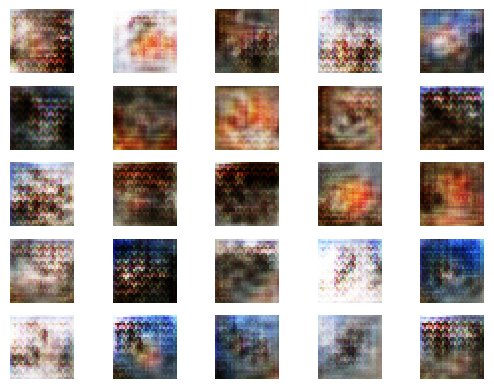

2/2 [==============================] - 0s 14ms/step
Epoch>5, Batch 1/390, d1=0.607, d2=0.543 g=0.992
2/2 [==============================] - 0s 13ms/step
Epoch>5, Batch 2/390, d1=0.648, d2=0.571 g=0.971
2/2 [==============================] - 0s 9ms/step
Epoch>5, Batch 3/390, d1=0.612, d2=0.651 g=0.898
2/2 [==============================] - 0s 9ms/step
Epoch>5, Batch 4/390, d1=0.585, d2=0.662 g=0.832
2/2 [==============================] - 0s 8ms/step
Epoch>5, Batch 5/390, d1=0.635, d2=0.685 g=0.781
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 6/390, d1=0.553, d2=0.706 g=0.782
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 7/390, d1=0.539, d2=0.755 g=0.783
2/2 [==============================] - 0s 5ms/step
Epoch>5, Batch 8/390, d1=0.626, d2=0.689 g=0.801
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 9/390, d1=0.563, d2=0.684 g=0.828
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 10/390, d1=0.599, d2=0.629 g=0.8

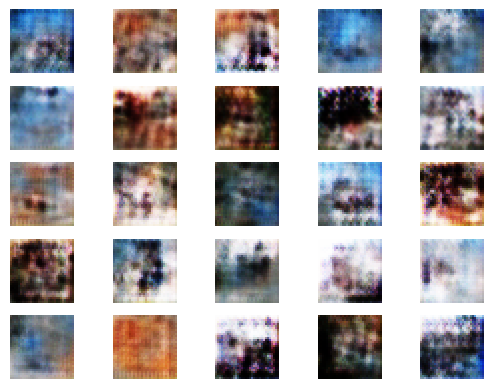

2/2 [==============================] - 0s 4ms/step
Epoch>6, Batch 1/390, d1=0.604, d2=0.639 g=0.822
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 2/390, d1=0.579, d2=0.687 g=0.806
2/2 [==============================] - 0s 7ms/step
Epoch>6, Batch 3/390, d1=0.621, d2=0.707 g=0.760
2/2 [==============================] - 0s 7ms/step
Epoch>6, Batch 4/390, d1=0.591, d2=0.703 g=0.752
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 5/390, d1=0.604, d2=0.799 g=0.762
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 6/390, d1=0.708, d2=0.722 g=0.744
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 7/390, d1=0.638, d2=0.759 g=0.721
2/2 [==============================] - 0s 14ms/step
Epoch>6, Batch 8/390, d1=0.650, d2=0.805 g=0.733
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 9/390, d1=0.612, d2=0.726 g=0.722
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 10/390, d1=0.566, d2=0.784 g=0.75

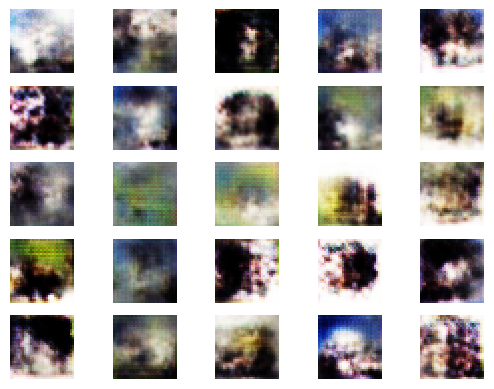

2/2 [==============================] - 0s 5ms/step
Epoch>7, Batch 1/390, d1=0.656, d2=0.676 g=0.717
2/2 [==============================] - 0s 4ms/step
Epoch>7, Batch 2/390, d1=0.664, d2=0.680 g=0.710
2/2 [==============================] - 0s 4ms/step
Epoch>7, Batch 3/390, d1=0.670, d2=0.700 g=0.710
2/2 [==============================] - 0s 7ms/step
Epoch>7, Batch 4/390, d1=0.643, d2=0.690 g=0.709
2/2 [==============================] - 0s 4ms/step
Epoch>7, Batch 5/390, d1=0.642, d2=0.694 g=0.715
2/2 [==============================] - 0s 6ms/step
Epoch>7, Batch 6/390, d1=0.637, d2=0.709 g=0.715
2/2 [==============================] - 0s 10ms/step
Epoch>7, Batch 7/390, d1=0.689, d2=0.730 g=0.692
2/2 [==============================] - 0s 9ms/step
Epoch>7, Batch 8/390, d1=0.672, d2=0.725 g=0.707
2/2 [==============================] - 0s 7ms/step
Epoch>7, Batch 9/390, d1=0.672, d2=0.739 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>7, Batch 10/390, d1=0.658, d2=0.728 g=0.7

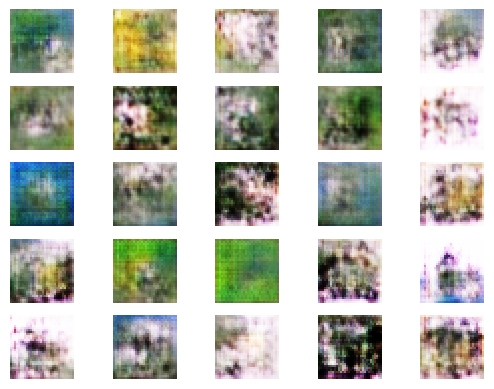

2/2 [==============================] - 0s 6ms/step
Epoch>8, Batch 1/390, d1=0.695, d2=0.651 g=0.788
2/2 [==============================] - 0s 15ms/step
Epoch>8, Batch 2/390, d1=0.722, d2=0.655 g=0.781
2/2 [==============================] - 0s 11ms/step
Epoch>8, Batch 3/390, d1=0.695, d2=0.643 g=0.782
2/2 [==============================] - 0s 9ms/step
Epoch>8, Batch 4/390, d1=0.678, d2=0.656 g=0.775
2/2 [==============================] - 0s 8ms/step
Epoch>8, Batch 5/390, d1=0.639, d2=0.691 g=0.818
2/2 [==============================] - 0s 10ms/step
Epoch>8, Batch 6/390, d1=0.670, d2=0.623 g=0.764
2/2 [==============================] - 0s 10ms/step
Epoch>8, Batch 7/390, d1=0.622, d2=0.698 g=0.775
2/2 [==============================] - 0s 14ms/step
Epoch>8, Batch 8/390, d1=0.668, d2=0.670 g=0.803
2/2 [==============================] - 0s 12ms/step
Epoch>8, Batch 9/390, d1=0.657, d2=0.640 g=0.818
2/2 [==============================] - 0s 4ms/step
Epoch>8, Batch 10/390, d1=0.737, d2=0.607 g

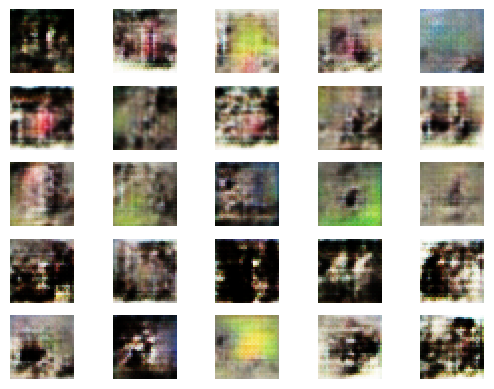

2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 1/390, d1=0.673, d2=0.581 g=0.859
2/2 [==============================] - 0s 5ms/step
Epoch>9, Batch 2/390, d1=0.615, d2=0.648 g=0.835
2/2 [==============================] - 0s 5ms/step
Epoch>9, Batch 3/390, d1=0.647, d2=0.680 g=0.820
2/2 [==============================] - 0s 4ms/step
Epoch>9, Batch 4/390, d1=0.616, d2=0.686 g=0.782
2/2 [==============================] - 0s 4ms/step
Epoch>9, Batch 5/390, d1=0.631, d2=0.666 g=0.784
2/2 [==============================] - 0s 4ms/step
Epoch>9, Batch 6/390, d1=0.624, d2=0.716 g=0.772
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 7/390, d1=0.641, d2=0.695 g=0.801
2/2 [==============================] - 0s 11ms/step
Epoch>9, Batch 8/390, d1=0.681, d2=0.681 g=0.775
2/2 [==============================] - 0s 7ms/step
Epoch>9, Batch 9/390, d1=0.663, d2=0.652 g=0.803
2/2 [==============================] - 0s 7ms/step
Epoch>9, Batch 10/390, d1=0.617, d2=0.709 g=0.78

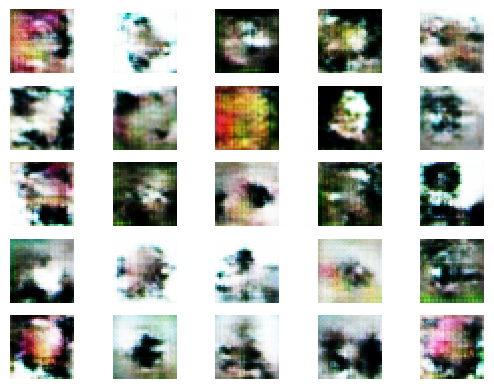

2/2 [==============================] - 0s 6ms/step
Epoch>10, Batch 1/390, d1=0.634, d2=0.701 g=0.872
2/2 [==============================] - 0s 9ms/step
Epoch>10, Batch 2/390, d1=0.714, d2=0.607 g=0.915
2/2 [==============================] - 0s 13ms/step
Epoch>10, Batch 3/390, d1=0.769, d2=0.574 g=0.883
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 4/390, d1=0.767, d2=0.598 g=0.861
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 5/390, d1=0.787, d2=0.631 g=0.828
2/2 [==============================] - 0s 12ms/step
Epoch>10, Batch 6/390, d1=0.692, d2=0.635 g=0.838
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 7/390, d1=0.637, d2=0.636 g=0.778
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 8/390, d1=0.642, d2=0.699 g=0.827
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 9/390, d1=0.646, d2=0.598 g=0.817
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 10/390, d1=0.638, d2=0

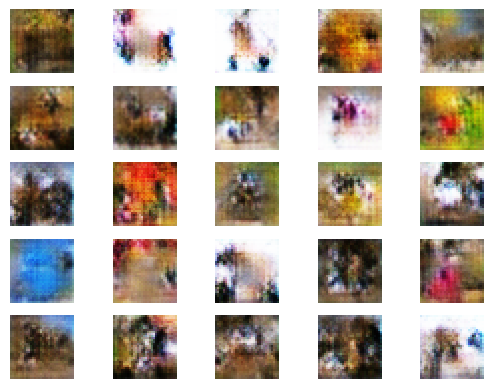

2/2 [==============================] - 0s 11ms/step
Epoch>11, Batch 1/390, d1=0.632, d2=0.680 g=0.824
2/2 [==============================] - 0s 7ms/step
Epoch>11, Batch 2/390, d1=0.584, d2=0.690 g=0.810
2/2 [==============================] - 0s 8ms/step
Epoch>11, Batch 3/390, d1=0.583, d2=0.637 g=0.784
2/2 [==============================] - 0s 6ms/step
Epoch>11, Batch 4/390, d1=0.546, d2=0.737 g=0.736
2/2 [==============================] - 0s 6ms/step
Epoch>11, Batch 5/390, d1=0.544, d2=0.949 g=0.786
2/2 [==============================] - 0s 10ms/step
Epoch>11, Batch 6/390, d1=0.608, d2=0.844 g=0.820
2/2 [==============================] - 0s 7ms/step
Epoch>11, Batch 7/390, d1=0.667, d2=0.669 g=0.817
2/2 [==============================] - 0s 11ms/step
Epoch>11, Batch 8/390, d1=0.739, d2=0.658 g=0.833
2/2 [==============================] - 0s 5ms/step
Epoch>11, Batch 9/390, d1=0.701, d2=0.649 g=0.833
2/2 [==============================] - 0s 5ms/step
Epoch>11, Batch 10/390, d1=0.758, d2=

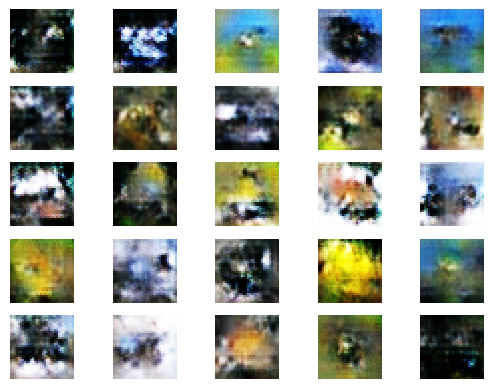

2/2 [==============================] - 0s 7ms/step
Epoch>12, Batch 1/390, d1=0.580, d2=0.592 g=0.850
2/2 [==============================] - 0s 14ms/step
Epoch>12, Batch 2/390, d1=0.537, d2=0.638 g=0.849
2/2 [==============================] - 0s 7ms/step
Epoch>12, Batch 3/390, d1=0.655, d2=0.645 g=0.835
2/2 [==============================] - 0s 15ms/step
Epoch>12, Batch 4/390, d1=0.547, d2=0.715 g=0.849
2/2 [==============================] - 0s 13ms/step
Epoch>12, Batch 5/390, d1=0.600, d2=0.677 g=0.864
2/2 [==============================] - 0s 15ms/step
Epoch>12, Batch 6/390, d1=0.698, d2=0.639 g=0.850
2/2 [==============================] - 0s 12ms/step
Epoch>12, Batch 7/390, d1=0.612, d2=0.610 g=0.824
2/2 [==============================] - 0s 12ms/step
Epoch>12, Batch 8/390, d1=0.615, d2=0.690 g=0.855
2/2 [==============================] - 0s 5ms/step
Epoch>12, Batch 9/390, d1=0.584, d2=0.696 g=0.841
2/2 [==============================] - 0s 13ms/step
Epoch>12, Batch 10/390, d1=0.612,

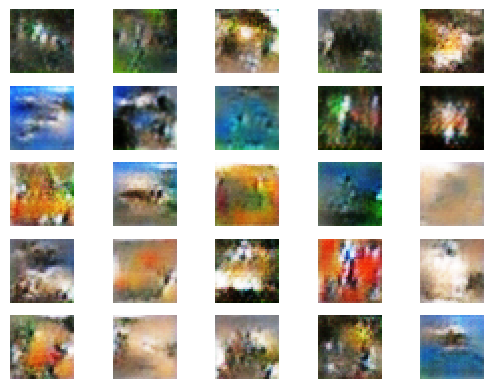

2/2 [==============================] - 0s 8ms/step
Epoch>13, Batch 1/390, d1=0.701, d2=0.613 g=0.797
2/2 [==============================] - 0s 6ms/step
Epoch>13, Batch 2/390, d1=0.662, d2=0.669 g=0.776
2/2 [==============================] - 0s 11ms/step
Epoch>13, Batch 3/390, d1=0.685, d2=0.708 g=0.774
2/2 [==============================] - 0s 7ms/step
Epoch>13, Batch 4/390, d1=0.644, d2=0.699 g=0.776
2/2 [==============================] - 0s 9ms/step
Epoch>13, Batch 5/390, d1=0.718, d2=0.704 g=0.779
2/2 [==============================] - 0s 10ms/step
Epoch>13, Batch 6/390, d1=0.656, d2=0.666 g=0.784
2/2 [==============================] - 0s 5ms/step
Epoch>13, Batch 7/390, d1=0.711, d2=0.644 g=0.779
2/2 [==============================] - 0s 6ms/step
Epoch>13, Batch 8/390, d1=0.725, d2=0.677 g=0.799
2/2 [==============================] - 0s 6ms/step
Epoch>13, Batch 9/390, d1=0.656, d2=0.636 g=0.785
2/2 [==============================] - 0s 5ms/step
Epoch>13, Batch 10/390, d1=0.689, d2=0

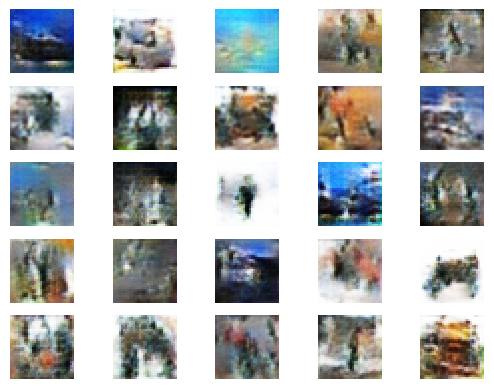

2/2 [==============================] - 0s 11ms/step
Epoch>14, Batch 1/390, d1=0.665, d2=0.664 g=0.759
2/2 [==============================] - 0s 7ms/step
Epoch>14, Batch 2/390, d1=0.649, d2=0.661 g=0.741
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 3/390, d1=0.630, d2=0.725 g=0.744
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 4/390, d1=0.627, d2=0.761 g=0.747
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 5/390, d1=0.616, d2=0.679 g=0.734
2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 6/390, d1=0.658, d2=0.676 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 7/390, d1=0.677, d2=0.705 g=0.749
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 8/390, d1=0.632, d2=0.686 g=0.746
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 9/390, d1=0.681, d2=0.689 g=0.758
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 10/390, d1=0.654, d2=0.

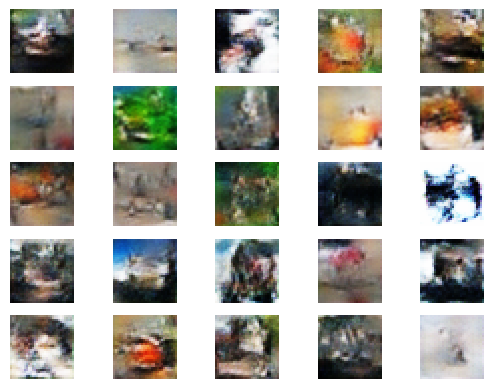

2/2 [==============================] - 0s 13ms/step
Epoch>15, Batch 1/390, d1=0.622, d2=0.702 g=0.771
2/2 [==============================] - 0s 7ms/step
Epoch>15, Batch 2/390, d1=0.642, d2=0.730 g=0.775
2/2 [==============================] - 0s 13ms/step
Epoch>15, Batch 3/390, d1=0.630, d2=0.735 g=0.798
2/2 [==============================] - 0s 7ms/step
Epoch>15, Batch 4/390, d1=0.640, d2=0.820 g=0.814
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 5/390, d1=0.720, d2=0.635 g=0.802
2/2 [==============================] - 0s 5ms/step
Epoch>15, Batch 6/390, d1=0.743, d2=0.641 g=0.812
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 7/390, d1=0.711, d2=0.617 g=0.827
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 8/390, d1=0.725, d2=0.591 g=0.813
2/2 [==============================] - 0s 5ms/step
Epoch>15, Batch 9/390, d1=0.731, d2=0.613 g=0.812
2/2 [==============================] - 0s 5ms/step
Epoch>15, Batch 10/390, d1=0.742, d2=0

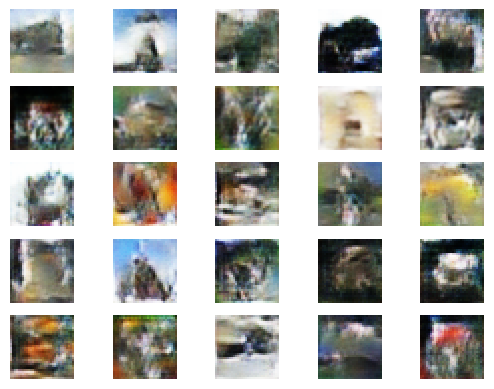

2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 1/390, d1=0.685, d2=0.646 g=0.772
2/2 [==============================] - 0s 10ms/step
Epoch>16, Batch 2/390, d1=0.701, d2=0.642 g=0.758
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 3/390, d1=0.660, d2=0.633 g=0.767
2/2 [==============================] - 0s 18ms/step
Epoch>16, Batch 4/390, d1=0.648, d2=0.708 g=0.764
2/2 [==============================] - 0s 13ms/step
Epoch>16, Batch 5/390, d1=0.654, d2=0.666 g=0.776
2/2 [==============================] - 0s 7ms/step
Epoch>16, Batch 6/390, d1=0.676, d2=0.632 g=0.788
2/2 [==============================] - 0s 10ms/step
Epoch>16, Batch 7/390, d1=0.679, d2=0.693 g=0.795
2/2 [==============================] - 0s 9ms/step
Epoch>16, Batch 8/390, d1=0.722, d2=0.633 g=0.795
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 9/390, d1=0.695, d2=0.627 g=0.765
2/2 [==============================] - 0s 4ms/step
Epoch>16, Batch 10/390, d1=0.657, d2

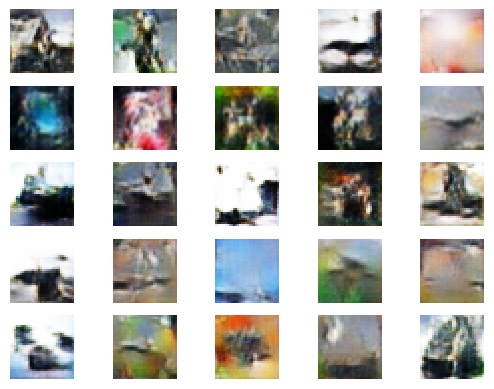

2/2 [==============================] - 0s 13ms/step
Epoch>17, Batch 1/390, d1=0.709, d2=0.627 g=0.771
2/2 [==============================] - 0s 6ms/step
Epoch>17, Batch 2/390, d1=0.690, d2=0.651 g=0.810
2/2 [==============================] - 0s 10ms/step
Epoch>17, Batch 3/390, d1=0.719, d2=0.662 g=0.799
2/2 [==============================] - 0s 5ms/step
Epoch>17, Batch 4/390, d1=0.700, d2=0.631 g=0.796
2/2 [==============================] - 0s 11ms/step
Epoch>17, Batch 5/390, d1=0.680, d2=0.623 g=0.799
2/2 [==============================] - 0s 4ms/step
Epoch>17, Batch 6/390, d1=0.697, d2=0.666 g=0.804
2/2 [==============================] - 0s 4ms/step
Epoch>17, Batch 7/390, d1=0.699, d2=0.627 g=0.778
2/2 [==============================] - 0s 10ms/step
Epoch>17, Batch 8/390, d1=0.713, d2=0.643 g=0.798
2/2 [==============================] - 0s 5ms/step
Epoch>17, Batch 9/390, d1=0.705, d2=0.671 g=0.763
2/2 [==============================] - 0s 4ms/step
Epoch>17, Batch 10/390, d1=0.664, d2

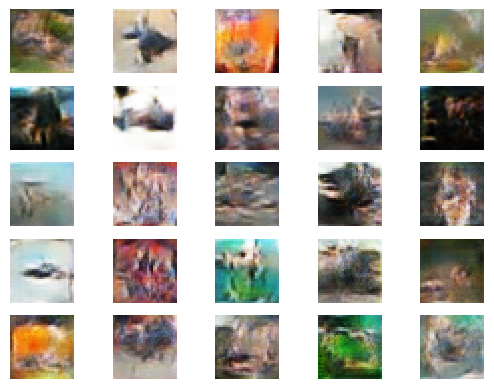

2/2 [==============================] - 0s 15ms/step
Epoch>18, Batch 1/390, d1=0.646, d2=0.703 g=0.754
2/2 [==============================] - 0s 6ms/step
Epoch>18, Batch 2/390, d1=0.656, d2=0.814 g=0.740
2/2 [==============================] - 0s 10ms/step
Epoch>18, Batch 3/390, d1=0.701, d2=0.679 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>18, Batch 4/390, d1=0.690, d2=0.838 g=0.745
2/2 [==============================] - 0s 5ms/step
Epoch>18, Batch 5/390, d1=0.745, d2=0.661 g=0.774
2/2 [==============================] - 0s 10ms/step
Epoch>18, Batch 6/390, d1=0.766, d2=0.618 g=0.778
2/2 [==============================] - 0s 7ms/step
Epoch>18, Batch 7/390, d1=0.773, d2=0.612 g=0.787
2/2 [==============================] - 0s 12ms/step
Epoch>18, Batch 8/390, d1=0.733, d2=0.627 g=0.771
2/2 [==============================] - 0s 9ms/step
Epoch>18, Batch 9/390, d1=0.754, d2=0.641 g=0.773
2/2 [==============================] - 0s 4ms/step
Epoch>18, Batch 10/390, d1=0.647, d2

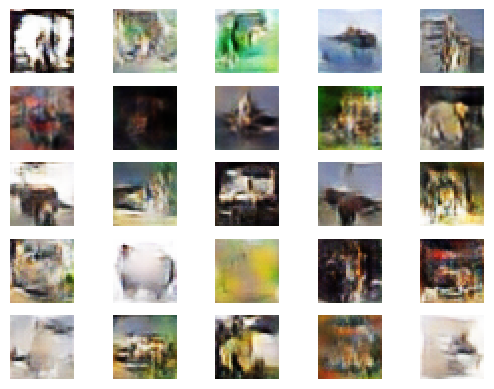

2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 1/390, d1=0.698, d2=0.675 g=0.726
2/2 [==============================] - 0s 9ms/step
Epoch>19, Batch 2/390, d1=0.716, d2=0.690 g=0.725
2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 3/390, d1=0.725, d2=0.670 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>19, Batch 4/390, d1=0.704, d2=0.666 g=0.730
2/2 [==============================] - 0s 8ms/step
Epoch>19, Batch 5/390, d1=0.712, d2=0.660 g=0.726
2/2 [==============================] - 0s 20ms/step
Epoch>19, Batch 6/390, d1=0.715, d2=0.662 g=0.716
2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 7/390, d1=0.657, d2=0.692 g=0.714
2/2 [==============================] - 0s 8ms/step
Epoch>19, Batch 8/390, d1=0.656, d2=0.693 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 9/390, d1=0.644, d2=0.676 g=0.714
2/2 [==============================] - 0s 4ms/step
Epoch>19, Batch 10/390, d1=0.632, d2=0.

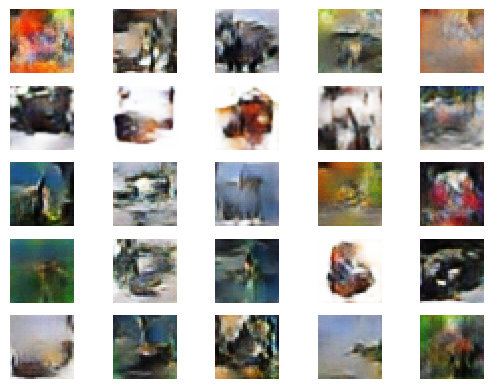

2/2 [==============================] - 0s 13ms/step
Epoch>20, Batch 1/390, d1=0.688, d2=0.668 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 2/390, d1=0.673, d2=0.702 g=0.718
2/2 [==============================] - 0s 9ms/step
Epoch>20, Batch 3/390, d1=0.636, d2=0.688 g=0.713
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 4/390, d1=0.685, d2=0.688 g=0.713
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 5/390, d1=0.680, d2=0.705 g=0.691
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 6/390, d1=0.653, d2=0.685 g=0.705
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 7/390, d1=0.678, d2=0.688 g=0.705
2/2 [==============================] - 0s 13ms/step
Epoch>20, Batch 8/390, d1=0.670, d2=0.696 g=0.714
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 9/390, d1=0.677, d2=0.686 g=0.702
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 10/390, d1=0.607, d2=0

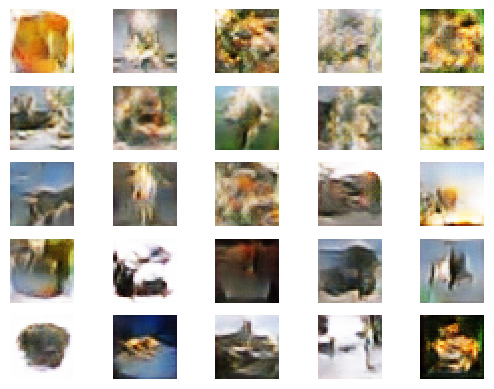

2/2 [==============================] - 0s 13ms/step
Epoch>21, Batch 1/390, d1=0.680, d2=0.665 g=0.716
2/2 [==============================] - 0s 13ms/step
Epoch>21, Batch 2/390, d1=0.697, d2=0.692 g=0.730
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 3/390, d1=0.669, d2=0.708 g=0.732
2/2 [==============================] - 0s 4ms/step
Epoch>21, Batch 4/390, d1=0.686, d2=0.673 g=0.736
2/2 [==============================] - 0s 6ms/step
Epoch>21, Batch 5/390, d1=0.713, d2=0.655 g=0.736
2/2 [==============================] - 0s 4ms/step
Epoch>21, Batch 6/390, d1=0.699, d2=0.666 g=0.735
2/2 [==============================] - 0s 4ms/step
Epoch>21, Batch 7/390, d1=0.693, d2=0.675 g=0.725
2/2 [==============================] - 0s 12ms/step
Epoch>21, Batch 8/390, d1=0.686, d2=0.709 g=0.727
2/2 [==============================] - 0s 6ms/step
Epoch>21, Batch 9/390, d1=0.707, d2=0.671 g=0.732
2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 10/390, d1=0.695, d2=

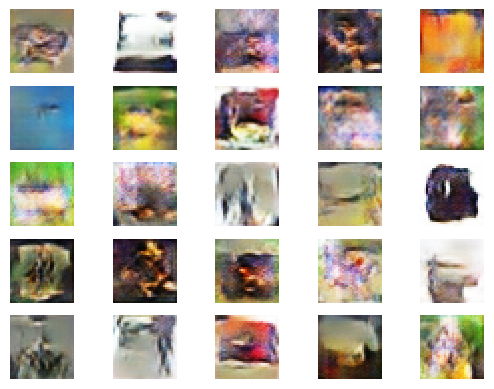

2/2 [==============================] - 0s 7ms/step
Epoch>22, Batch 1/390, d1=0.697, d2=0.667 g=0.719
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 2/390, d1=0.671, d2=0.710 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 3/390, d1=0.701, d2=0.667 g=0.719
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 4/390, d1=0.705, d2=0.679 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 5/390, d1=0.708, d2=0.682 g=0.736
2/2 [==============================] - 0s 12ms/step
Epoch>22, Batch 6/390, d1=0.703, d2=0.661 g=0.767
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 7/390, d1=0.675, d2=0.647 g=0.751
2/2 [==============================] - 0s 5ms/step
Epoch>22, Batch 8/390, d1=0.697, d2=0.688 g=0.742
2/2 [==============================] - 0s 9ms/step
Epoch>22, Batch 9/390, d1=0.681, d2=0.702 g=0.728
2/2 [==============================] - 0s 5ms/step
Epoch>22, Batch 10/390, d1=0.698, d2=0.

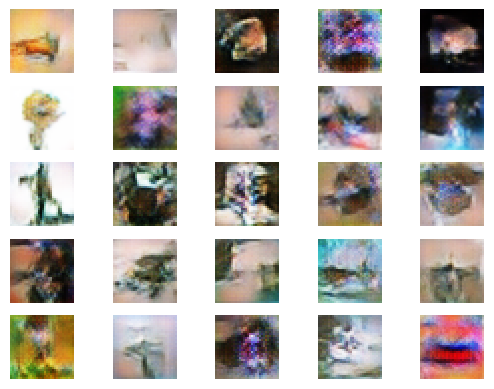

2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 1/390, d1=0.699, d2=0.690 g=0.712
2/2 [==============================] - 0s 14ms/step
Epoch>23, Batch 2/390, d1=0.688, d2=0.680 g=0.711
2/2 [==============================] - 0s 8ms/step
Epoch>23, Batch 3/390, d1=0.680, d2=0.697 g=0.709
2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 4/390, d1=0.700, d2=0.695 g=0.708
2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 5/390, d1=0.696, d2=0.686 g=0.716
2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 6/390, d1=0.681, d2=0.693 g=0.718
2/2 [==============================] - 0s 5ms/step
Epoch>23, Batch 7/390, d1=0.705, d2=0.676 g=0.717
2/2 [==============================] - 0s 8ms/step
Epoch>23, Batch 8/390, d1=0.694, d2=0.681 g=0.716
2/2 [==============================] - 0s 6ms/step
Epoch>23, Batch 9/390, d1=0.644, d2=0.675 g=0.720
2/2 [==============================] - 0s 5ms/step
Epoch>23, Batch 10/390, d1=0.684, d2=0.

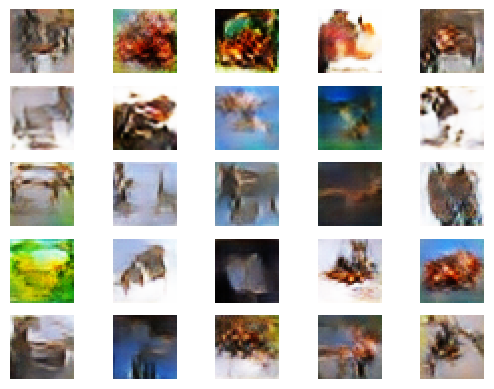

2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 1/390, d1=0.691, d2=0.738 g=0.707
2/2 [==============================] - 0s 16ms/step
Epoch>24, Batch 2/390, d1=0.647, d2=0.714 g=0.711
2/2 [==============================] - 0s 4ms/step
Epoch>24, Batch 3/390, d1=0.688, d2=0.687 g=0.716
2/2 [==============================] - 0s 5ms/step
Epoch>24, Batch 4/390, d1=0.698, d2=0.676 g=0.719
2/2 [==============================] - 0s 8ms/step
Epoch>24, Batch 5/390, d1=0.693, d2=0.673 g=0.702
2/2 [==============================] - 0s 8ms/step
Epoch>24, Batch 6/390, d1=0.697, d2=0.703 g=0.710
2/2 [==============================] - 0s 5ms/step
Epoch>24, Batch 7/390, d1=0.678, d2=0.694 g=0.725
2/2 [==============================] - 0s 8ms/step
Epoch>24, Batch 8/390, d1=0.705, d2=0.665 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 9/390, d1=0.707, d2=0.670 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 10/390, d1=0.706, d2=0.

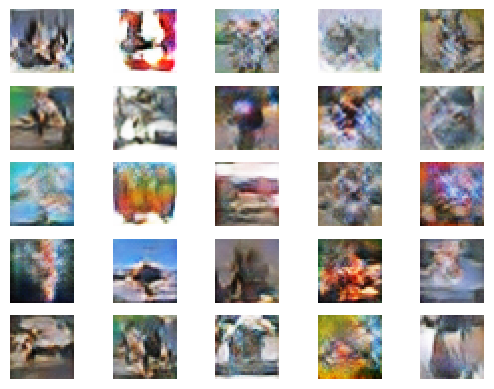

2/2 [==============================] - 0s 8ms/step
Epoch>25, Batch 1/390, d1=0.678, d2=0.670 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 2/390, d1=0.684, d2=0.688 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 3/390, d1=0.687, d2=0.699 g=0.713
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 4/390, d1=0.685, d2=0.753 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 5/390, d1=0.710, d2=0.674 g=0.718
2/2 [==============================] - 0s 12ms/step
Epoch>25, Batch 6/390, d1=0.707, d2=0.683 g=0.730
2/2 [==============================] - 0s 7ms/step
Epoch>25, Batch 7/390, d1=0.698, d2=0.654 g=0.734
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 8/390, d1=0.706, d2=0.657 g=0.733
2/2 [==============================] - 0s 13ms/step
Epoch>25, Batch 9/390, d1=0.720, d2=0.670 g=0.731
2/2 [==============================] - 0s 7ms/step
Epoch>25, Batch 10/390, d1=0.701, d2=0

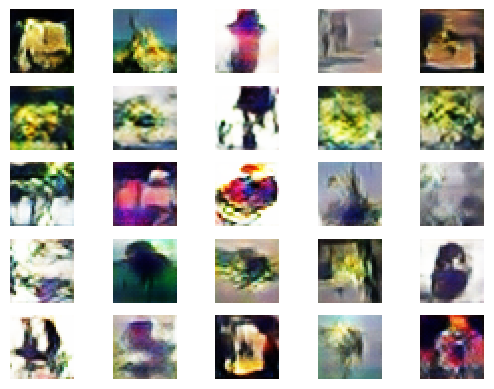

2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 1/390, d1=0.705, d2=0.663 g=0.730
2/2 [==============================] - 0s 5ms/step
Epoch>26, Batch 2/390, d1=0.694, d2=0.670 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 3/390, d1=0.691, d2=0.677 g=0.720
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 4/390, d1=0.688, d2=0.676 g=0.712
2/2 [==============================] - 0s 4ms/step
Epoch>26, Batch 5/390, d1=0.691, d2=0.682 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 6/390, d1=0.677, d2=0.728 g=0.735
2/2 [==============================] - 0s 5ms/step
Epoch>26, Batch 7/390, d1=0.702, d2=0.688 g=0.737
2/2 [==============================] - 0s 4ms/step
Epoch>26, Batch 8/390, d1=0.714, d2=0.652 g=0.742
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 9/390, d1=0.718, d2=0.663 g=0.735
2/2 [==============================] - 0s 5ms/step
Epoch>26, Batch 10/390, d1=0.703, d2=0.6

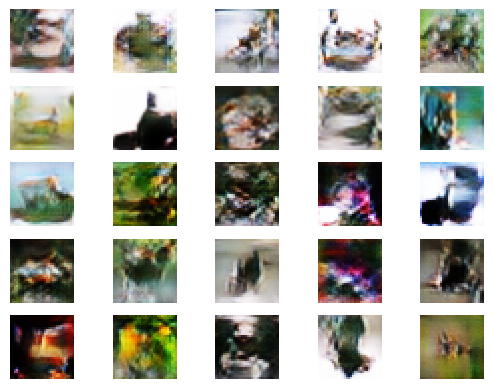

2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 1/390, d1=0.687, d2=0.665 g=0.723
2/2 [==============================] - 0s 8ms/step
Epoch>27, Batch 2/390, d1=0.711, d2=0.660 g=0.732
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 3/390, d1=0.710, d2=0.659 g=0.734
2/2 [==============================] - 0s 9ms/step
Epoch>27, Batch 4/390, d1=0.715, d2=0.703 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 5/390, d1=0.692, d2=0.664 g=0.722
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 6/390, d1=0.700, d2=0.677 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 7/390, d1=0.714, d2=0.669 g=0.732
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 8/390, d1=0.702, d2=0.670 g=0.724
2/2 [==============================] - 0s 8ms/step
Epoch>27, Batch 9/390, d1=0.701, d2=0.682 g=0.724
2/2 [==============================] - 0s 5ms/step
Epoch>27, Batch 10/390, d1=0.694, d2=0.6

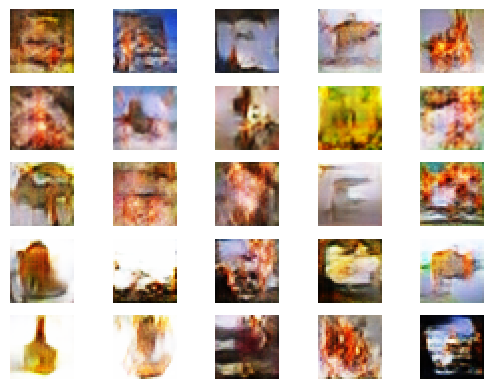

2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 1/390, d1=0.706, d2=0.662 g=0.730
2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 2/390, d1=0.665, d2=0.682 g=0.743
2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 3/390, d1=0.706, d2=0.664 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 4/390, d1=0.710, d2=0.681 g=0.723
2/2 [==============================] - 0s 8ms/step
Epoch>28, Batch 5/390, d1=0.697, d2=0.684 g=0.716
2/2 [==============================] - 0s 8ms/step
Epoch>28, Batch 6/390, d1=0.697, d2=0.704 g=0.709
2/2 [==============================] - 0s 10ms/step
Epoch>28, Batch 7/390, d1=0.674, d2=0.685 g=0.722
2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 8/390, d1=0.698, d2=0.681 g=0.716
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 9/390, d1=0.714, d2=0.676 g=0.719
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 10/390, d1=0.698, d2=0.

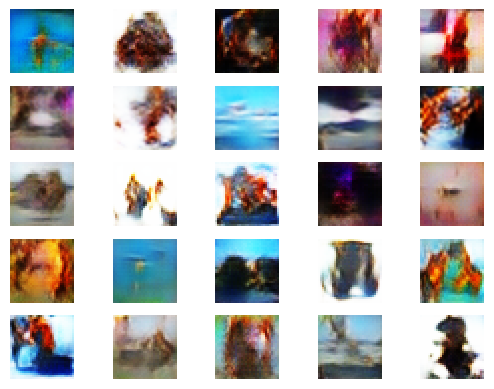

2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 1/390, d1=0.682, d2=0.673 g=0.745
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 2/390, d1=0.710, d2=0.666 g=0.765
2/2 [==============================] - 0s 6ms/step
Epoch>29, Batch 3/390, d1=0.721, d2=0.648 g=0.746
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 4/390, d1=0.720, d2=0.646 g=0.752
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 5/390, d1=0.726, d2=0.660 g=0.740
2/2 [==============================] - 0s 6ms/step
Epoch>29, Batch 6/390, d1=0.706, d2=0.655 g=0.742
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 7/390, d1=0.723, d2=0.668 g=0.721
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 8/390, d1=0.691, d2=0.688 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>29, Batch 9/390, d1=0.719, d2=0.657 g=0.725
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 10/390, d1=0.709, d2=0.6

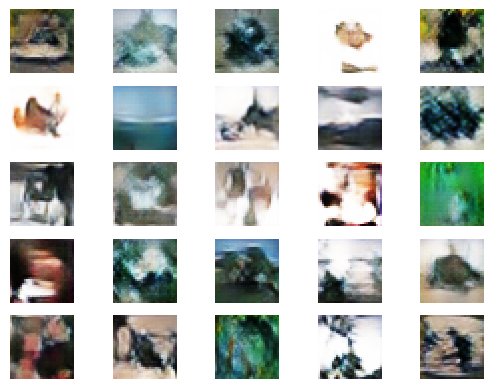

2/2 [==============================] - 0s 4ms/step
Epoch>30, Batch 1/390, d1=0.733, d2=0.689 g=0.738
2/2 [==============================] - 0s 5ms/step
Epoch>30, Batch 2/390, d1=0.742, d2=0.668 g=0.733
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 3/390, d1=0.707, d2=0.662 g=0.732
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 4/390, d1=0.722, d2=0.659 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 5/390, d1=0.703, d2=0.660 g=0.720
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 6/390, d1=0.700, d2=0.667 g=0.731
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 7/390, d1=0.680, d2=0.699 g=0.723
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 8/390, d1=0.666, d2=0.678 g=0.689
2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 9/390, d1=0.685, d2=0.688 g=0.708
2/2 [==============================] - 0s 11ms/step
Epoch>30, Batch 10/390, d1=0.657, d2=0.

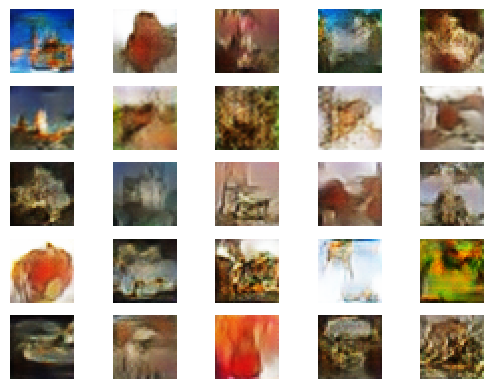

2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 1/390, d1=0.693, d2=0.691 g=0.727
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 2/390, d1=0.674, d2=0.687 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 3/390, d1=0.690, d2=0.703 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 4/390, d1=0.686, d2=0.698 g=0.723
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 5/390, d1=0.702, d2=0.671 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 6/390, d1=0.666, d2=0.712 g=0.725
2/2 [==============================] - 0s 5ms/step
Epoch>31, Batch 7/390, d1=0.678, d2=0.678 g=0.730
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 8/390, d1=0.693, d2=0.680 g=0.717
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 9/390, d1=0.678, d2=0.697 g=0.711
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 10/390, d1=0.709, d2=0.6

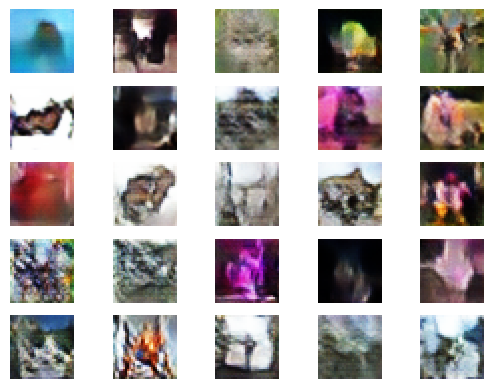

2/2 [==============================] - 0s 5ms/step
Epoch>32, Batch 1/390, d1=0.691, d2=0.683 g=0.737
2/2 [==============================] - 0s 5ms/step
Epoch>32, Batch 2/390, d1=0.698, d2=0.664 g=0.733
2/2 [==============================] - 0s 4ms/step
Epoch>32, Batch 3/390, d1=0.693, d2=0.685 g=0.735
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 4/390, d1=0.693, d2=0.673 g=0.730
2/2 [==============================] - 0s 5ms/step
Epoch>32, Batch 5/390, d1=0.710, d2=0.660 g=0.724
2/2 [==============================] - 0s 9ms/step
Epoch>32, Batch 6/390, d1=0.708, d2=0.673 g=0.725
2/2 [==============================] - 0s 5ms/step
Epoch>32, Batch 7/390, d1=0.693, d2=0.691 g=0.720
2/2 [==============================] - 0s 5ms/step
Epoch>32, Batch 8/390, d1=0.718, d2=0.687 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 9/390, d1=0.704, d2=0.669 g=0.735
2/2 [==============================] - 0s 5ms/step
Epoch>32, Batch 10/390, d1=0.710, d2=0.6

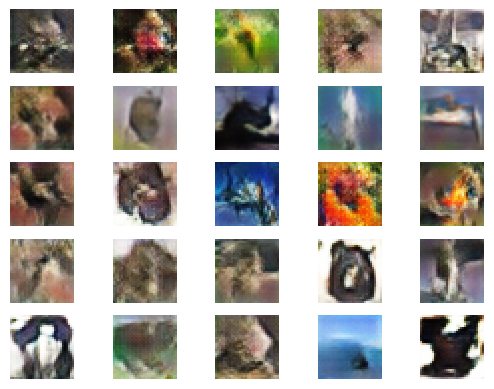

2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 1/390, d1=0.708, d2=0.682 g=0.719
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 2/390, d1=0.674, d2=0.706 g=0.709
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 3/390, d1=0.695, d2=0.707 g=0.720
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 4/390, d1=0.692, d2=0.670 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>33, Batch 5/390, d1=0.687, d2=0.681 g=0.717
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 6/390, d1=0.695, d2=0.677 g=0.711
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 7/390, d1=0.689, d2=0.695 g=0.718
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 8/390, d1=0.692, d2=0.675 g=0.731
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 9/390, d1=0.687, d2=0.676 g=0.720
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 10/390, d1=0.691, d2=0.6

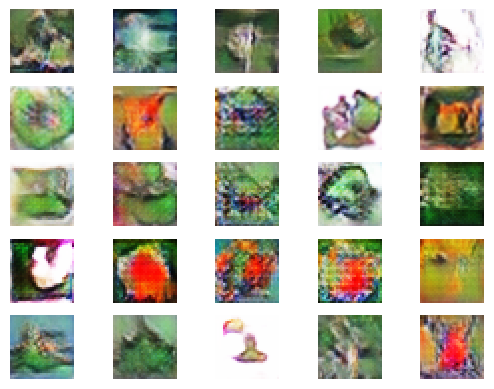

2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 1/390, d1=0.691, d2=0.673 g=0.742
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 2/390, d1=0.707, d2=0.644 g=0.746
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 3/390, d1=0.700, d2=0.664 g=0.744
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 4/390, d1=0.691, d2=0.654 g=0.735
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 5/390, d1=0.682, d2=0.685 g=0.722
2/2 [==============================] - 0s 5ms/step
Epoch>34, Batch 6/390, d1=0.689, d2=0.693 g=0.727
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 7/390, d1=0.678, d2=0.685 g=0.719
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 8/390, d1=0.649, d2=0.678 g=0.705
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 9/390, d1=0.672, d2=0.687 g=0.708
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 10/390, d1=0.664, d2=0.7

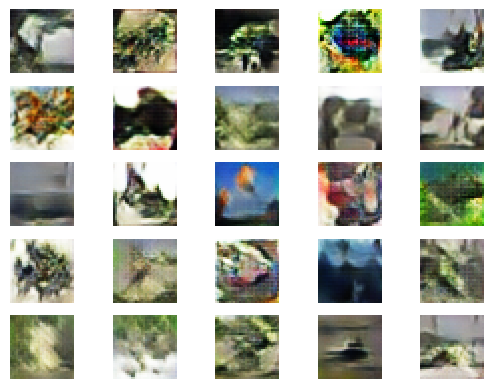

2/2 [==============================] - 0s 8ms/step
Epoch>35, Batch 1/390, d1=0.673, d2=0.715 g=0.728
2/2 [==============================] - 0s 8ms/step
Epoch>35, Batch 2/390, d1=0.703, d2=0.681 g=0.741
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 3/390, d1=0.715, d2=0.690 g=0.736
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 4/390, d1=0.703, d2=0.700 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 5/390, d1=0.710, d2=0.664 g=0.733
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 6/390, d1=0.720, d2=0.682 g=0.720
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 7/390, d1=0.701, d2=0.663 g=0.722
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 8/390, d1=0.699, d2=0.672 g=0.723
2/2 [==============================] - 0s 8ms/step
Epoch>35, Batch 9/390, d1=0.702, d2=0.680 g=0.716
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 10/390, d1=0.695, d2=0.6

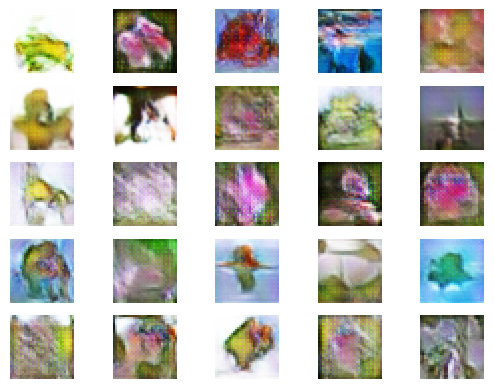

2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 1/390, d1=0.707, d2=0.686 g=0.699
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 2/390, d1=0.701, d2=0.696 g=0.704
2/2 [==============================] - 0s 4ms/step
Epoch>36, Batch 3/390, d1=0.711, d2=0.686 g=0.707
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 4/390, d1=0.705, d2=0.685 g=0.713
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 5/390, d1=0.701, d2=0.682 g=0.709
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 6/390, d1=0.701, d2=0.685 g=0.709
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 7/390, d1=0.689, d2=0.684 g=0.701
2/2 [==============================] - 0s 9ms/step
Epoch>36, Batch 8/390, d1=0.703, d2=0.691 g=0.704
2/2 [==============================] - 0s 10ms/step
Epoch>36, Batch 9/390, d1=0.698, d2=0.688 g=0.702
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 10/390, d1=0.696, d2=0.

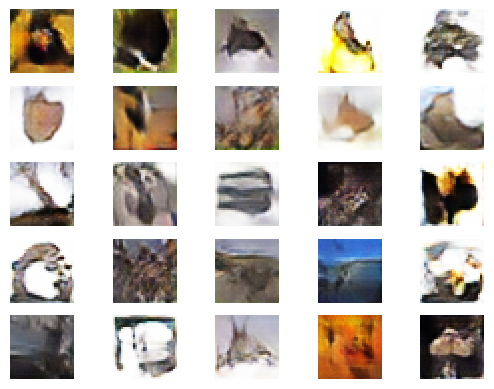

2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 1/390, d1=0.679, d2=0.683 g=0.709
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 2/390, d1=0.707, d2=0.676 g=0.716
2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 3/390, d1=0.699, d2=0.680 g=0.710
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 4/390, d1=0.689, d2=0.676 g=0.715
2/2 [==============================] - 0s 8ms/step
Epoch>37, Batch 5/390, d1=0.697, d2=0.687 g=0.700
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 6/390, d1=0.677, d2=0.685 g=0.712
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 7/390, d1=0.682, d2=0.693 g=0.711
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 8/390, d1=0.682, d2=0.683 g=0.716
2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 9/390, d1=0.699, d2=0.675 g=0.714
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 10/390, d1=0.702, d2=0.6

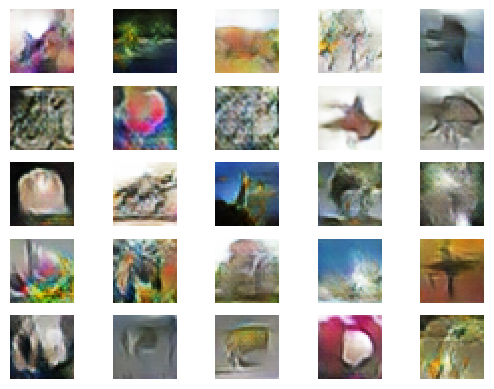

2/2 [==============================] - 0s 7ms/step
Epoch>38, Batch 1/390, d1=0.666, d2=0.705 g=0.718
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 2/390, d1=0.670, d2=0.688 g=0.713
2/2 [==============================] - 0s 7ms/step
Epoch>38, Batch 3/390, d1=0.657, d2=0.710 g=0.712
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 4/390, d1=0.689, d2=0.687 g=0.705
2/2 [==============================] - 0s 7ms/step
Epoch>38, Batch 5/390, d1=0.688, d2=0.679 g=0.712
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 6/390, d1=0.685, d2=0.712 g=0.720
2/2 [==============================] - 0s 5ms/step
Epoch>38, Batch 7/390, d1=0.705, d2=0.670 g=0.725
2/2 [==============================] - 0s 8ms/step
Epoch>38, Batch 8/390, d1=0.692, d2=0.681 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 9/390, d1=0.685, d2=0.658 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 10/390, d1=0.703, d2=0.6

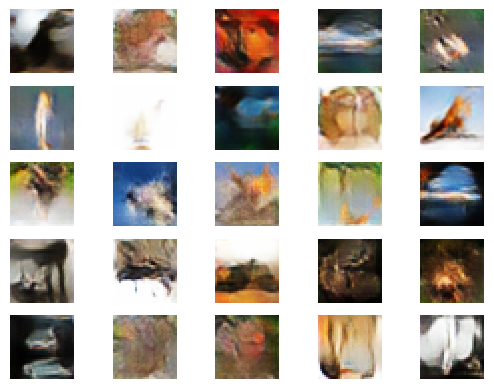

2/2 [==============================] - 0s 8ms/step
Epoch>39, Batch 1/390, d1=0.685, d2=0.684 g=0.704
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 2/390, d1=0.687, d2=0.682 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 3/390, d1=0.683, d2=0.721 g=0.712
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 4/390, d1=0.689, d2=0.687 g=0.727
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 5/390, d1=0.699, d2=0.677 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 6/390, d1=0.715, d2=0.667 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 7/390, d1=0.709, d2=0.714 g=0.747
2/2 [==============================] - 0s 5ms/step
Epoch>39, Batch 8/390, d1=0.709, d2=0.663 g=0.740
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 9/390, d1=0.716, d2=0.682 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 10/390, d1=0.714, d2=0.6

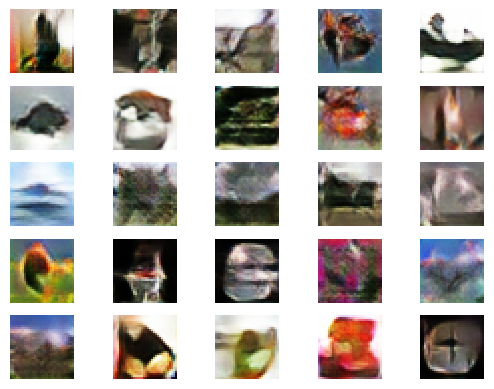

2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 1/390, d1=0.684, d2=0.710 g=0.715
2/2 [==============================] - 0s 10ms/step
Epoch>40, Batch 2/390, d1=0.693, d2=0.693 g=0.723
2/2 [==============================] - 0s 8ms/step
Epoch>40, Batch 3/390, d1=0.702, d2=0.674 g=0.727
2/2 [==============================] - 0s 8ms/step
Epoch>40, Batch 4/390, d1=0.682, d2=0.679 g=0.721
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 5/390, d1=0.684, d2=0.683 g=0.710
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 6/390, d1=0.683, d2=0.695 g=0.716
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 7/390, d1=0.705, d2=0.703 g=0.727
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 8/390, d1=0.703, d2=0.667 g=0.725
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 9/390, d1=0.696, d2=0.670 g=0.731
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 10/390, d1=0.703, d2=0.

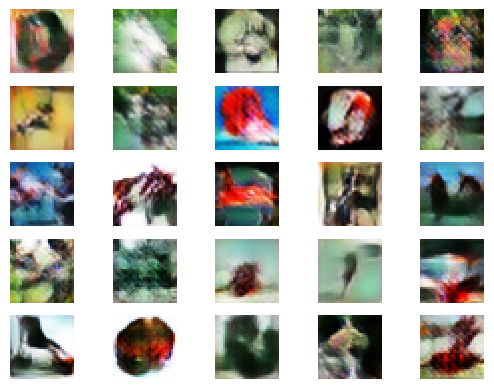

2/2 [==============================] - 0s 7ms/step
Epoch>41, Batch 1/390, d1=0.680, d2=0.694 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 2/390, d1=0.683, d2=0.670 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 3/390, d1=0.701, d2=0.711 g=0.720
2/2 [==============================] - 0s 8ms/step
Epoch>41, Batch 4/390, d1=0.694, d2=0.684 g=0.725
2/2 [==============================] - 0s 8ms/step
Epoch>41, Batch 5/390, d1=0.678, d2=0.663 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 6/390, d1=0.681, d2=0.679 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 7/390, d1=0.679, d2=0.694 g=0.719
2/2 [==============================] - 0s 9ms/step
Epoch>41, Batch 8/390, d1=0.670, d2=0.702 g=0.719
2/2 [==============================] - 0s 9ms/step
Epoch>41, Batch 9/390, d1=0.683, d2=0.684 g=0.715
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 10/390, d1=0.703, d2=0.7

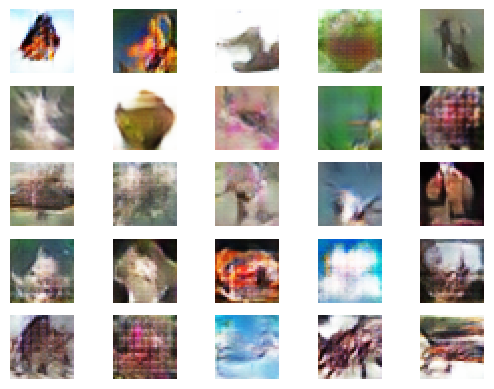

2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 1/390, d1=0.697, d2=0.685 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 2/390, d1=0.653, d2=0.684 g=0.716
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 3/390, d1=0.681, d2=0.686 g=0.706
2/2 [==============================] - 0s 8ms/step
Epoch>42, Batch 4/390, d1=0.683, d2=0.684 g=0.714
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 5/390, d1=0.691, d2=0.681 g=0.706
2/2 [==============================] - 0s 5ms/step
Epoch>42, Batch 6/390, d1=0.689, d2=0.738 g=0.715
2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 7/390, d1=0.692, d2=0.673 g=0.718
2/2 [==============================] - 0s 8ms/step
Epoch>42, Batch 8/390, d1=0.696, d2=0.668 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 9/390, d1=0.712, d2=0.676 g=0.735
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 10/390, d1=0.702, d2=0.6

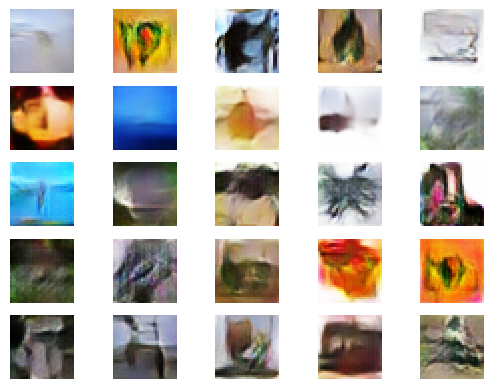

2/2 [==============================] - 0s 9ms/step
Epoch>43, Batch 1/390, d1=0.703, d2=0.672 g=0.718
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 2/390, d1=0.689, d2=0.686 g=0.707
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 3/390, d1=0.706, d2=0.691 g=0.718
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 4/390, d1=0.680, d2=0.667 g=0.715
2/2 [==============================] - 0s 8ms/step
Epoch>43, Batch 5/390, d1=0.690, d2=0.680 g=0.709
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 6/390, d1=0.701, d2=0.687 g=0.716
2/2 [==============================] - 0s 8ms/step
Epoch>43, Batch 7/390, d1=0.699, d2=0.681 g=0.714
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 8/390, d1=0.693, d2=0.669 g=0.733
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 9/390, d1=0.701, d2=0.688 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 10/390, d1=0.688, d2=0.6

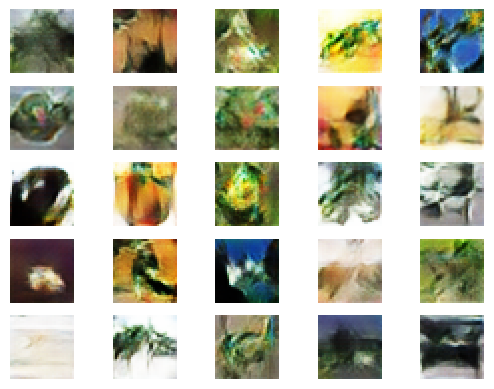

2/2 [==============================] - 0s 8ms/step
Epoch>44, Batch 1/390, d1=0.684, d2=0.706 g=0.730
2/2 [==============================] - 0s 4ms/step
Epoch>44, Batch 2/390, d1=0.713, d2=0.684 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 3/390, d1=0.695, d2=0.670 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 4/390, d1=0.696, d2=0.678 g=0.707
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 5/390, d1=0.678, d2=0.683 g=0.710
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 6/390, d1=0.655, d2=0.758 g=0.709
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 7/390, d1=0.669, d2=0.706 g=0.719
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 8/390, d1=0.690, d2=0.700 g=0.712
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 9/390, d1=0.685, d2=0.707 g=0.714
2/2 [==============================] - 0s 10ms/step
Epoch>44, Batch 10/390, d1=0.697, d2=0.

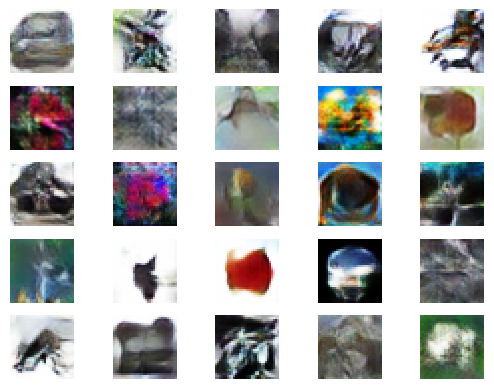

2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 1/390, d1=0.669, d2=0.685 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 2/390, d1=0.688, d2=0.663 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 3/390, d1=0.711, d2=0.671 g=0.718
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 4/390, d1=0.675, d2=0.684 g=0.736
2/2 [==============================] - 0s 5ms/step
Epoch>45, Batch 5/390, d1=0.702, d2=0.663 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 6/390, d1=0.714, d2=0.672 g=0.722
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 7/390, d1=0.693, d2=0.667 g=0.721
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 8/390, d1=0.676, d2=0.679 g=0.708
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 9/390, d1=0.675, d2=0.708 g=0.703
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 10/390, d1=0.674, d2=0.6

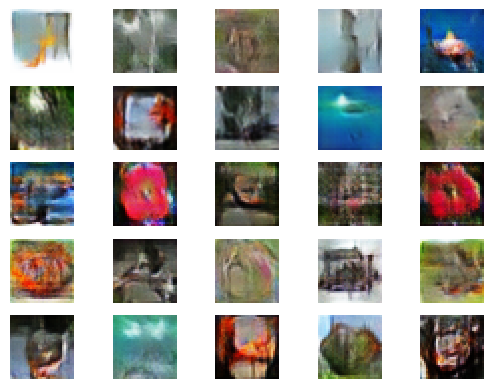

2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 1/390, d1=0.721, d2=0.684 g=0.731
2/2 [==============================] - 0s 8ms/step
Epoch>46, Batch 2/390, d1=0.705, d2=0.673 g=0.735
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 3/390, d1=0.715, d2=0.653 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 4/390, d1=0.700, d2=0.653 g=0.727
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 5/390, d1=0.704, d2=0.669 g=0.724
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 6/390, d1=0.700, d2=0.665 g=0.729
2/2 [==============================] - 0s 8ms/step
Epoch>46, Batch 7/390, d1=0.681, d2=0.676 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 8/390, d1=0.717, d2=0.683 g=0.718
2/2 [==============================] - 0s 8ms/step
Epoch>46, Batch 9/390, d1=0.712, d2=0.688 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 10/390, d1=0.727, d2=0.6

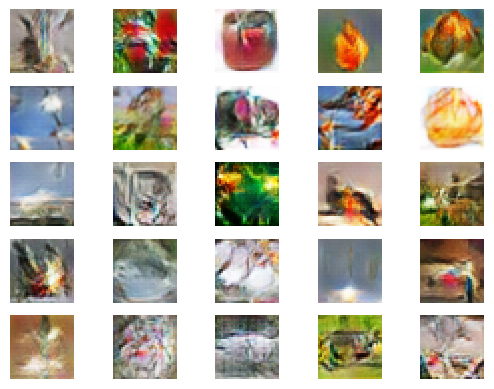

2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 1/390, d1=0.665, d2=0.665 g=0.712
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 2/390, d1=0.636, d2=0.691 g=0.704
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 3/390, d1=0.672, d2=0.692 g=0.719
2/2 [==============================] - 0s 8ms/step
Epoch>47, Batch 4/390, d1=0.669, d2=0.701 g=0.701
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 5/390, d1=0.696, d2=0.722 g=0.711
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 6/390, d1=0.693, d2=0.683 g=0.720
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 7/390, d1=0.682, d2=0.698 g=0.742
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 8/390, d1=0.671, d2=0.683 g=0.727
2/2 [==============================] - 0s 5ms/step
Epoch>47, Batch 9/390, d1=0.702, d2=0.660 g=0.718
2/2 [==============================] - 0s 8ms/step
Epoch>47, Batch 10/390, d1=0.672, d2=0.6

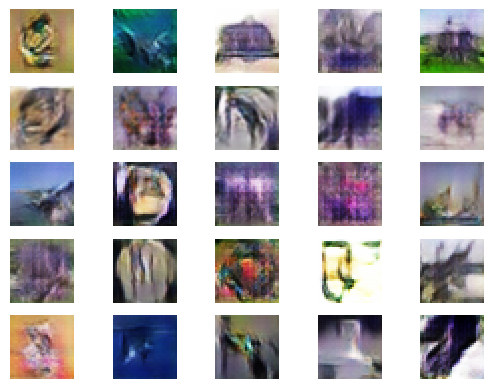

2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 1/390, d1=0.677, d2=0.776 g=0.729
2/2 [==============================] - 0s 5ms/step
Epoch>48, Batch 2/390, d1=0.661, d2=0.684 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 3/390, d1=0.666, d2=0.687 g=0.707
2/2 [==============================] - 0s 5ms/step
Epoch>48, Batch 4/390, d1=0.657, d2=0.712 g=0.707
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 5/390, d1=0.684, d2=0.701 g=0.697
2/2 [==============================] - 0s 5ms/step
Epoch>48, Batch 6/390, d1=0.654, d2=0.703 g=0.690
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 7/390, d1=0.653, d2=0.741 g=0.719
2/2 [==============================] - 0s 5ms/step
Epoch>48, Batch 8/390, d1=0.700, d2=0.687 g=0.715
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 9/390, d1=0.691, d2=0.668 g=0.720
2/2 [==============================] - 0s 7ms/step
Epoch>48, Batch 10/390, d1=0.672, d2=0.6

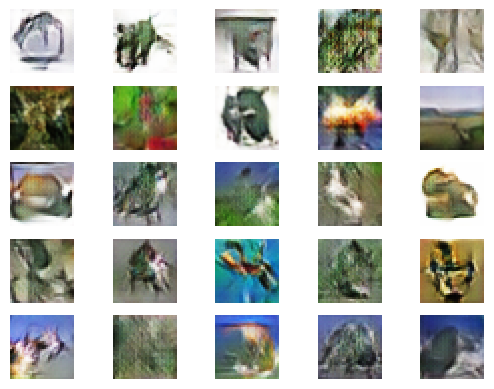

2/2 [==============================] - 0s 11ms/step
Epoch>49, Batch 1/390, d1=0.683, d2=0.675 g=0.720
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 2/390, d1=0.698, d2=0.680 g=0.719
2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 3/390, d1=0.685, d2=0.696 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>49, Batch 4/390, d1=0.672, d2=0.651 g=0.726
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 5/390, d1=0.666, d2=0.674 g=0.746
2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 6/390, d1=0.708, d2=0.690 g=0.724
2/2 [==============================] - 0s 5ms/step
Epoch>49, Batch 7/390, d1=0.670, d2=0.671 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 8/390, d1=0.667, d2=0.712 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>49, Batch 9/390, d1=0.695, d2=0.685 g=0.724
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 10/390, d1=0.698, d2=0.

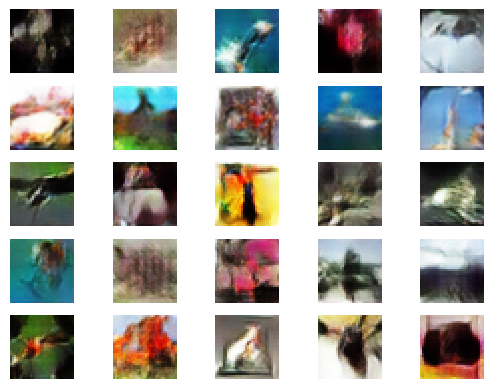

2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 1/390, d1=0.658, d2=0.742 g=0.710
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 2/390, d1=0.692, d2=0.681 g=0.719
2/2 [==============================] - 0s 8ms/step
Epoch>50, Batch 3/390, d1=0.697, d2=0.700 g=0.735
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 4/390, d1=0.694, d2=0.665 g=0.739
2/2 [==============================] - 0s 5ms/step
Epoch>50, Batch 5/390, d1=0.700, d2=0.691 g=0.726
2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 6/390, d1=0.700, d2=0.680 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 7/390, d1=0.703, d2=0.673 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 8/390, d1=0.682, d2=0.673 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 9/390, d1=0.697, d2=0.676 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 10/390, d1=0.689, d2=0.6

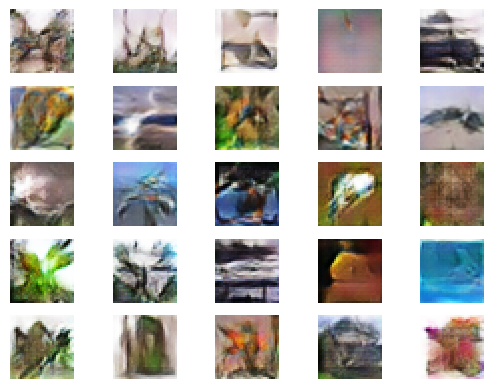

2/2 [==============================] - 0s 7ms/step
Epoch>51, Batch 1/390, d1=0.687, d2=0.740 g=0.731
2/2 [==============================] - 0s 8ms/step
Epoch>51, Batch 2/390, d1=0.680, d2=0.670 g=0.744
2/2 [==============================] - 0s 6ms/step
Epoch>51, Batch 3/390, d1=0.709, d2=0.657 g=0.743
2/2 [==============================] - 0s 6ms/step
Epoch>51, Batch 4/390, d1=0.692, d2=0.659 g=0.736
2/2 [==============================] - 0s 6ms/step
Epoch>51, Batch 5/390, d1=0.707, d2=0.664 g=0.739
2/2 [==============================] - 0s 6ms/step
Epoch>51, Batch 6/390, d1=0.704, d2=0.651 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>51, Batch 7/390, d1=0.668, d2=0.687 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>51, Batch 8/390, d1=0.694, d2=0.694 g=0.734
2/2 [==============================] - 0s 7ms/step
Epoch>51, Batch 9/390, d1=0.697, d2=0.647 g=0.742
2/2 [==============================] - 0s 7ms/step
Epoch>51, Batch 10/390, d1=0.692, d2=0.6

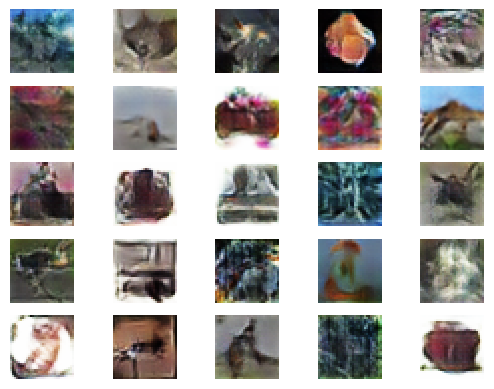

2/2 [==============================] - 0s 5ms/step
Epoch>52, Batch 1/390, d1=0.715, d2=0.678 g=0.732
2/2 [==============================] - 0s 8ms/step
Epoch>52, Batch 2/390, d1=0.714, d2=0.654 g=0.724
2/2 [==============================] - 0s 5ms/step
Epoch>52, Batch 3/390, d1=0.684, d2=0.669 g=0.733
2/2 [==============================] - 0s 5ms/step
Epoch>52, Batch 4/390, d1=0.694, d2=0.680 g=0.728
2/2 [==============================] - 0s 5ms/step
Epoch>52, Batch 5/390, d1=0.700, d2=0.709 g=0.730
2/2 [==============================] - 0s 8ms/step
Epoch>52, Batch 6/390, d1=0.698, d2=0.671 g=0.748
2/2 [==============================] - 0s 7ms/step
Epoch>52, Batch 7/390, d1=0.703, d2=0.659 g=0.729
2/2 [==============================] - 0s 5ms/step
Epoch>52, Batch 8/390, d1=0.706, d2=0.667 g=0.730
2/2 [==============================] - 0s 4ms/step
Epoch>52, Batch 9/390, d1=0.685, d2=0.670 g=0.743
2/2 [==============================] - 0s 10ms/step
Epoch>52, Batch 10/390, d1=0.698, d2=0.

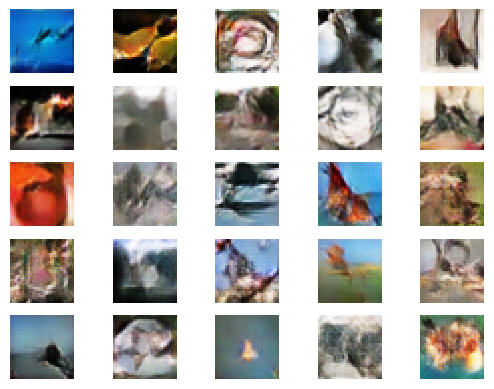

2/2 [==============================] - 0s 7ms/step
Epoch>53, Batch 1/390, d1=0.670, d2=0.724 g=0.745
2/2 [==============================] - 0s 8ms/step
Epoch>53, Batch 2/390, d1=0.717, d2=0.651 g=0.742
2/2 [==============================] - 0s 6ms/step
Epoch>53, Batch 3/390, d1=0.726, d2=0.655 g=0.736
2/2 [==============================] - 0s 6ms/step
Epoch>53, Batch 4/390, d1=0.720, d2=0.669 g=0.734
2/2 [==============================] - 0s 6ms/step
Epoch>53, Batch 5/390, d1=0.706, d2=0.671 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>53, Batch 6/390, d1=0.696, d2=0.653 g=0.730
2/2 [==============================] - 0s 6ms/step
Epoch>53, Batch 7/390, d1=0.691, d2=0.669 g=0.735
2/2 [==============================] - 0s 9ms/step
Epoch>53, Batch 8/390, d1=0.674, d2=0.686 g=0.727
2/2 [==============================] - 0s 11ms/step
Epoch>53, Batch 9/390, d1=0.659, d2=0.726 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>53, Batch 10/390, d1=0.707, d2=0.

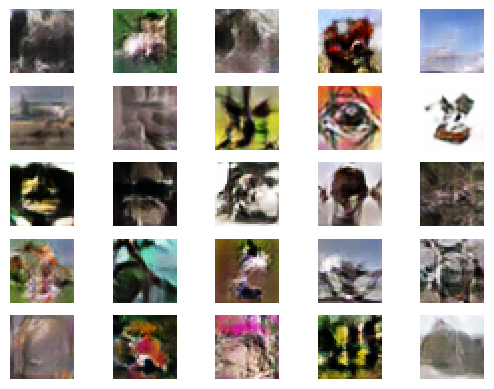

2/2 [==============================] - 0s 6ms/step
Epoch>54, Batch 1/390, d1=0.693, d2=0.678 g=0.717
2/2 [==============================] - 0s 4ms/step
Epoch>54, Batch 2/390, d1=0.698, d2=0.679 g=0.716
2/2 [==============================] - 0s 6ms/step
Epoch>54, Batch 3/390, d1=0.680, d2=0.682 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>54, Batch 4/390, d1=0.701, d2=0.667 g=0.722
2/2 [==============================] - 0s 6ms/step
Epoch>54, Batch 5/390, d1=0.693, d2=0.668 g=0.725
2/2 [==============================] - 0s 5ms/step
Epoch>54, Batch 6/390, d1=0.706, d2=0.694 g=0.720
2/2 [==============================] - 0s 7ms/step
Epoch>54, Batch 7/390, d1=0.712, d2=0.679 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>54, Batch 8/390, d1=0.701, d2=0.673 g=0.730
2/2 [==============================] - 0s 7ms/step
Epoch>54, Batch 9/390, d1=0.675, d2=0.674 g=0.724
2/2 [==============================] - 0s 7ms/step
Epoch>54, Batch 10/390, d1=0.692, d2=0.6

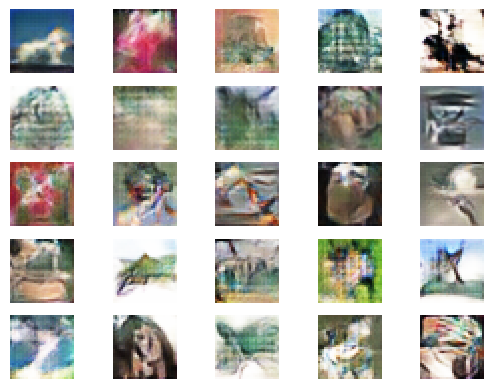

2/2 [==============================] - 0s 6ms/step
Epoch>55, Batch 1/390, d1=0.713, d2=0.657 g=0.741
2/2 [==============================] - 0s 11ms/step
Epoch>55, Batch 2/390, d1=0.688, d2=0.670 g=0.739
2/2 [==============================] - 0s 8ms/step
Epoch>55, Batch 3/390, d1=0.701, d2=0.663 g=0.743
2/2 [==============================] - 0s 7ms/step
Epoch>55, Batch 4/390, d1=0.677, d2=0.663 g=0.733
2/2 [==============================] - 0s 8ms/step
Epoch>55, Batch 5/390, d1=0.678, d2=0.662 g=0.734
2/2 [==============================] - 0s 6ms/step
Epoch>55, Batch 6/390, d1=0.674, d2=0.687 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>55, Batch 7/390, d1=0.699, d2=0.668 g=0.739
2/2 [==============================] - 0s 7ms/step
Epoch>55, Batch 8/390, d1=0.637, d2=0.691 g=0.724
2/2 [==============================] - 0s 7ms/step
Epoch>55, Batch 9/390, d1=0.542, d2=0.695 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>55, Batch 10/390, d1=0.662, d2=0.

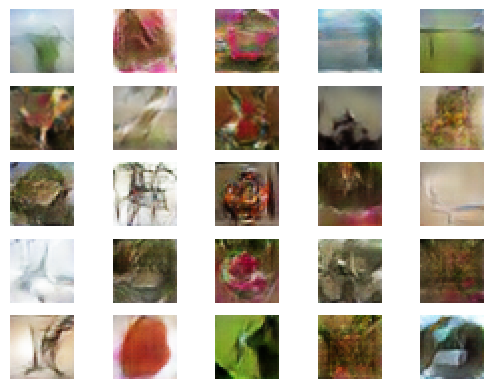

2/2 [==============================] - 0s 7ms/step
Epoch>56, Batch 1/390, d1=0.669, d2=0.699 g=0.723
2/2 [==============================] - 0s 7ms/step
Epoch>56, Batch 2/390, d1=0.649, d2=0.691 g=0.713
2/2 [==============================] - 0s 10ms/step
Epoch>56, Batch 3/390, d1=0.693, d2=0.681 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>56, Batch 4/390, d1=0.662, d2=0.676 g=0.705
2/2 [==============================] - 0s 7ms/step
Epoch>56, Batch 5/390, d1=0.684, d2=0.703 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>56, Batch 6/390, d1=0.677, d2=0.690 g=0.717
2/2 [==============================] - 0s 6ms/step
Epoch>56, Batch 7/390, d1=0.668, d2=0.681 g=0.719
2/2 [==============================] - 0s 6ms/step
Epoch>56, Batch 8/390, d1=0.683, d2=0.674 g=0.715
2/2 [==============================] - 0s 8ms/step
Epoch>56, Batch 9/390, d1=0.663, d2=0.666 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>56, Batch 10/390, d1=0.649, d2=0.

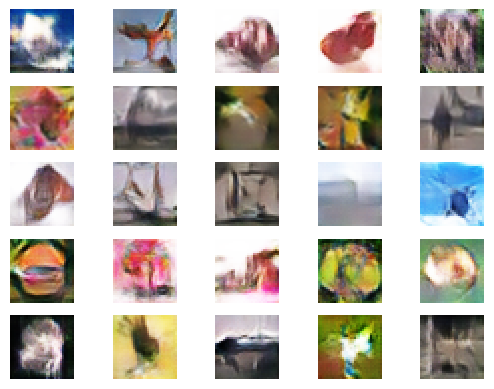

2/2 [==============================] - 0s 7ms/step
Epoch>57, Batch 1/390, d1=0.702, d2=0.685 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>57, Batch 2/390, d1=0.712, d2=0.664 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>57, Batch 3/390, d1=0.698, d2=0.662 g=0.731
2/2 [==============================] - 0s 5ms/step
Epoch>57, Batch 4/390, d1=0.706, d2=0.673 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>57, Batch 5/390, d1=0.693, d2=0.705 g=0.721
2/2 [==============================] - 0s 7ms/step
Epoch>57, Batch 6/390, d1=0.719, d2=0.665 g=0.729
2/2 [==============================] - 0s 8ms/step
Epoch>57, Batch 7/390, d1=0.694, d2=0.675 g=0.740
2/2 [==============================] - 0s 6ms/step
Epoch>57, Batch 8/390, d1=0.683, d2=0.671 g=0.731
2/2 [==============================] - 0s 5ms/step
Epoch>57, Batch 9/390, d1=0.696, d2=0.668 g=0.729
2/2 [==============================] - 0s 5ms/step
Epoch>57, Batch 10/390, d1=0.674, d2=0.6

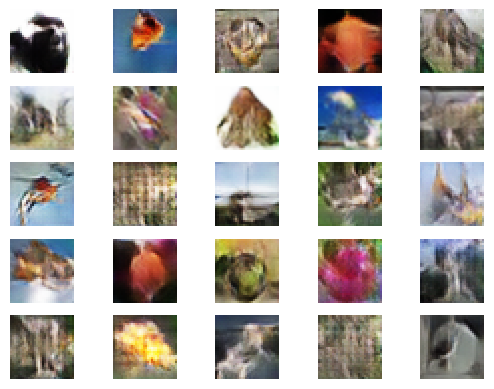

2/2 [==============================] - 0s 9ms/step
Epoch>58, Batch 1/390, d1=0.648, d2=0.701 g=0.720
2/2 [==============================] - 0s 7ms/step
Epoch>58, Batch 2/390, d1=0.671, d2=0.681 g=0.711
2/2 [==============================] - 0s 9ms/step
Epoch>58, Batch 3/390, d1=0.671, d2=0.691 g=0.722
2/2 [==============================] - 0s 6ms/step
Epoch>58, Batch 4/390, d1=0.726, d2=0.739 g=0.733
2/2 [==============================] - 0s 8ms/step
Epoch>58, Batch 5/390, d1=0.700, d2=0.697 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>58, Batch 6/390, d1=0.701, d2=0.663 g=0.720
2/2 [==============================] - 0s 7ms/step
Epoch>58, Batch 7/390, d1=0.700, d2=0.674 g=0.717
2/2 [==============================] - 0s 5ms/step
Epoch>58, Batch 8/390, d1=0.674, d2=0.669 g=0.723
2/2 [==============================] - 0s 5ms/step
Epoch>58, Batch 9/390, d1=0.686, d2=0.685 g=0.719
2/2 [==============================] - 0s 5ms/step
Epoch>58, Batch 10/390, d1=0.692, d2=0.6

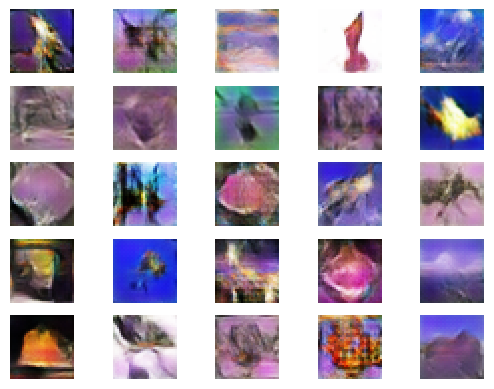

2/2 [==============================] - 0s 7ms/step
Epoch>59, Batch 1/390, d1=0.634, d2=0.696 g=0.726
2/2 [==============================] - 0s 7ms/step
Epoch>59, Batch 2/390, d1=0.604, d2=0.725 g=0.728
2/2 [==============================] - 0s 8ms/step
Epoch>59, Batch 3/390, d1=0.606, d2=0.689 g=0.681
2/2 [==============================] - 0s 7ms/step
Epoch>59, Batch 4/390, d1=0.627, d2=0.893 g=0.745
2/2 [==============================] - 0s 7ms/step
Epoch>59, Batch 5/390, d1=0.668, d2=0.649 g=0.749
2/2 [==============================] - 0s 5ms/step
Epoch>59, Batch 6/390, d1=0.701, d2=0.645 g=0.745
2/2 [==============================] - 0s 4ms/step
Epoch>59, Batch 7/390, d1=0.681, d2=0.666 g=0.726
2/2 [==============================] - 0s 6ms/step
Epoch>59, Batch 8/390, d1=0.675, d2=0.695 g=0.742
2/2 [==============================] - 0s 11ms/step
Epoch>59, Batch 9/390, d1=0.707, d2=0.694 g=0.739
2/2 [==============================] - 0s 6ms/step
Epoch>59, Batch 10/390, d1=0.705, d2=0.

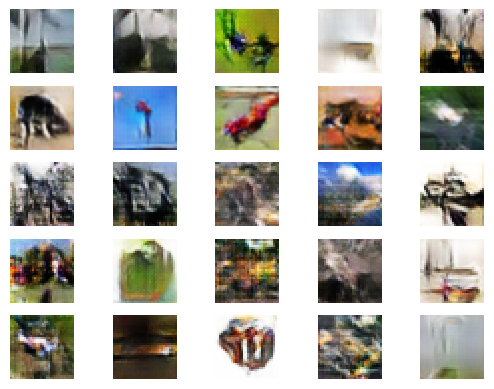

2/2 [==============================] - 0s 6ms/step
Epoch>60, Batch 1/390, d1=0.680, d2=0.690 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>60, Batch 2/390, d1=0.703, d2=0.647 g=0.728
2/2 [==============================] - 0s 5ms/step
Epoch>60, Batch 3/390, d1=0.675, d2=0.667 g=0.707
2/2 [==============================] - 0s 6ms/step
Epoch>60, Batch 4/390, d1=0.670, d2=0.677 g=0.703
2/2 [==============================] - 0s 6ms/step
Epoch>60, Batch 5/390, d1=0.663, d2=0.738 g=0.700
2/2 [==============================] - 0s 8ms/step
Epoch>60, Batch 6/390, d1=0.667, d2=0.715 g=0.719
2/2 [==============================] - 0s 6ms/step
Epoch>60, Batch 7/390, d1=0.662, d2=0.664 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>60, Batch 8/390, d1=0.710, d2=0.666 g=0.725
2/2 [==============================] - 0s 4ms/step
Epoch>60, Batch 9/390, d1=0.682, d2=0.692 g=0.739
2/2 [==============================] - 0s 7ms/step
Epoch>60, Batch 10/390, d1=0.715, d2=0.6

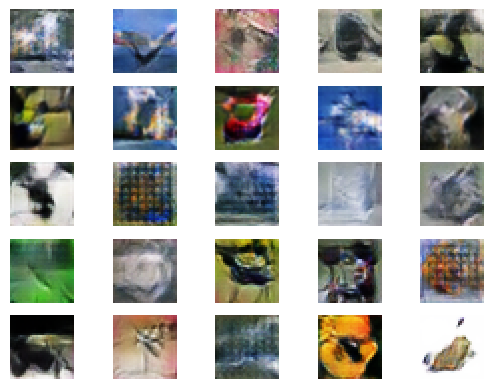

2/2 [==============================] - 0s 8ms/step
Epoch>61, Batch 1/390, d1=0.693, d2=0.649 g=0.732
2/2 [==============================] - 0s 6ms/step
Epoch>61, Batch 2/390, d1=0.697, d2=0.661 g=0.725
2/2 [==============================] - 0s 8ms/step
Epoch>61, Batch 3/390, d1=0.665, d2=0.703 g=0.716
2/2 [==============================] - 0s 8ms/step
Epoch>61, Batch 4/390, d1=0.678, d2=0.669 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>61, Batch 5/390, d1=0.700, d2=0.686 g=0.736
2/2 [==============================] - 0s 7ms/step
Epoch>61, Batch 6/390, d1=0.701, d2=0.671 g=0.739
2/2 [==============================] - 0s 6ms/step
Epoch>61, Batch 7/390, d1=0.660, d2=0.696 g=0.727
2/2 [==============================] - 0s 6ms/step
Epoch>61, Batch 8/390, d1=0.710, d2=0.671 g=0.727
2/2 [==============================] - 0s 9ms/step
Epoch>61, Batch 9/390, d1=0.648, d2=0.687 g=0.718
2/2 [==============================] - 0s 7ms/step
Epoch>61, Batch 10/390, d1=0.673, d2=0.6

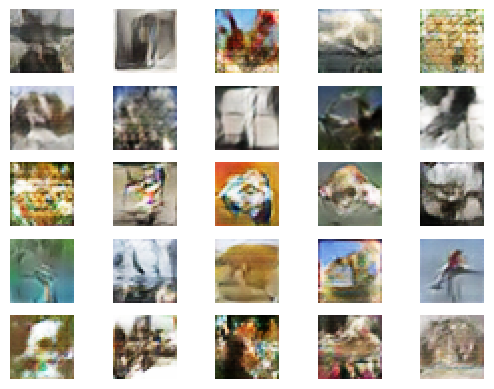

2/2 [==============================] - 0s 7ms/step
Epoch>62, Batch 1/390, d1=0.666, d2=0.705 g=0.711
2/2 [==============================] - 0s 6ms/step
Epoch>62, Batch 2/390, d1=0.626, d2=0.719 g=0.720
2/2 [==============================] - 0s 5ms/step
Epoch>62, Batch 3/390, d1=0.702, d2=0.709 g=0.719
2/2 [==============================] - 0s 7ms/step
Epoch>62, Batch 4/390, d1=0.689, d2=0.663 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>62, Batch 5/390, d1=0.664, d2=0.668 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>62, Batch 6/390, d1=0.680, d2=0.680 g=0.717
2/2 [==============================] - 0s 6ms/step
Epoch>62, Batch 7/390, d1=0.660, d2=0.773 g=0.716
2/2 [==============================] - 0s 8ms/step
Epoch>62, Batch 8/390, d1=0.695, d2=0.713 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>62, Batch 9/390, d1=0.699, d2=0.673 g=0.727
2/2 [==============================] - 0s 7ms/step
Epoch>62, Batch 10/390, d1=0.694, d2=0.6

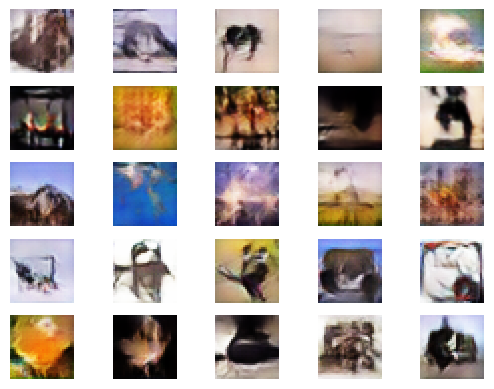

2/2 [==============================] - 0s 7ms/step
Epoch>63, Batch 1/390, d1=0.706, d2=0.678 g=0.738
2/2 [==============================] - 0s 9ms/step
Epoch>63, Batch 2/390, d1=0.710, d2=0.652 g=0.743
2/2 [==============================] - 0s 7ms/step
Epoch>63, Batch 3/390, d1=0.702, d2=0.653 g=0.745
2/2 [==============================] - 0s 8ms/step
Epoch>63, Batch 4/390, d1=0.702, d2=0.661 g=0.738
2/2 [==============================] - 0s 6ms/step
Epoch>63, Batch 5/390, d1=0.666, d2=0.674 g=0.731
2/2 [==============================] - 0s 6ms/step
Epoch>63, Batch 6/390, d1=0.673, d2=0.688 g=0.721
2/2 [==============================] - 0s 6ms/step
Epoch>63, Batch 7/390, d1=0.682, d2=0.793 g=0.741
2/2 [==============================] - 0s 7ms/step
Epoch>63, Batch 8/390, d1=0.721, d2=0.658 g=0.747
2/2 [==============================] - 0s 8ms/step
Epoch>63, Batch 9/390, d1=0.711, d2=0.677 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>63, Batch 10/390, d1=0.703, d2=0.6

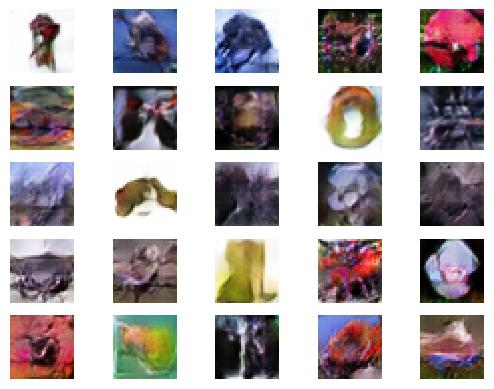

2/2 [==============================] - 0s 7ms/step
Epoch>64, Batch 1/390, d1=0.688, d2=0.685 g=0.735
2/2 [==============================] - 0s 7ms/step
Epoch>64, Batch 2/390, d1=0.689, d2=0.672 g=0.733
2/2 [==============================] - 0s 8ms/step
Epoch>64, Batch 3/390, d1=0.696, d2=0.675 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>64, Batch 4/390, d1=0.685, d2=0.667 g=0.727
2/2 [==============================] - 0s 6ms/step
Epoch>64, Batch 5/390, d1=0.712, d2=0.673 g=0.724
2/2 [==============================] - 0s 7ms/step
Epoch>64, Batch 6/390, d1=0.664, d2=0.705 g=0.719
2/2 [==============================] - 0s 7ms/step
Epoch>64, Batch 7/390, d1=0.655, d2=0.673 g=0.715
2/2 [==============================] - 0s 6ms/step
Epoch>64, Batch 8/390, d1=0.690, d2=0.705 g=0.718
2/2 [==============================] - 0s 8ms/step
Epoch>64, Batch 9/390, d1=0.664, d2=0.671 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>64, Batch 10/390, d1=0.698, d2=0.6

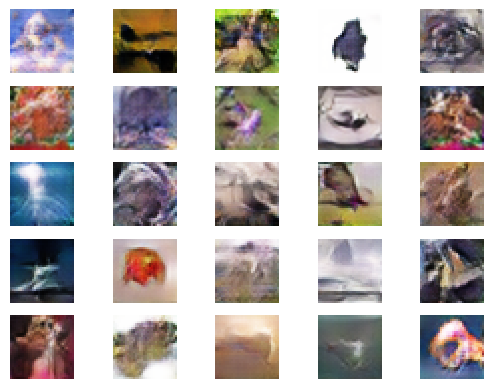

2/2 [==============================] - 0s 8ms/step
Epoch>65, Batch 1/390, d1=0.663, d2=0.678 g=0.724
2/2 [==============================] - 0s 7ms/step
Epoch>65, Batch 2/390, d1=0.659, d2=0.677 g=0.710
2/2 [==============================] - 0s 7ms/step
Epoch>65, Batch 3/390, d1=0.680, d2=0.691 g=0.726
2/2 [==============================] - 0s 7ms/step
Epoch>65, Batch 4/390, d1=0.680, d2=0.659 g=0.729
2/2 [==============================] - 0s 8ms/step
Epoch>65, Batch 5/390, d1=0.683, d2=0.696 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>65, Batch 6/390, d1=0.676, d2=0.673 g=0.726
2/2 [==============================] - 0s 10ms/step
Epoch>65, Batch 7/390, d1=0.709, d2=0.676 g=0.735
2/2 [==============================] - 0s 6ms/step
Epoch>65, Batch 8/390, d1=0.677, d2=0.664 g=0.731
2/2 [==============================] - 0s 7ms/step
Epoch>65, Batch 9/390, d1=0.671, d2=0.685 g=0.733
2/2 [==============================] - 0s 5ms/step
Epoch>65, Batch 10/390, d1=0.696, d2=0.

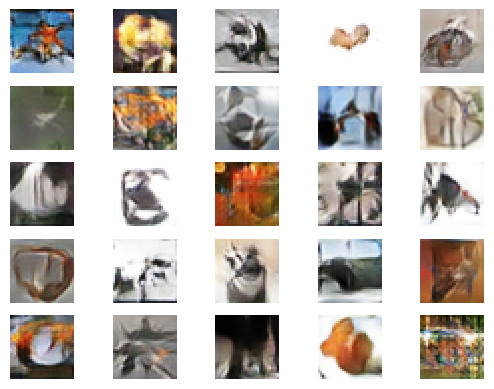

2/2 [==============================] - 0s 4ms/step
Epoch>66, Batch 1/390, d1=0.691, d2=0.662 g=0.723
2/2 [==============================] - 0s 9ms/step
Epoch>66, Batch 2/390, d1=0.670, d2=0.678 g=0.724
2/2 [==============================] - 0s 6ms/step
Epoch>66, Batch 3/390, d1=0.696, d2=0.674 g=0.717
2/2 [==============================] - 0s 7ms/step
Epoch>66, Batch 4/390, d1=0.682, d2=0.709 g=0.736
2/2 [==============================] - 0s 6ms/step
Epoch>66, Batch 5/390, d1=0.688, d2=0.666 g=0.736
2/2 [==============================] - 0s 6ms/step
Epoch>66, Batch 6/390, d1=0.670, d2=0.672 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>66, Batch 7/390, d1=0.700, d2=0.704 g=0.730
2/2 [==============================] - 0s 10ms/step
Epoch>66, Batch 8/390, d1=0.684, d2=0.683 g=0.731
2/2 [==============================] - 0s 7ms/step
Epoch>66, Batch 9/390, d1=0.664, d2=0.707 g=0.716
2/2 [==============================] - 0s 6ms/step
Epoch>66, Batch 10/390, d1=0.667, d2=0.

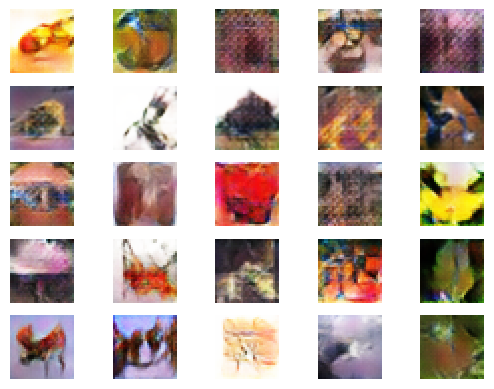

2/2 [==============================] - 0s 6ms/step
Epoch>67, Batch 1/390, d1=0.694, d2=0.689 g=0.731
2/2 [==============================] - 0s 6ms/step
Epoch>67, Batch 2/390, d1=0.680, d2=0.681 g=0.736
2/2 [==============================] - 0s 7ms/step
Epoch>67, Batch 3/390, d1=0.698, d2=0.676 g=0.742
2/2 [==============================] - 0s 6ms/step
Epoch>67, Batch 4/390, d1=0.713, d2=0.654 g=0.744
2/2 [==============================] - 0s 5ms/step
Epoch>67, Batch 5/390, d1=0.716, d2=0.646 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>67, Batch 6/390, d1=0.688, d2=0.657 g=0.728
2/2 [==============================] - 0s 8ms/step
Epoch>67, Batch 7/390, d1=0.673, d2=0.690 g=0.726
2/2 [==============================] - 0s 10ms/step
Epoch>67, Batch 8/390, d1=0.665, d2=0.696 g=0.734
2/2 [==============================] - 0s 8ms/step
Epoch>67, Batch 9/390, d1=0.700, d2=0.662 g=0.735
2/2 [==============================] - 0s 8ms/step
Epoch>67, Batch 10/390, d1=0.692, d2=0.

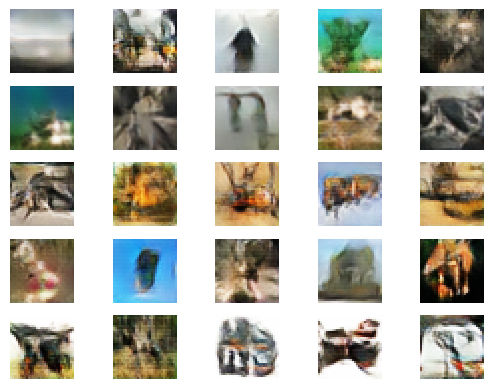

2/2 [==============================] - 0s 7ms/step
Epoch>68, Batch 1/390, d1=0.678, d2=0.668 g=0.714
2/2 [==============================] - 0s 8ms/step
Epoch>68, Batch 2/390, d1=0.696, d2=0.689 g=0.715
2/2 [==============================] - 0s 6ms/step
Epoch>68, Batch 3/390, d1=0.661, d2=0.677 g=0.707
2/2 [==============================] - 0s 7ms/step
Epoch>68, Batch 4/390, d1=0.681, d2=0.730 g=0.709
2/2 [==============================] - 0s 6ms/step
Epoch>68, Batch 5/390, d1=0.649, d2=0.718 g=0.733
2/2 [==============================] - 0s 6ms/step
Epoch>68, Batch 6/390, d1=0.668, d2=0.671 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>68, Batch 7/390, d1=0.710, d2=0.665 g=0.730
2/2 [==============================] - 0s 9ms/step
Epoch>68, Batch 8/390, d1=0.680, d2=0.675 g=0.730
2/2 [==============================] - 0s 5ms/step
Epoch>68, Batch 9/390, d1=0.686, d2=0.687 g=0.711
2/2 [==============================] - 0s 6ms/step
Epoch>68, Batch 10/390, d1=0.695, d2=0.6

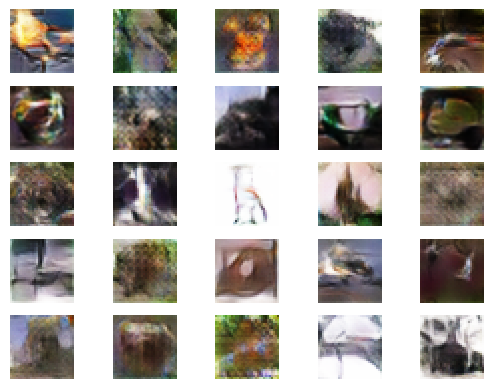

2/2 [==============================] - 0s 7ms/step
Epoch>69, Batch 1/390, d1=0.673, d2=0.676 g=0.725
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 2/390, d1=0.678, d2=0.677 g=0.728
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 3/390, d1=0.707, d2=0.682 g=0.729
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 4/390, d1=0.683, d2=0.665 g=0.737
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 5/390, d1=0.710, d2=0.648 g=0.738
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 6/390, d1=0.697, d2=0.657 g=0.735
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 7/390, d1=0.690, d2=0.666 g=0.728
2/2 [==============================] - 0s 5ms/step
Epoch>69, Batch 8/390, d1=0.691, d2=0.663 g=0.740
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 9/390, d1=0.686, d2=0.678 g=0.717
2/2 [==============================] - 0s 6ms/step
Epoch>69, Batch 10/390, d1=0.675, d2=0.7

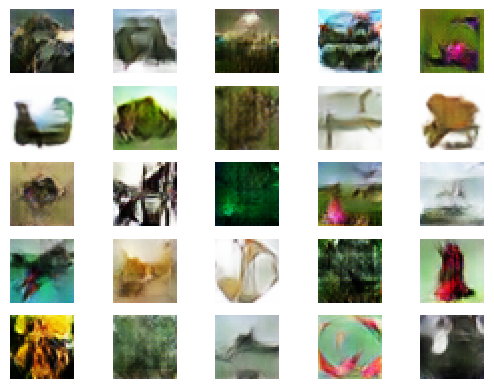

2/2 [==============================] - 0s 7ms/step
Epoch>70, Batch 1/390, d1=0.691, d2=0.672 g=0.728
2/2 [==============================] - 0s 7ms/step
Epoch>70, Batch 2/390, d1=0.662, d2=0.670 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>70, Batch 3/390, d1=0.649, d2=0.713 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>70, Batch 4/390, d1=0.661, d2=0.769 g=0.718
2/2 [==============================] - 0s 7ms/step
Epoch>70, Batch 5/390, d1=0.650, d2=0.705 g=0.720
2/2 [==============================] - 0s 6ms/step
Epoch>70, Batch 6/390, d1=0.634, d2=0.768 g=0.723
2/2 [==============================] - 0s 6ms/step
Epoch>70, Batch 7/390, d1=0.691, d2=0.660 g=0.726
2/2 [==============================] - 0s 7ms/step
Epoch>70, Batch 8/390, d1=0.686, d2=0.671 g=0.730
2/2 [==============================] - 0s 10ms/step
Epoch>70, Batch 9/390, d1=0.697, d2=0.666 g=0.731
2/2 [==============================] - 0s 11ms/step
Epoch>70, Batch 10/390, d1=0.703, d2=0

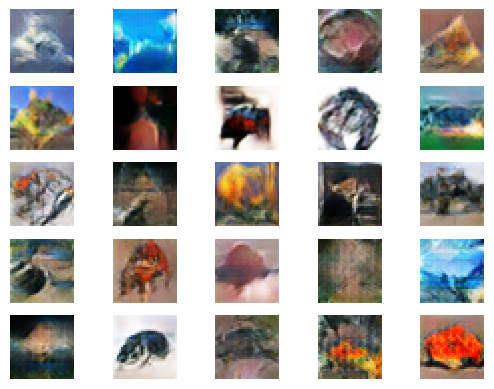

In [ ]:
#Train the GAN

# size of the latent space
latent_dim = 100

# create the discriminator
discriminator = define_discriminator()

# create the generator
generator = define_generator(latent_dim)

# create the gan
gan_model = define_gan(generator, discriminator)

# load image data
dataset = load_real_samples()

# train model
train(generator, discriminator, gan_model, dataset, latent_dim, n_epochs=70)




1/1 [==============================] - 1s 721ms/step


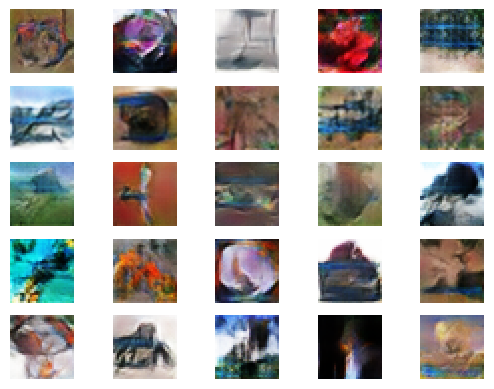

In [ ]:
from keras.models import load_model
from numpy.random import randn
import numpy as np
# load model
model = load_model('/content/drive/MyDrive/GAN/cifar_GAN.h5') #Model trained for 70 epochs
# generate images
latent_points = generate_latent_points(100, 25)  #Latent dim and n_samples
# generate images
X = model.predict(latent_points)
# scale from [-1,1] to [0,1]
X = (X + 1) / 2.0

import numpy as np
X = (X*255).astype(np.uint8)

# plot the result
show_plot(X, 5)

#Note: CIFAR10 classes are: airplane, automobile, bird, cat, deer, dog, frog, horse,
# ship, truck

2/2 [==============================] - 0s 9ms/step
Epoch>1, Batch 1/390, d1=0.682, d2=0.725 g=0.675
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 2/390, d1=0.672, d2=0.719 g=0.675
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 3/390, d1=0.672, d2=0.715 g=0.675
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 4/390, d1=0.673, d2=0.719 g=0.677
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 5/390, d1=0.677, d2=0.720 g=0.677
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 6/390, d1=0.677, d2=0.715 g=0.677
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 7/390, d1=0.683, d2=0.715 g=0.679
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 8/390, d1=0.684, d2=0.708 g=0.684
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 9/390, d1=0.685, d2=0.702 g=0.689
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 10/390, d1=0.685, d2=0.698 g=0.694

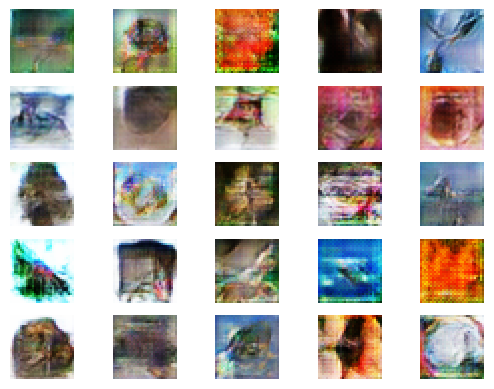

2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 1/390, d1=0.689, d2=0.698 g=0.691
2/2 [==============================] - 0s 8ms/step
Epoch>2, Batch 2/390, d1=0.692, d2=0.695 g=0.691
2/2 [==============================] - 0s 4ms/step
Epoch>2, Batch 3/390, d1=0.691, d2=0.699 g=0.690
2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 4/390, d1=0.689, d2=0.698 g=0.691
2/2 [==============================] - 0s 9ms/step
Epoch>2, Batch 5/390, d1=0.689, d2=0.698 g=0.691
2/2 [==============================] - 0s 4ms/step
Epoch>2, Batch 6/390, d1=0.691, d2=0.697 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 7/390, d1=0.691, d2=0.696 g=0.691
2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 8/390, d1=0.693, d2=0.697 g=0.690
2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 9/390, d1=0.691, d2=0.696 g=0.691
2/2 [==============================] - 0s 8ms/step
Epoch>2, Batch 10/390, d1=0.692, d2=0.697 g=0.692

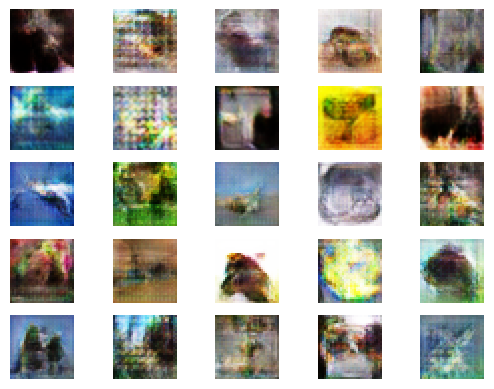

2/2 [==============================] - 0s 6ms/step
Epoch>3, Batch 1/390, d1=0.694, d2=0.694 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>3, Batch 2/390, d1=0.693, d2=0.695 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>3, Batch 3/390, d1=0.694, d2=0.694 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>3, Batch 4/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>3, Batch 5/390, d1=0.693, d2=0.695 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>3, Batch 6/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 4ms/step
Epoch>3, Batch 7/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>3, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>3, Batch 9/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>3, Batch 10/390, d1=0.693, d2=0.696 g=0.6

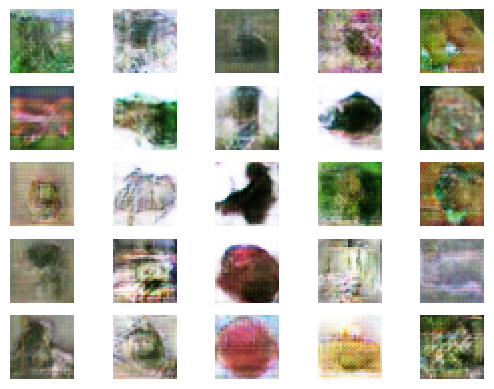

2/2 [==============================] - 0s 6ms/step
Epoch>4, Batch 1/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>4, Batch 2/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>4, Batch 3/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 13ms/step
Epoch>4, Batch 4/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 5/390, d1=0.691, d2=0.697 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 6/390, d1=0.691, d2=0.695 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>4, Batch 7/390, d1=0.691, d2=0.696 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 8/390, d1=0.691, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>4, Batch 9/390, d1=0.693, d2=0.695 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>4, Batch 10/390, d1=0.692, d2=0.694 g=0.6

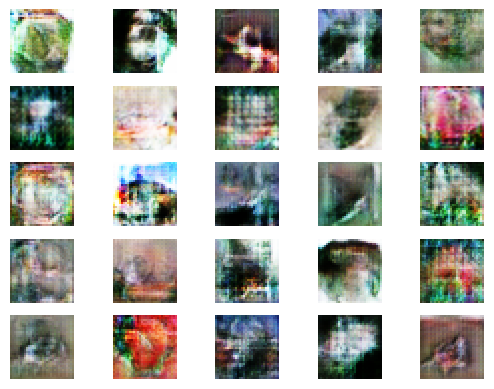

2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>5, Batch 4/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>5, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 6/390, d1=0.693, d2=0.694 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 7/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 8/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>5, Batch 10/390, d1=0.693, d2=0.693 g=0.694

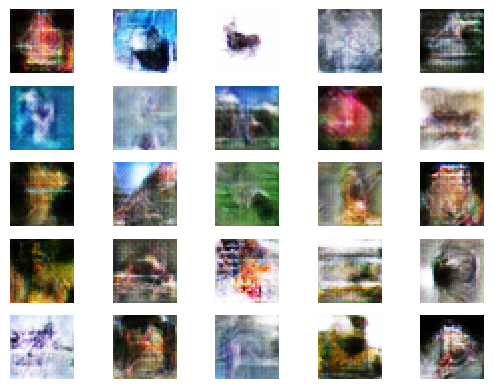

2/2 [==============================] - 0s 10ms/step
Epoch>6, Batch 1/390, d1=0.693, d2=0.695 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>6, Batch 3/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 4/390, d1=0.694, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 5/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>6, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>6, Batch 7/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>6, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 10/390, d1=0.694, d2=0.693 g=0.6

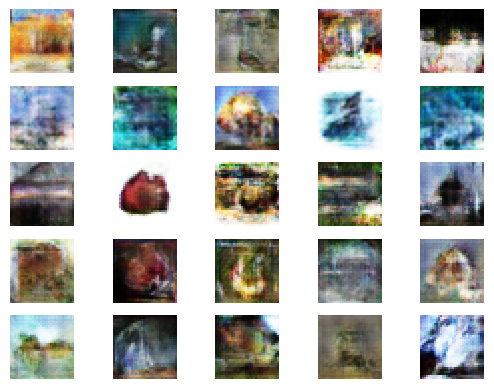

2/2 [==============================] - 0s 7ms/step
Epoch>7, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>7, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>7, Batch 3/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>7, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>7, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>7, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>7, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>7, Batch 8/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 14ms/step
Epoch>7, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 14ms/step
Epoch>7, Batch 10/390, d1=0.694, d2=0.693 g=0.

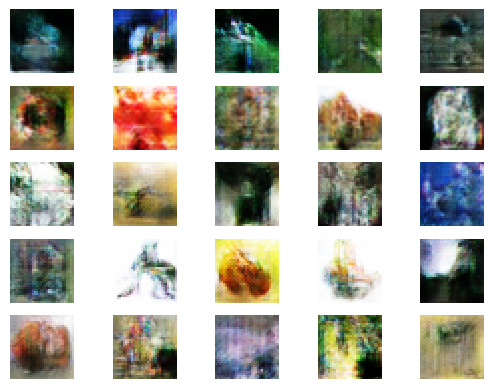

2/2 [==============================] - 0s 9ms/step
Epoch>8, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>8, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>8, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>8, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>8, Batch 7/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>8, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 9/390, d1=0.695, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>8, Batch 10/390, d1=0.695, d2=0.694 g=0.6

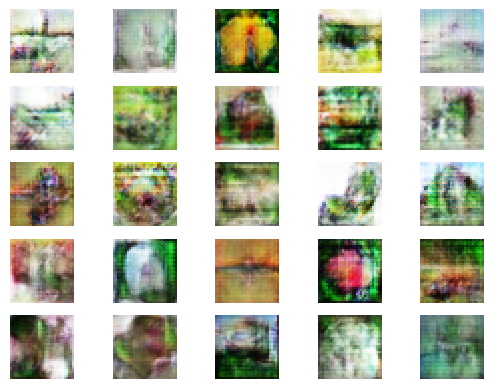

2/2 [==============================] - 0s 7ms/step
Epoch>9, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>9, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 13ms/step
Epoch>9, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 5/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 9ms/step
Epoch>9, Batch 6/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 7/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 8/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>9, Batch 9/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 12ms/step
Epoch>9, Batch 10/390, d1=0.694, d2=0.693 g=0.

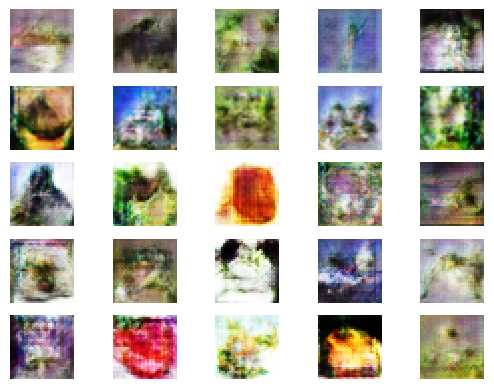

2/2 [==============================] - 0s 6ms/step
Epoch>10, Batch 1/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>10, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>10, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 12ms/step
Epoch>10, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 13ms/step
Epoch>10, Batch 5/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>10, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>10, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>10, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>10, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 13ms/step
Epoch>10, Batch 10/390, d1=0.694, d

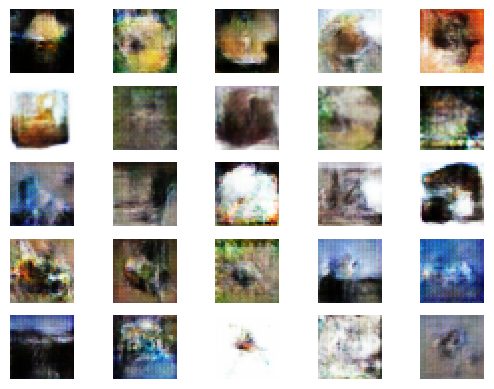

2/2 [==============================] - 0s 14ms/step
Epoch>11, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 12ms/step
Epoch>11, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>11, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>11, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>11, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 15ms/step
Epoch>11, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>11, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>11, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>11, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 13ms/step
Epoch>11, Batch 10/390, d1=0.694, 

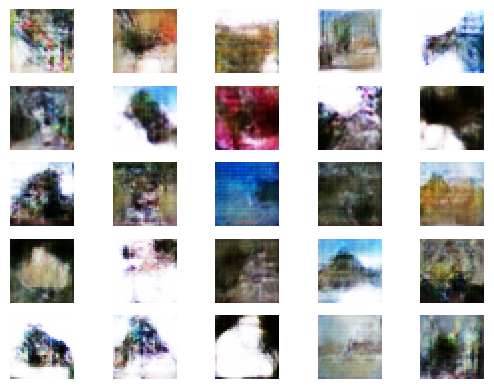

2/2 [==============================] - 0s 15ms/step
Epoch>12, Batch 1/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>12, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>12, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>12, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 12ms/step
Epoch>12, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>12, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>12, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>12, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>12, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>12, Batch 10/390, d1=0.694, d2=

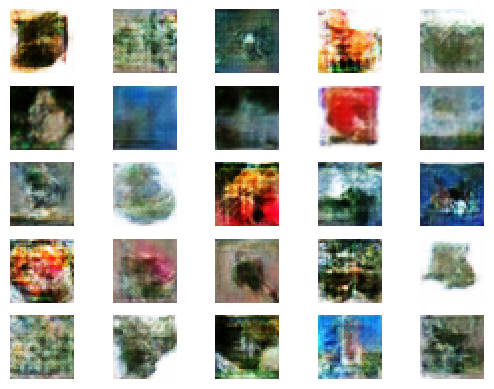

2/2 [==============================] - 0s 10ms/step
Epoch>13, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>13, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>13, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>13, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>13, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>13, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>13, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>13, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>13, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>13, Batch 10/390, d1=0.694, d2=0

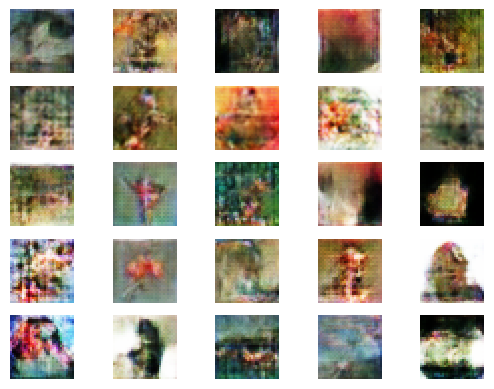

2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>14, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>14, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>14, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>14, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>14, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>14, Batch 10/390, d1=0.694, d2=0

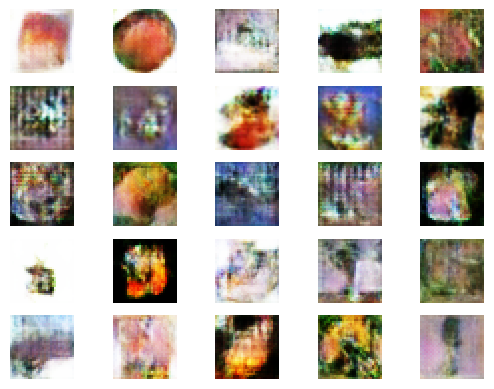

2/2 [==============================] - 0s 7ms/step
Epoch>15, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 16ms/step
Epoch>15, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>15, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>15, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>15, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>15, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>15, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 9/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>15, Batch 10/390, d1=0.694, d2=0.

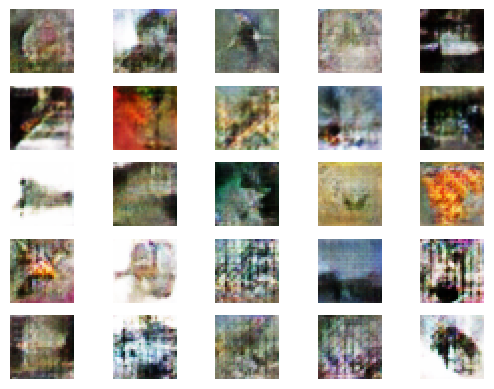

2/2 [==============================] - 0s 9ms/step
Epoch>16, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 19ms/step
Epoch>16, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>16, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>16, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>16, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>16, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 10/390, d1=0.694, d2

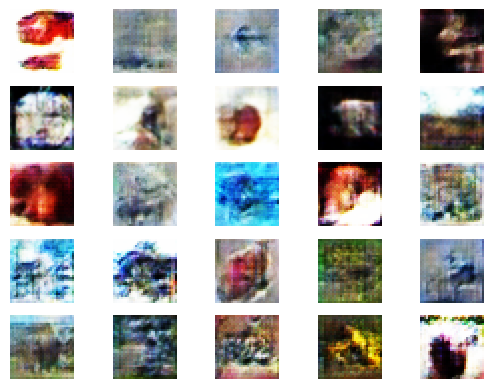

2/2 [==============================] - 0s 4ms/step
Epoch>17, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>17, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>17, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>17, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>17, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>17, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>17, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>17, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>17, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 12ms/step
Epoch>17, Batch 10/390, d1=0.694, d2=0

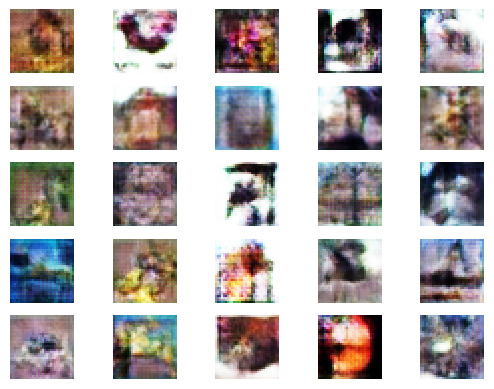

2/2 [==============================] - 0s 7ms/step
Epoch>18, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 13ms/step
Epoch>18, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>18, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>18, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 17ms/step
Epoch>18, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>18, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 12ms/step
Epoch>18, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>18, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>18, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 15ms/step
Epoch>18, Batch 10/390, d1=0.694, 

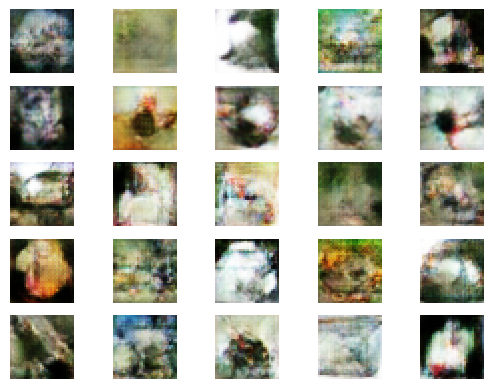

2/2 [==============================] - 0s 14ms/step
Epoch>19, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>19, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>19, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>19, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>19, Batch 10/390, d1=0.694, d2=0

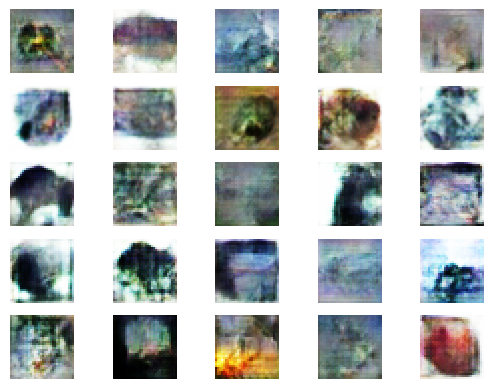

2/2 [==============================] - 0s 7ms/step
Epoch>20, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>20, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>20, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 14ms/step
Epoch>20, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>20, Batch 10/390, d1=0.694, d2=0.

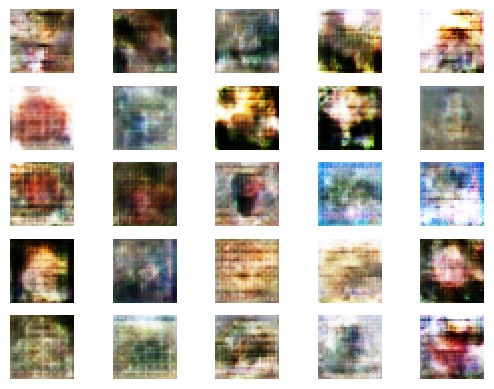

2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 1/390, d1=0.693, d2=0.689 g=0.700
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 2/390, d1=0.688, d2=0.691 g=0.698
2/2 [==============================] - 0s 6ms/step
Epoch>21, Batch 3/390, d1=0.689, d2=0.693 g=0.697
2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 4/390, d1=0.693, d2=0.693 g=0.699
2/2 [==============================] - 0s 9ms/step
Epoch>21, Batch 5/390, d1=0.693, d2=0.695 g=0.696
2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 6/390, d1=0.694, d2=0.691 g=0.697
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 7/390, d1=0.692, d2=0.699 g=0.696
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 8/390, d1=0.690, d2=0.694 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>21, Batch 9/390, d1=0.695, d2=0.694 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 10/390, d1=0.702, d2=0.6

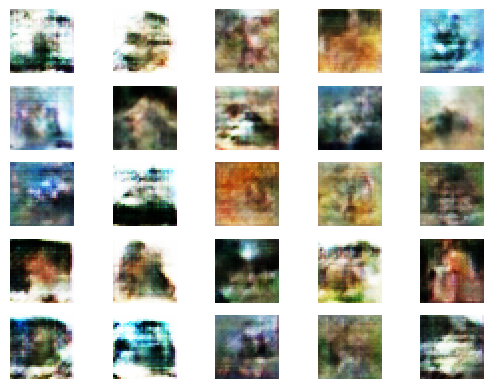

2/2 [==============================] - 0s 15ms/step
Epoch>22, Batch 1/390, d1=0.686, d2=0.698 g=0.690
2/2 [==============================] - 0s 8ms/step
Epoch>22, Batch 2/390, d1=0.694, d2=0.701 g=0.696
2/2 [==============================] - 0s 8ms/step
Epoch>22, Batch 3/390, d1=0.691, d2=0.695 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 4/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>22, Batch 5/390, d1=0.694, d2=0.696 g=0.696
2/2 [==============================] - 0s 5ms/step
Epoch>22, Batch 6/390, d1=0.698, d2=0.689 g=0.696
2/2 [==============================] - 0s 5ms/step
Epoch>22, Batch 7/390, d1=0.692, d2=0.696 g=0.695
2/2 [==============================] - 0s 5ms/step
Epoch>22, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>22, Batch 9/390, d1=0.692, d2=0.695 g=0.695
2/2 [==============================] - 0s 10ms/step
Epoch>22, Batch 10/390, d1=0.693, d2=

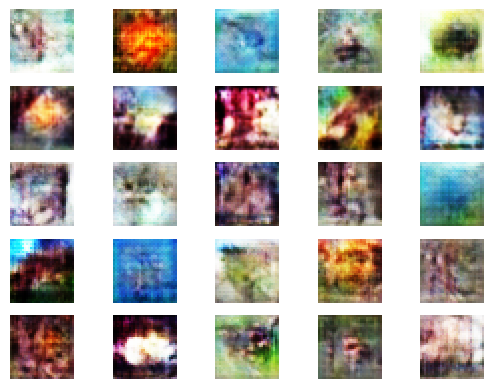

2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 1/390, d1=0.685, d2=0.686 g=0.702
2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 2/390, d1=0.680, d2=0.700 g=0.698
2/2 [==============================] - 0s 5ms/step
Epoch>23, Batch 3/390, d1=0.683, d2=0.699 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>23, Batch 4/390, d1=0.677, d2=0.704 g=0.679
2/2 [==============================] - 0s 8ms/step
Epoch>23, Batch 5/390, d1=0.680, d2=0.715 g=0.680
2/2 [==============================] - 0s 10ms/step
Epoch>23, Batch 6/390, d1=0.685, d2=0.719 g=0.684
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 7/390, d1=0.683, d2=0.715 g=0.680
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 8/390, d1=0.687, d2=0.706 g=0.681
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 9/390, d1=0.695, d2=0.705 g=0.681
2/2 [==============================] - 0s 6ms/step
Epoch>23, Batch 10/390, d1=0.690, d2=0.

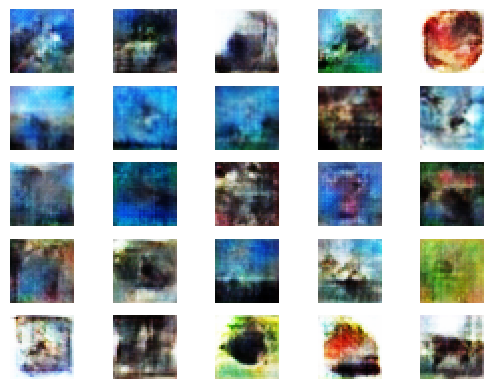

2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 1/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>24, Batch 2/390, d1=0.694, d2=0.693 g=0.697
2/2 [==============================] - 0s 9ms/step
Epoch>24, Batch 3/390, d1=0.694, d2=0.692 g=0.699
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 4/390, d1=0.693, d2=0.686 g=0.700
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 5/390, d1=0.694, d2=0.689 g=0.702
2/2 [==============================] - 0s 5ms/step
Epoch>24, Batch 6/390, d1=0.691, d2=0.686 g=0.703
2/2 [==============================] - 0s 5ms/step
Epoch>24, Batch 7/390, d1=0.695, d2=0.689 g=0.703
2/2 [==============================] - 0s 13ms/step
Epoch>24, Batch 8/390, d1=0.692, d2=0.690 g=0.698
2/2 [==============================] - 0s 8ms/step
Epoch>24, Batch 9/390, d1=0.693, d2=0.687 g=0.699
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 10/390, d1=0.688, d2=0.

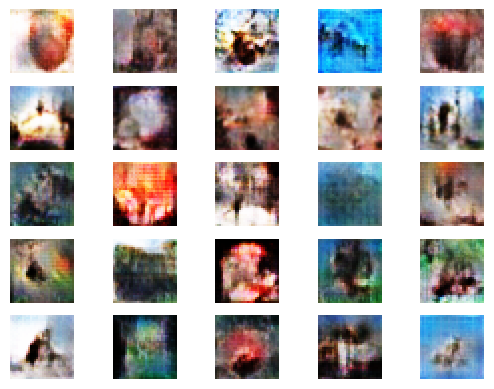

2/2 [==============================] - 0s 11ms/step
Epoch>25, Batch 1/390, d1=0.691, d2=0.695 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>25, Batch 2/390, d1=0.693, d2=0.697 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>25, Batch 3/390, d1=0.687, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>25, Batch 4/390, d1=0.690, d2=0.698 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>25, Batch 5/390, d1=0.686, d2=0.694 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>25, Batch 6/390, d1=0.694, d2=0.695 g=0.695
2/2 [==============================] - 0s 8ms/step
Epoch>25, Batch 7/390, d1=0.691, d2=0.695 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 8/390, d1=0.694, d2=0.696 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>25, Batch 9/390, d1=0.690, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 10/390, d1=0.692, d2=0

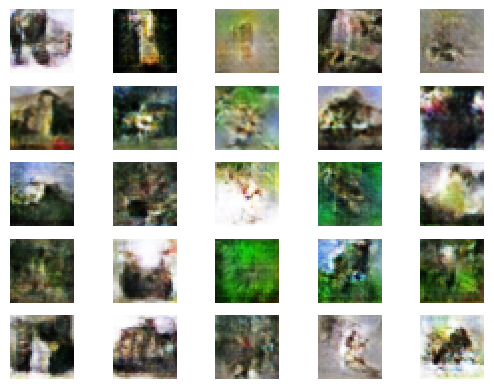

2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 1/390, d1=0.699, d2=0.687 g=0.706
2/2 [==============================] - 0s 13ms/step
Epoch>26, Batch 2/390, d1=0.697, d2=0.681 g=0.706
2/2 [==============================] - 0s 9ms/step
Epoch>26, Batch 3/390, d1=0.702, d2=0.684 g=0.706
2/2 [==============================] - 0s 9ms/step
Epoch>26, Batch 4/390, d1=0.702, d2=0.683 g=0.703
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 5/390, d1=0.702, d2=0.687 g=0.702
2/2 [==============================] - 0s 8ms/step
Epoch>26, Batch 6/390, d1=0.703, d2=0.692 g=0.699
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 7/390, d1=0.702, d2=0.689 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 8/390, d1=0.700, d2=0.691 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>26, Batch 9/390, d1=0.698, d2=0.691 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 10/390, d1=0.695, d2=0

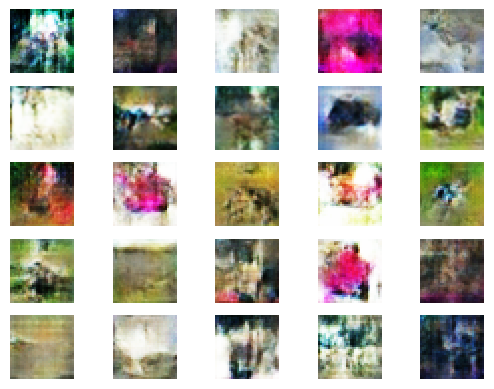

2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 1/390, d1=0.692, d2=0.692 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>27, Batch 2/390, d1=0.695, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 3/390, d1=0.692, d2=0.696 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 4/390, d1=0.691, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 5/390, d1=0.694, d2=0.695 g=0.691
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 6/390, d1=0.689, d2=0.694 g=0.690
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 7/390, d1=0.691, d2=0.697 g=0.691
2/2 [==============================] - 0s 8ms/step
Epoch>27, Batch 8/390, d1=0.690, d2=0.696 g=0.687
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 9/390, d1=0.690, d2=0.701 g=0.691
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 10/390, d1=0.691, d2=0.6

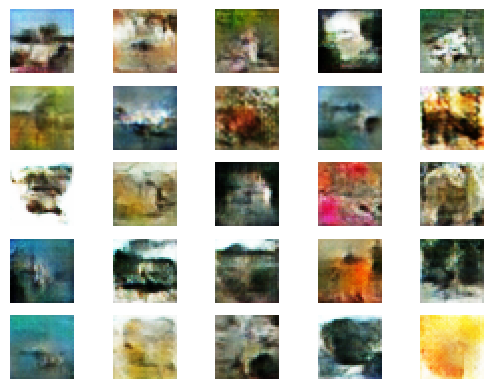

2/2 [==============================] - 0s 5ms/step
Epoch>28, Batch 1/390, d1=0.692, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 2/390, d1=0.693, d2=0.692 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>28, Batch 3/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>28, Batch 4/390, d1=0.694, d2=0.694 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 5/390, d1=0.694, d2=0.692 g=0.695
2/2 [==============================] - 0s 14ms/step
Epoch>28, Batch 6/390, d1=0.695, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 7/390, d1=0.693, d2=0.691 g=0.696
2/2 [==============================] - 0s 10ms/step
Epoch>28, Batch 8/390, d1=0.693, d2=0.691 g=0.696
2/2 [==============================] - 0s 4ms/step
Epoch>28, Batch 9/390, d1=0.695, d2=0.689 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 10/390, d1=0.692, d2=0

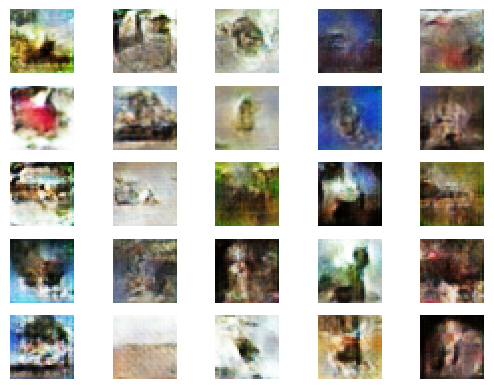

2/2 [==============================] - 0s 9ms/step
Epoch>29, Batch 1/390, d1=0.691, d2=0.693 g=0.691
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 2/390, d1=0.688, d2=0.695 g=0.689
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 3/390, d1=0.688, d2=0.707 g=0.685
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 4/390, d1=0.689, d2=0.701 g=0.690
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 5/390, d1=0.689, d2=0.702 g=0.688
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 6/390, d1=0.690, d2=0.696 g=0.688
2/2 [==============================] - 0s 6ms/step
Epoch>29, Batch 7/390, d1=0.691, d2=0.699 g=0.691
2/2 [==============================] - 0s 9ms/step
Epoch>29, Batch 8/390, d1=0.691, d2=0.697 g=0.691
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 9/390, d1=0.691, d2=0.698 g=0.692
2/2 [==============================] - 0s 10ms/step
Epoch>29, Batch 10/390, d1=0.689, d2=0.

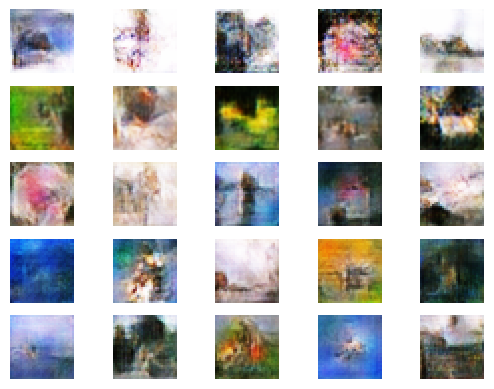

2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 1/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 2/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 3/390, d1=0.694, d2=0.692 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 4/390, d1=0.693, d2=0.694 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 5/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 6/390, d1=0.695, d2=0.692 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 7/390, d1=0.694, d2=0.693 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 8/390, d1=0.693, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 9/390, d1=0.693, d2=0.691 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 10/390, d1=0.695, d2=0.6

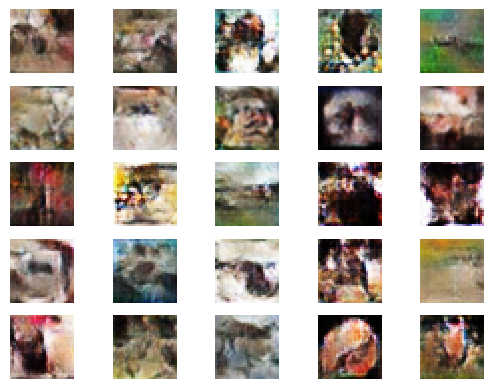

2/2 [==============================] - 0s 5ms/step
Epoch>31, Batch 1/390, d1=0.696, d2=0.690 g=0.697
2/2 [==============================] - 0s 8ms/step
Epoch>31, Batch 2/390, d1=0.696, d2=0.689 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 3/390, d1=0.696, d2=0.691 g=0.697
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 4/390, d1=0.696, d2=0.691 g=0.697
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 5/390, d1=0.696, d2=0.692 g=0.697
2/2 [==============================] - 0s 5ms/step
Epoch>31, Batch 6/390, d1=0.696, d2=0.690 g=0.697
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 7/390, d1=0.695, d2=0.691 g=0.696
2/2 [==============================] - 0s 8ms/step
Epoch>31, Batch 8/390, d1=0.695, d2=0.691 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 9/390, d1=0.695, d2=0.691 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 10/390, d1=0.696, d2=0.6

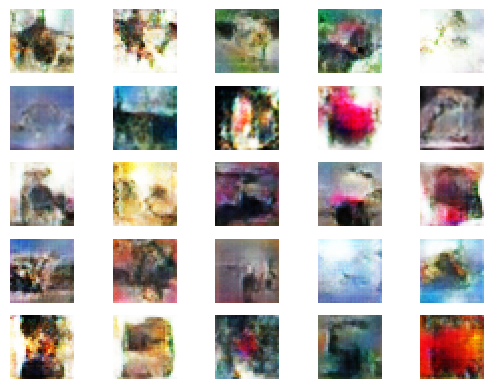

2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 1/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 3/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 5/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>32, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>32, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 10/390, d1=0.693, d2=0.6

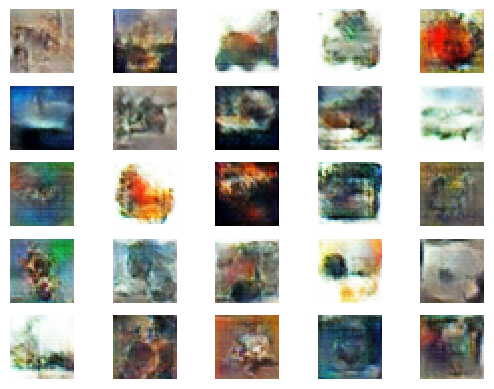

2/2 [==============================] - 0s 7ms/step
Epoch>33, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 2/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>33, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>33, Batch 7/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 8/390, d1=0.694, d2=0.692 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 10/390, d1=0.693, d2=0.6

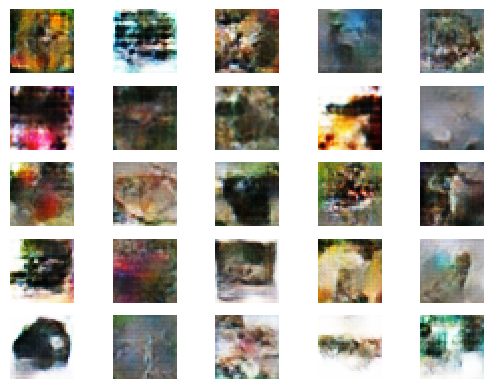

2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>34, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 4/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>34, Batch 6/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>34, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>34, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 10/390, d1=0.694, d2=

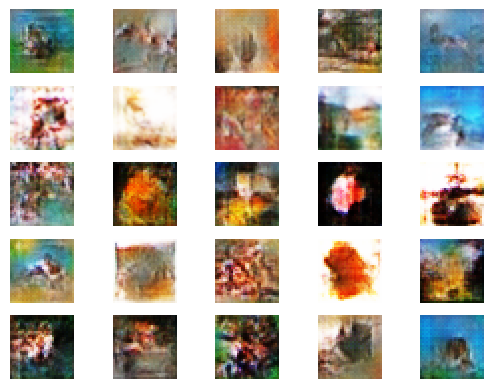

2/2 [==============================] - 0s 10ms/step
Epoch>35, Batch 1/390, d1=0.693, d2=0.693 g=0.700
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 2/390, d1=0.692, d2=0.693 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 3/390, d1=0.697, d2=0.689 g=0.698
2/2 [==============================] - 0s 8ms/step
Epoch>35, Batch 4/390, d1=0.694, d2=0.690 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 5/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 6/390, d1=0.694, d2=0.692 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 7/390, d1=0.698, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 9/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 10/390, d1=0.693, d2=0.

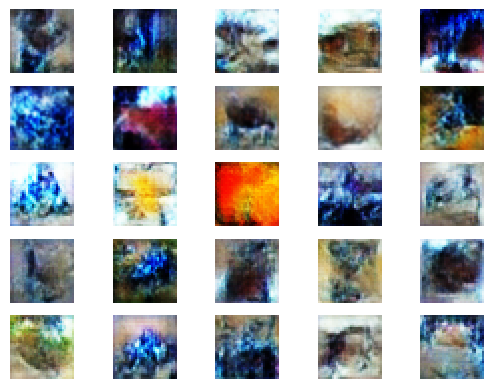

2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 1/390, d1=0.689, d2=0.721 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 2/390, d1=0.694, d2=0.691 g=0.695
2/2 [==============================] - 0s 8ms/step
Epoch>36, Batch 3/390, d1=0.695, d2=0.692 g=0.695
2/2 [==============================] - 0s 12ms/step
Epoch>36, Batch 4/390, d1=0.694, d2=0.690 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 5/390, d1=0.694, d2=0.692 g=0.699
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 6/390, d1=0.693, d2=0.692 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 7/390, d1=0.693, d2=0.693 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 8/390, d1=0.693, d2=0.693 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 9/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 10/390, d1=0.695, d2=0.

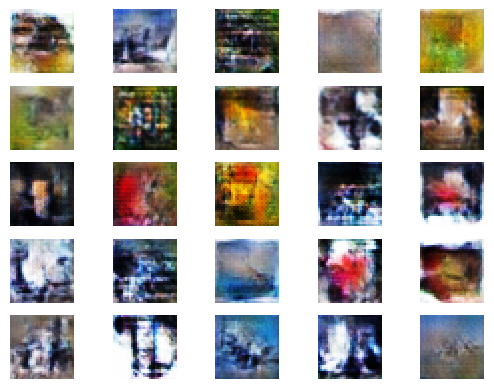

2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 2/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 4/390, d1=0.694, d2=0.692 g=0.695
2/2 [==============================] - 0s 8ms/step
Epoch>37, Batch 5/390, d1=0.693, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 7/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 9/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 10/390, d1=0.693, d2=0.6

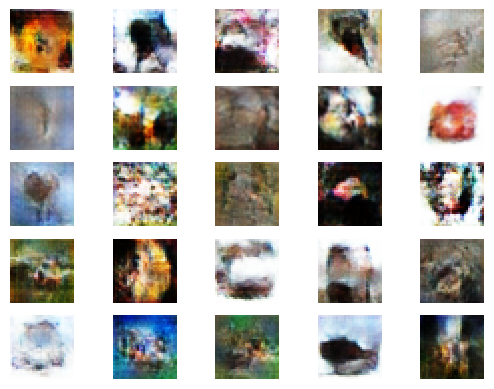

2/2 [==============================] - 0s 4ms/step
Epoch>38, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>38, Batch 3/390, d1=0.694, d2=0.691 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>38, Batch 4/390, d1=0.694, d2=0.692 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>38, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>38, Batch 6/390, d1=0.694, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 9/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>38, Batch 10/390, d1=0.694, d2=0.6

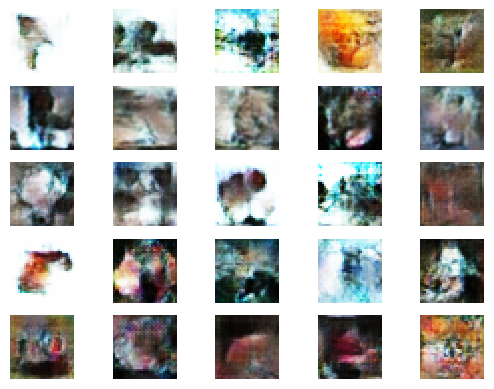

2/2 [==============================] - 0s 5ms/step
Epoch>39, Batch 1/390, d1=0.694, d2=0.691 g=0.695
2/2 [==============================] - 0s 8ms/step
Epoch>39, Batch 2/390, d1=0.695, d2=0.692 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 3/390, d1=0.696, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 4/390, d1=0.695, d2=0.691 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 5/390, d1=0.695, d2=0.692 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 6/390, d1=0.694, d2=0.691 g=0.695
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 7/390, d1=0.695, d2=0.691 g=0.696
2/2 [==============================] - 0s 8ms/step
Epoch>39, Batch 8/390, d1=0.696, d2=0.691 g=0.696
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 9/390, d1=0.696, d2=0.692 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 10/390, d1=0.696, d2=0.6

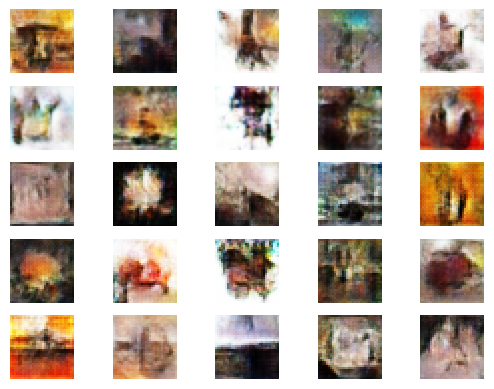

2/2 [==============================] - 0s 8ms/step
Epoch>40, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 2/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>40, Batch 3/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 4/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>40, Batch 5/390, d1=0.694, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>40, Batch 7/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 8/390, d1=0.694, d2=0.692 g=0.695
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 9/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 10/390, d1=0.694, d2=0

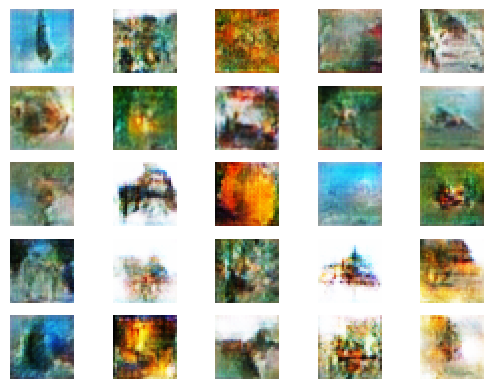

2/2 [==============================] - 0s 8ms/step
Epoch>41, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>41, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>41, Batch 5/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>41, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>41, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>41, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 10/390, d1=0.694, d2=0.6

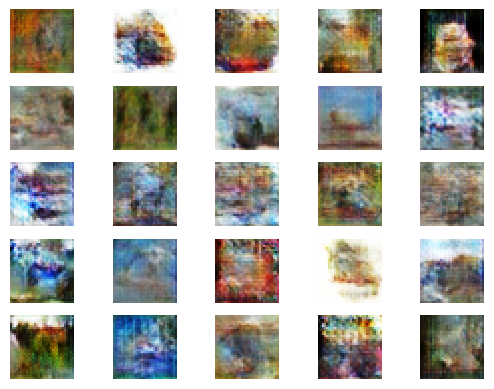

2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>42, Batch 2/390, d1=0.694, d2=0.693 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>42, Batch 3/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 4/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 5/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 6/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 7/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 8/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>42, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 10/390, d1=0.694, d2=0.6

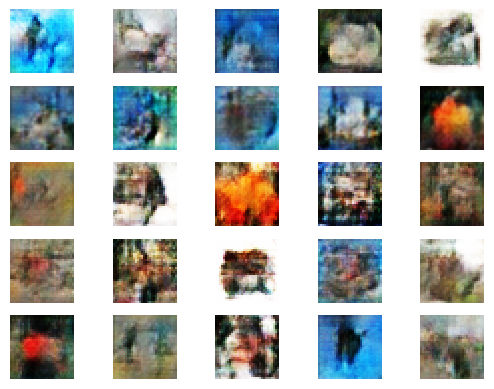

2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>43, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 3/390, d1=0.693, d2=0.692 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 4/390, d1=0.693, d2=0.693 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>43, Batch 6/390, d1=0.693, d2=0.695 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 7/390, d1=0.694, d2=0.697 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 8/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 9/390, d1=0.694, d2=0.695 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 10/390, d1=0.694, d2=0.6

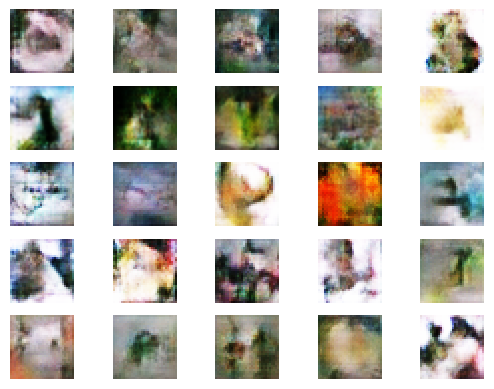

2/2 [==============================] - 0s 5ms/step
Epoch>44, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>44, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>44, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>44, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 10/390, d1=0.694, d2=0.6

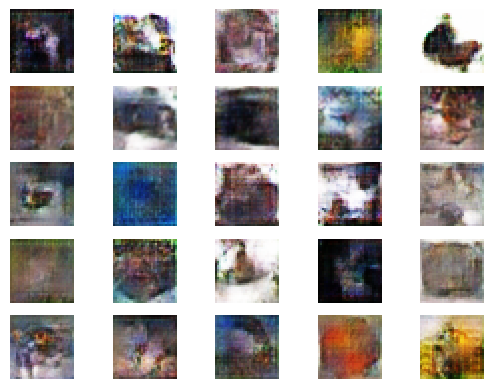

2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 1/390, d1=0.692, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>45, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 4/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 6/390, d1=0.692, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 8/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 9/390, d1=0.692, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 10/390, d1=0.693, d2=0.6

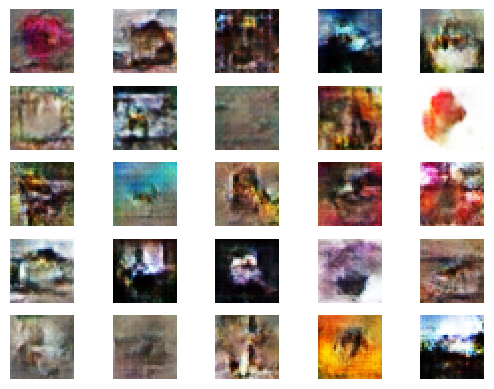

2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 3/390, d1=0.695, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 10/390, d1=0.694, d2=0.6

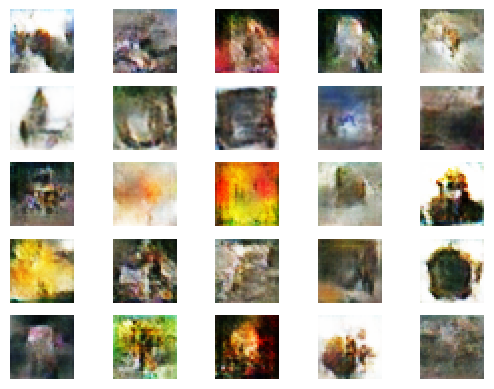

2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 2/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 4/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 6/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>47, Batch 7/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>47, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>47, Batch 9/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>47, Batch 10/390, d1=0.694, d2=0

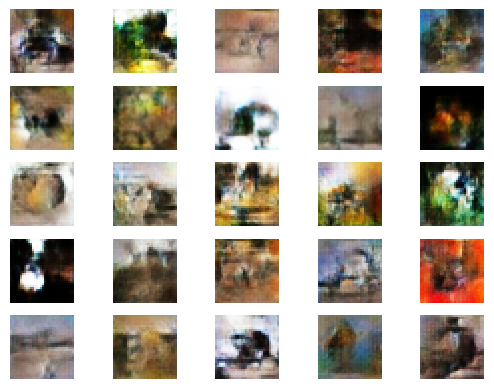

2/2 [==============================] - 0s 7ms/step
Epoch>48, Batch 1/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 2/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 10ms/step
Epoch>48, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 4/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 5/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 6/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>48, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>48, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 10/390, d1=0.694, d2=0.

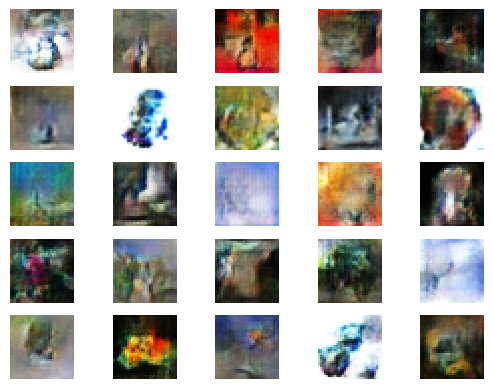

2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>49, Batch 2/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>49, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 4/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>49, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 8/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 9/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 10/390, d1=0.694, d2=0.6

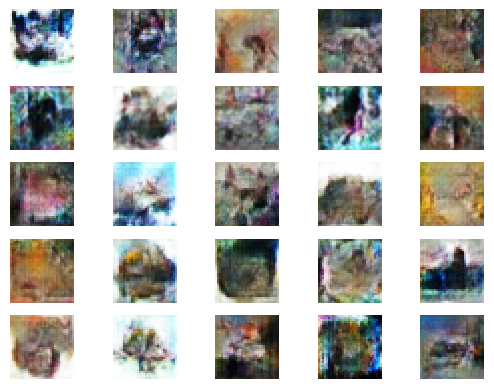

2/2 [==============================] - 0s 9ms/step
Epoch>50, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 2/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>50, Batch 3/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>50, Batch 4/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 5/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>50, Batch 6/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 7/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>50, Batch 8/390, d1=0.693, d2=0.692 g=0.695
2/2 [==============================] - 0s 8ms/step
Epoch>50, Batch 9/390, d1=0.694, d2=0.691 g=0.698
2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 10/390, d1=0.694, d2=0.

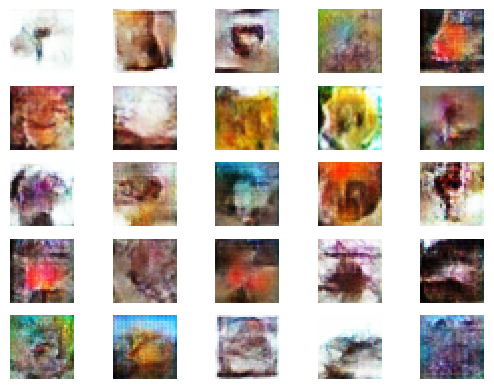

In [ ]:
# more traininggg

from keras.models import load_model
from numpy.random import randn
# size of the latent space
latent_dim = 100

# create the discriminator
discriminator = define_discriminator()

# Load the saved model
generator = load_model('/content/drive/MyDrive/GAN/cifar_GAN.h5')

# create the gan
gan_model = define_gan(generator, discriminator)

# load image data
dataset = load_real_samples()

# train model
train(generator, discriminator, gan_model, dataset, latent_dim, n_epochs=50)


1/1 [==============================] - 8s 8s/step


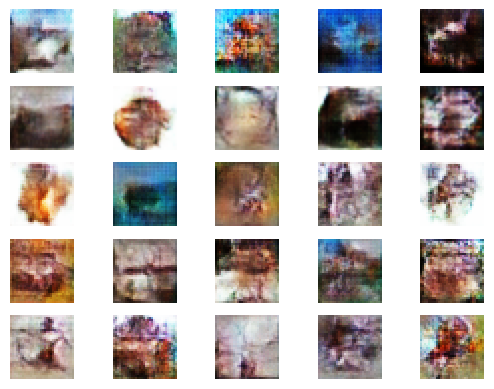

In [ ]:
from keras.models import load_model
from numpy.random import randn
import numpy as np
# load model
model = load_model('/content/drive/MyDrive/GAN/cifar_GAN_2.h5') #Model trained for 70 epochs
# generate images
latent_points = generate_latent_points(100, 25)  #Latent dim and n_samples
# generate images
X = model.predict(latent_points)
# scale from [-1,1] to [0,1]
X = (X + 1) / 2.0

import numpy as np
X = (X*255).astype(np.uint8)

# plot the result
show_plot(X, 5)

#Note: CIFAR10 classes are: airplane, automobile, bird, cat, deer, dog, frog, horse,
# ship, truck

2/2 [==============================] - 0s 7ms/step
Epoch>1, Batch 1/390, d1=0.695, d2=0.703 g=0.686
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 2/390, d1=0.685, d2=0.705 g=0.684
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 3/390, d1=0.682, d2=0.707 g=0.683
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 4/390, d1=0.683, d2=0.709 g=0.683
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 5/390, d1=0.682, d2=0.706 g=0.684
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 6/390, d1=0.682, d2=0.706 g=0.684
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 7/390, d1=0.684, d2=0.706 g=0.684
2/2 [==============================] - 0s 4ms/step
Epoch>1, Batch 8/390, d1=0.685, d2=0.702 g=0.686
2/2 [==============================] - 0s 6ms/step
Epoch>1, Batch 9/390, d1=0.682, d2=0.707 g=0.683
2/2 [==============================] - 0s 5ms/step
Epoch>1, Batch 10/390, d1=0.682, d2=0.707 g=0.684

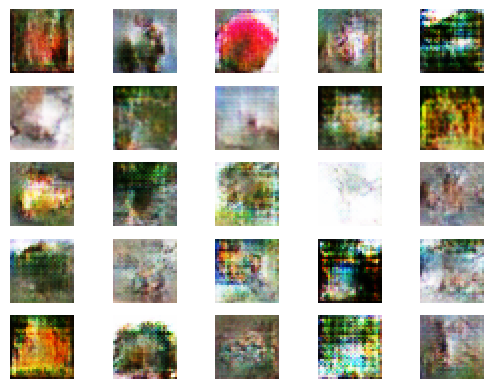

2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 1/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 2/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 3/390, d1=0.691, d2=0.694 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 4/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>2, Batch 5/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>2, Batch 6/390, d1=0.692, d2=0.696 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>2, Batch 7/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 8/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>2, Batch 9/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>2, Batch 10/390, d1=0.691, d2=0.695 g=0.692

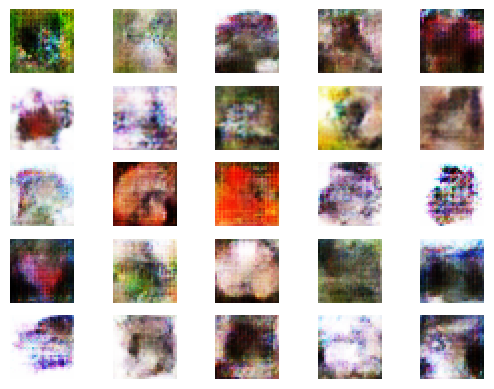

2/2 [==============================] - 0s 13ms/step
Epoch>3, Batch 1/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 11ms/step
Epoch>3, Batch 2/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>3, Batch 3/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 13ms/step
Epoch>3, Batch 4/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>3, Batch 5/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 4ms/step
Epoch>3, Batch 6/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>3, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>3, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>3, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>3, Batch 10/390, d1=0.693, d2=0.694 g=0

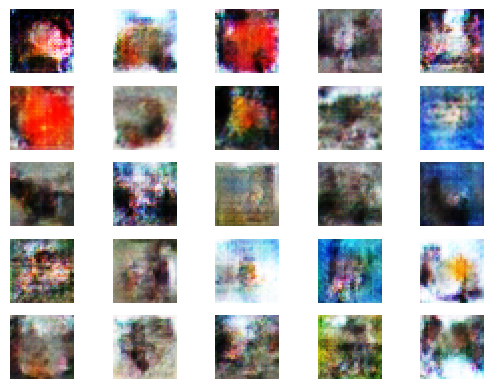

2/2 [==============================] - 0s 4ms/step
Epoch>4, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>4, Batch 2/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>4, Batch 3/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>4, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>4, Batch 5/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>4, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>4, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>4, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>4, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>4, Batch 10/390, d1=0.693, d2=0.694 g

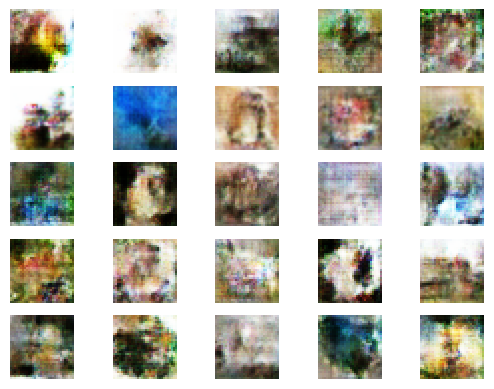

2/2 [==============================] - 0s 5ms/step
Epoch>5, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 15ms/step
Epoch>5, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>5, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>5, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>5, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>5, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>5, Batch 10/390, d1=0.693, d2=0.693 g=0

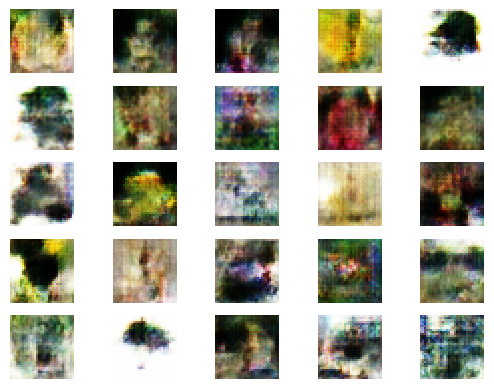

2/2 [==============================] - 0s 14ms/step
Epoch>6, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>6, Batch 2/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>6, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>6, Batch 4/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 5/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>6, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>6, Batch 7/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>6, Batch 8/390, d1=0.692, d2=0.696 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 9/390, d1=0.691, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>6, Batch 10/390, d1=0.692, d2=0.694 g=0.

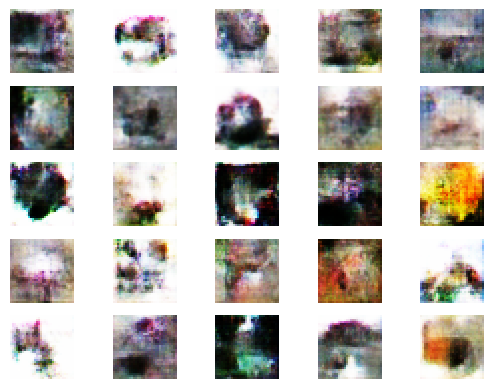

2/2 [==============================] - 0s 10ms/step
Epoch>7, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 15ms/step
Epoch>7, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>7, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>7, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>7, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>7, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>7, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>7, Batch 8/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 15ms/step
Epoch>7, Batch 9/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>7, Batch 10/390, d1=0.693, d2=0.693 g=

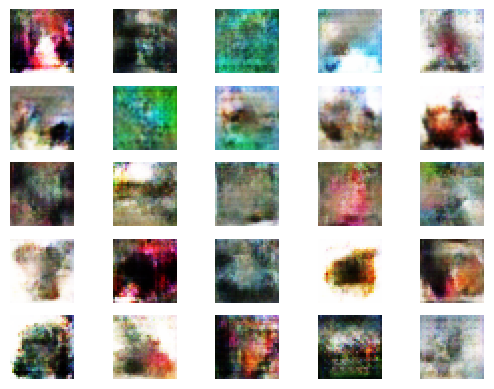

2/2 [==============================] - 0s 11ms/step
Epoch>8, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>8, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>8, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>8, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>8, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>8, Batch 10/390, d1=0.693, d2=0.694 g=0.69

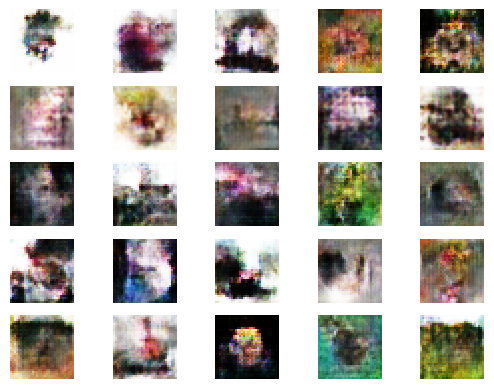

2/2 [==============================] - 0s 5ms/step
Epoch>9, Batch 1/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>9, Batch 2/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 11ms/step
Epoch>9, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>9, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>9, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>9, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>9, Batch 8/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>9, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>9, Batch 10/390, d1=0.693, d2=0.694 g=0.69

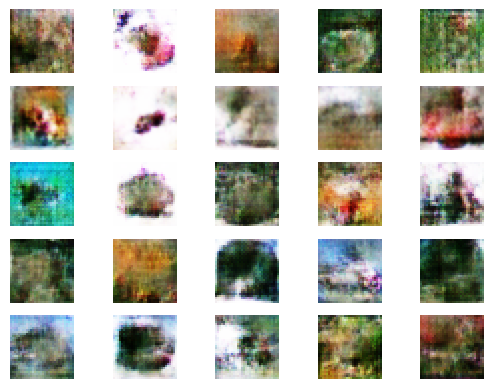

2/2 [==============================] - 0s 10ms/step
Epoch>10, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>10, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>10, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>10, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>10, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>10, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>10, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>10, Batch 10/390, d1=0.693, d2=0.

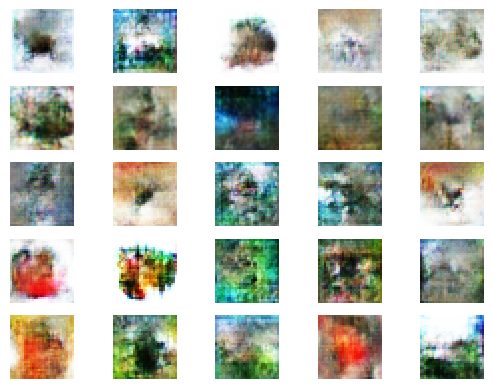

2/2 [==============================] - 0s 13ms/step
Epoch>11, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>11, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>11, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>11, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>11, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>11, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>11, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>11, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>11, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>11, Batch 10/390, d1=0.693, d2=

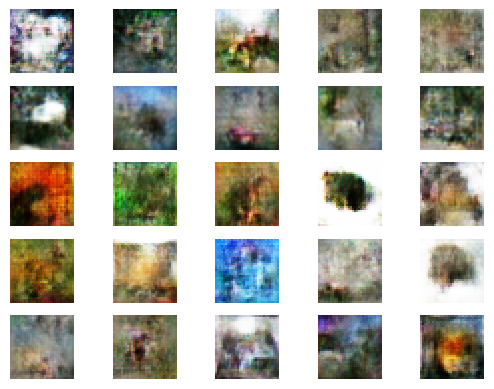

2/2 [==============================] - 0s 9ms/step
Epoch>12, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>12, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>12, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>12, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>12, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>12, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>12, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>12, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>12, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>12, Batch 10/390, d1=0.693, d2=

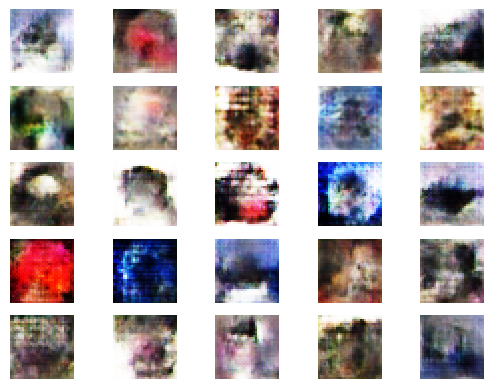

2/2 [==============================] - 0s 6ms/step
Epoch>13, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>13, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>13, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>13, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>13, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>13, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 14ms/step
Epoch>13, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>13, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>13, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 3ms/step
Epoch>13, Batch 10/390, d1=0.693, d2=

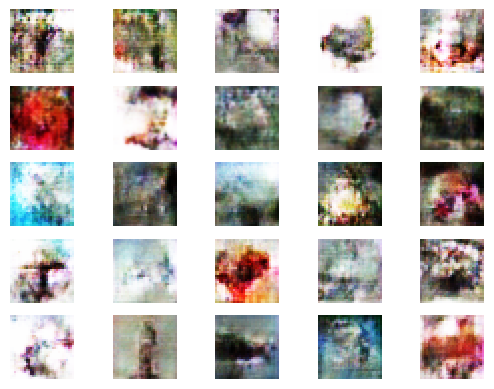

2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 14ms/step
Epoch>14, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>14, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>14, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>14, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 14ms/step
Epoch>14, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>14, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>14, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>14, Batch 10/390, d1=0.693, d2=0

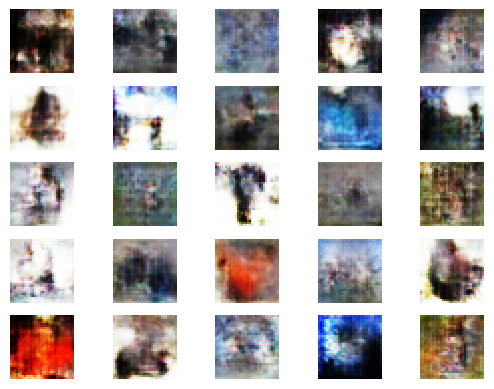

2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>15, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>15, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>15, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>15, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>15, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>15, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>15, Batch 10/390, d1=0.693, d2=0.

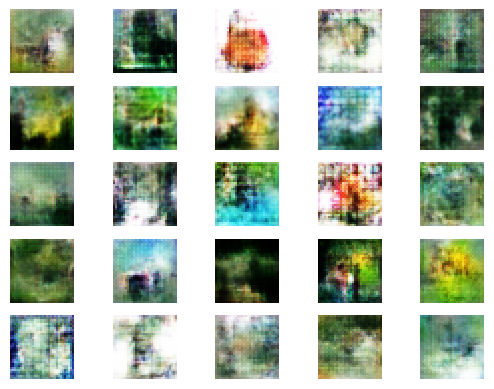

2/2 [==============================] - 0s 12ms/step
Epoch>16, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>16, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 16ms/step
Epoch>16, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>16, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>16, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 13ms/step
Epoch>16, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>16, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>16, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>16, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>16, Batch 10/390, d1=0.693, d2=

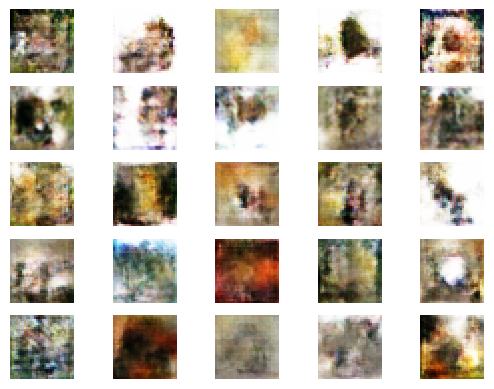

2/2 [==============================] - 0s 7ms/step
Epoch>17, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>17, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>17, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>17, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>17, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>17, Batch 6/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>17, Batch 7/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>17, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>17, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>17, Batch 10/390, d1=0.693, d2=0

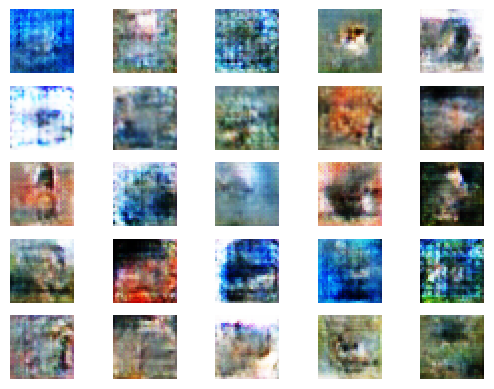

2/2 [==============================] - 0s 13ms/step
Epoch>18, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>18, Batch 2/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>18, Batch 3/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 11ms/step
Epoch>18, Batch 4/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>18, Batch 5/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>18, Batch 6/390, d1=0.694, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>18, Batch 7/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>18, Batch 8/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>18, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>18, Batch 10/390, d1=0.693, d2=

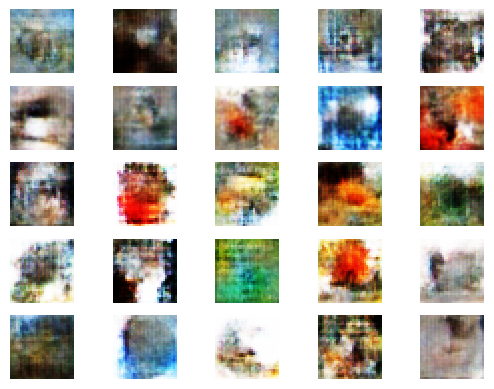

2/2 [==============================] - 0s 6ms/step
Epoch>19, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 14ms/step
Epoch>19, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>19, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>19, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>19, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>19, Batch 10/390, d1=0.693, d2=0.

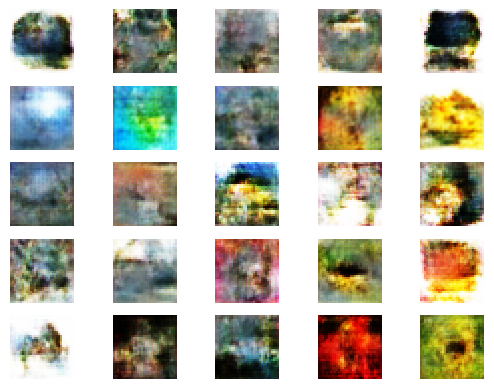

2/2 [==============================] - 0s 10ms/step
Epoch>20, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>20, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>20, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>20, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>20, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>20, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>20, Batch 10/390, d1=0.693, d2=

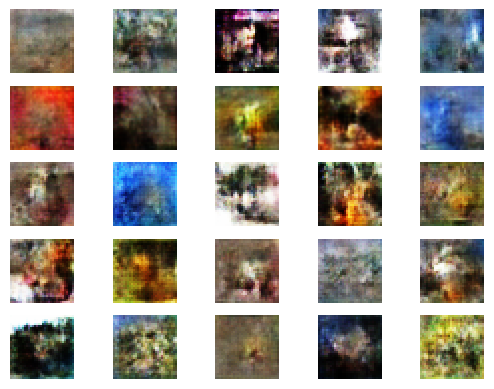

2/2 [==============================] - 0s 10ms/step
Epoch>21, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 16ms/step
Epoch>21, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>21, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 18ms/step
Epoch>21, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>21, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>21, Batch 10/390, d1=0.693, d2

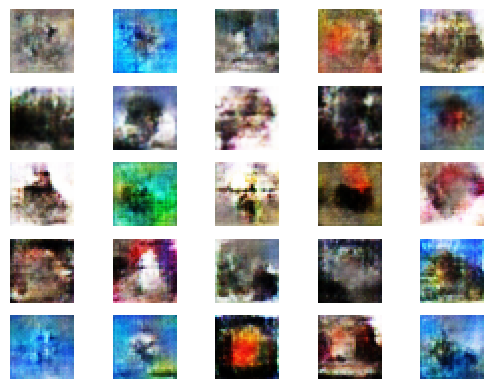

2/2 [==============================] - 0s 7ms/step
Epoch>22, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>22, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>22, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>22, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>22, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>22, Batch 10/390, d1=0.693, d2=0.6

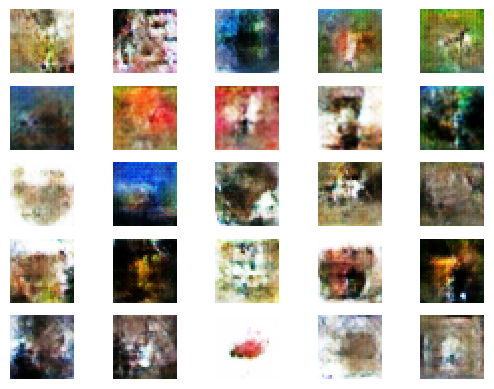

2/2 [==============================] - 0s 14ms/step
Epoch>23, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>23, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>23, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>23, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>23, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>23, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>23, Batch 10/390, d1=0.693, d2=0.

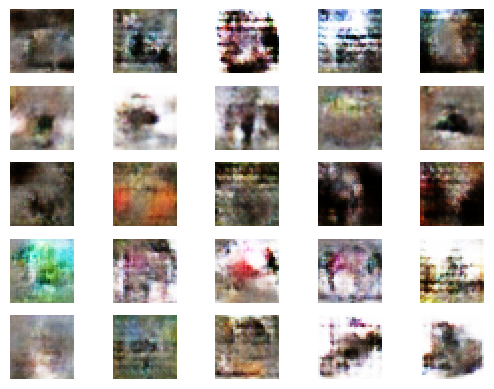

2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>24, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>24, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>24, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>24, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>24, Batch 10/390, d1=0.693, d2=0.6

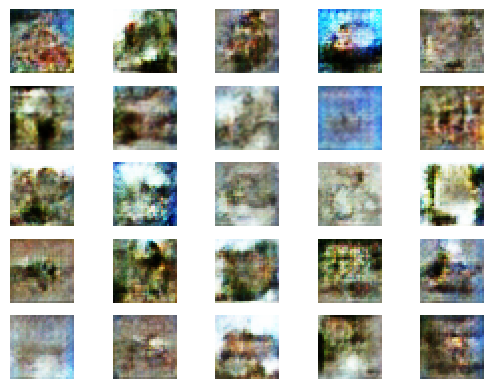

2/2 [==============================] - 0s 7ms/step
Epoch>25, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>25, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>25, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>25, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>25, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>25, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>25, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>25, Batch 10/390, d1=0.693, d2=0.

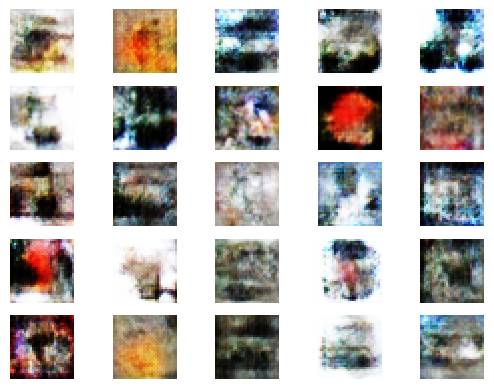

2/2 [==============================] - 0s 8ms/step
Epoch>26, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>26, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>26, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>26, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>26, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>26, Batch 10/390, d1=0.693, d2=0.6

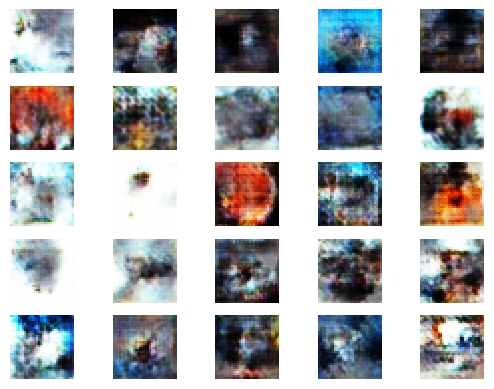

2/2 [==============================] - 0s 4ms/step
Epoch>27, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>27, Batch 3/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>27, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>27, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>27, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>27, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>27, Batch 10/390, d1=0.693, d2=0.6

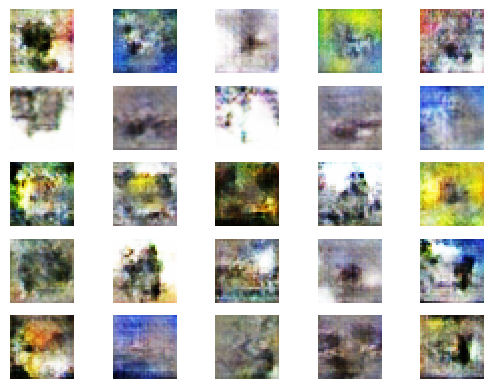

2/2 [==============================] - 0s 5ms/step
Epoch>28, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>28, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>28, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 11ms/step
Epoch>28, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 12ms/step
Epoch>28, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>28, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>28, Batch 10/390, d1=0.693, d2=0

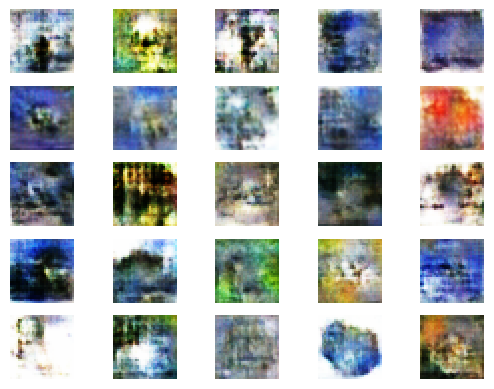

2/2 [==============================] - 0s 5ms/step
Epoch>29, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>29, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>29, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>29, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>29, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>29, Batch 10/390, d1=0.693, d2=0.6

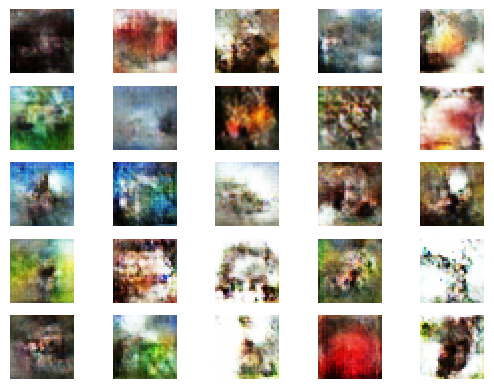

2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>30, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 7/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 8/390, d1=0.692, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>30, Batch 9/390, d1=0.695, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>30, Batch 10/390, d1=0.693, d2=0.6

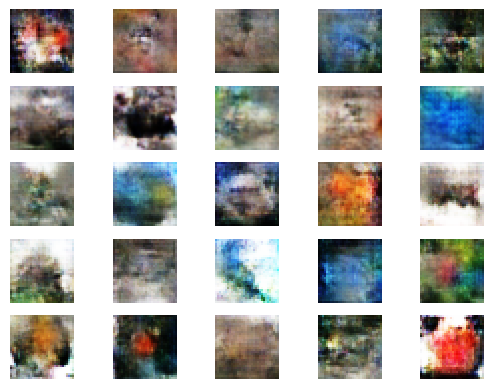

2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>31, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>31, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>31, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>31, Batch 10/390, d1=0.693, d2=0.6

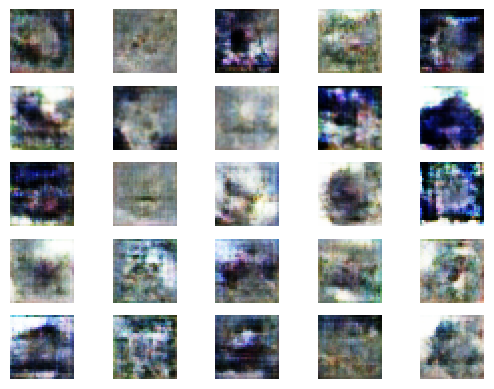

2/2 [==============================] - 0s 10ms/step
Epoch>32, Batch 1/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 2/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 3/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 4/390, d1=0.691, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 5/390, d1=0.690, d2=0.696 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 6/390, d1=0.689, d2=0.698 g=0.691
2/2 [==============================] - 0s 7ms/step
Epoch>32, Batch 7/390, d1=0.689, d2=0.698 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 8/390, d1=0.685, d2=0.703 g=0.689
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 9/390, d1=0.689, d2=0.700 g=0.691
2/2 [==============================] - 0s 6ms/step
Epoch>32, Batch 10/390, d1=0.691, d2=0.

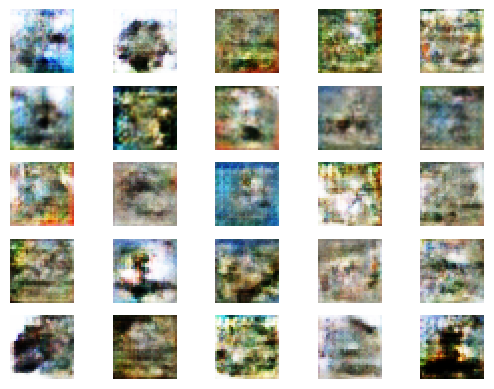

2/2 [==============================] - 0s 7ms/step
Epoch>33, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>33, Batch 2/390, d1=0.692, d2=0.692 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 4/390, d1=0.693, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 5/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 6/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>33, Batch 7/390, d1=0.692, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>33, Batch 9/390, d1=0.691, d2=0.694 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>33, Batch 10/390, d1=0.693, d2=0.6

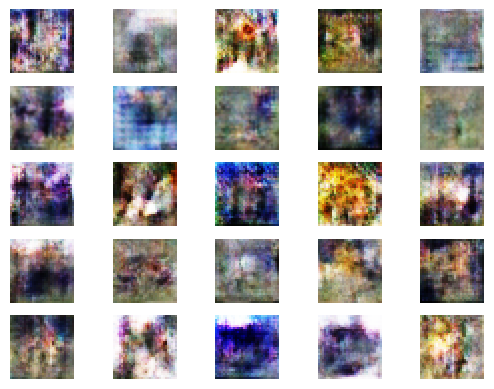

2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 1/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 2/390, d1=0.692, d2=0.696 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 3/390, d1=0.693, d2=0.695 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 4/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 5/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>34, Batch 6/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 7/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>34, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 9/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>34, Batch 10/390, d1=0.693, d2=0.6

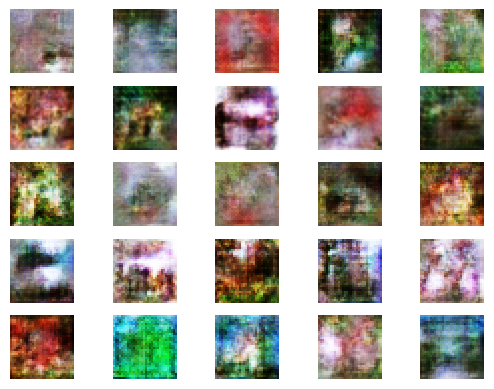

2/2 [==============================] - 0s 8ms/step
Epoch>35, Batch 1/390, d1=0.694, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 2/390, d1=0.693, d2=0.695 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>35, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>35, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 9/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>35, Batch 10/390, d1=0.693, d2=0.6

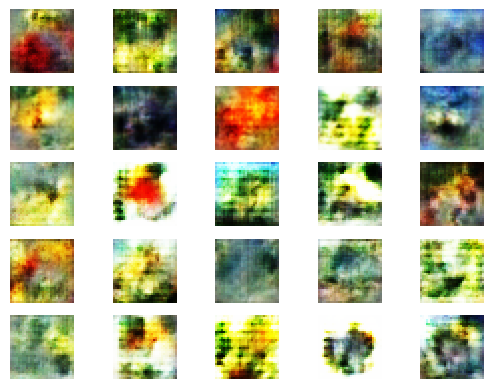

2/2 [==============================] - 0s 5ms/step
Epoch>36, Batch 1/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 2/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 3/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>36, Batch 4/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>36, Batch 5/390, d1=0.693, d2=0.692 g=0.696
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 6/390, d1=0.693, d2=0.691 g=0.699
2/2 [==============================] - 0s 6ms/step
Epoch>36, Batch 7/390, d1=0.695, d2=0.690 g=0.701
2/2 [==============================] - 0s 5ms/step
Epoch>36, Batch 8/390, d1=0.697, d2=0.693 g=0.698
2/2 [==============================] - 0s 7ms/step
Epoch>36, Batch 9/390, d1=0.696, d2=0.692 g=0.695
2/2 [==============================] - 0s 5ms/step
Epoch>36, Batch 10/390, d1=0.696, d2=0.6

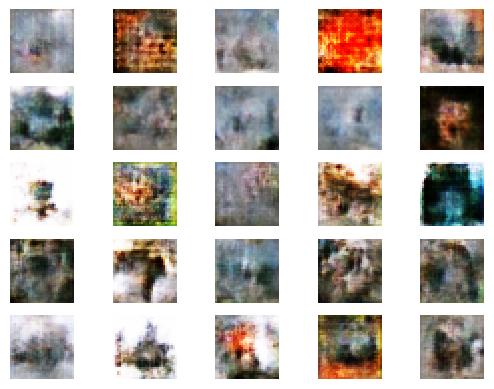

2/2 [==============================] - 0s 4ms/step
Epoch>37, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>37, Batch 2/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>37, Batch 3/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>37, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>37, Batch 5/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>37, Batch 6/390, d1=0.693, d2=0.693 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>37, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>37, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>37, Batch 10/390, d1=0.693, d2=0.6

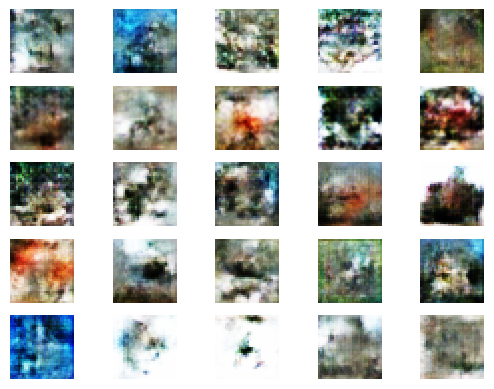

2/2 [==============================] - 0s 5ms/step
Epoch>38, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 2/390, d1=0.694, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 3/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>38, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 6/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>38, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>38, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>38, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>38, Batch 10/390, d1=0.693, d2=0.6

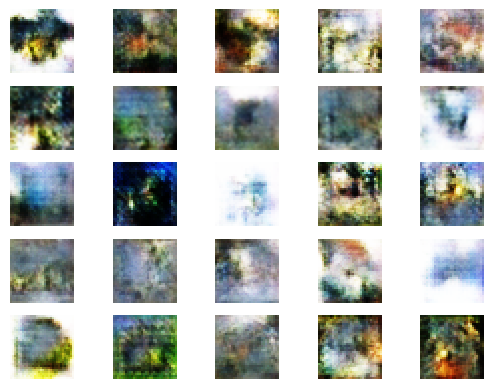

2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>39, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>39, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>39, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>39, Batch 10/390, d1=0.693, d2=0.6

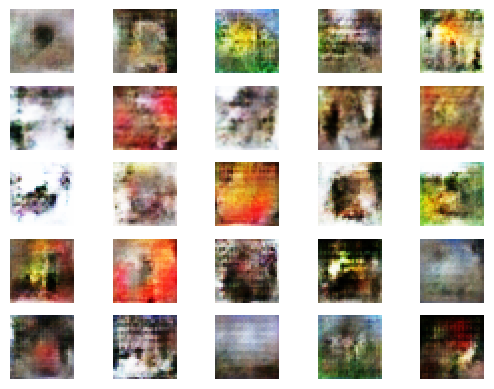

2/2 [==============================] - 0s 8ms/step
Epoch>40, Batch 1/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 4ms/step
Epoch>40, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 4/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 5/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>40, Batch 6/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 7/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>40, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>40, Batch 9/390, d1=0.693, d2=0.692 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>40, Batch 10/390, d1=0.691, d2=0.6

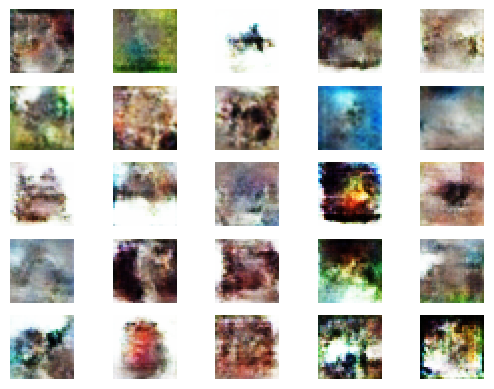

2/2 [==============================] - 0s 8ms/step
Epoch>41, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>41, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>41, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>41, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>41, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>41, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>41, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>41, Batch 10/390, d1=0.693, d2=0.6

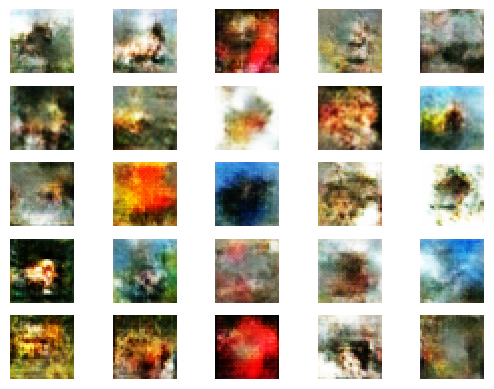

2/2 [==============================] - 0s 7ms/step
Epoch>42, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>42, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>42, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>42, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>42, Batch 6/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>42, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>42, Batch 10/390, d1=0.693, d2=0.

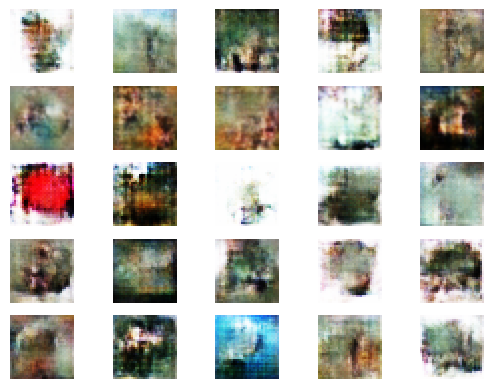

2/2 [==============================] - 0s 8ms/step
Epoch>43, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>43, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>43, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>43, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>43, Batch 10/390, d1=0.693, d2=0.6

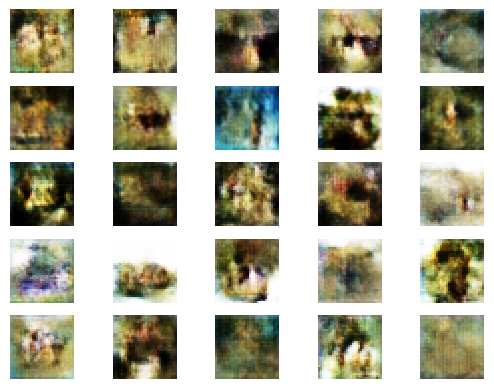

2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>44, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>44, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>44, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>44, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 10ms/step
Epoch>44, Batch 7/390, d1=0.694, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>44, Batch 8/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>44, Batch 9/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 8ms/step
Epoch>44, Batch 10/390, d1=0.694, d2=0.

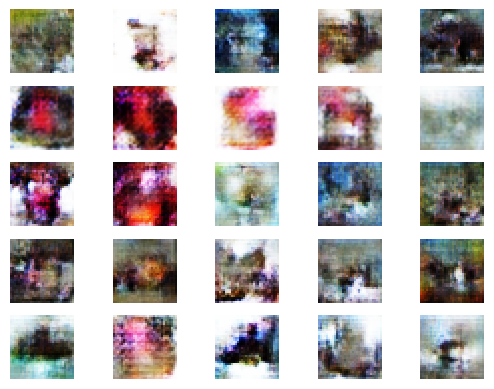

2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 1/390, d1=0.694, d2=0.693 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 2/390, d1=0.694, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>45, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>45, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>45, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 7/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>45, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>45, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>45, Batch 10/390, d1=0.693, d2=0.6

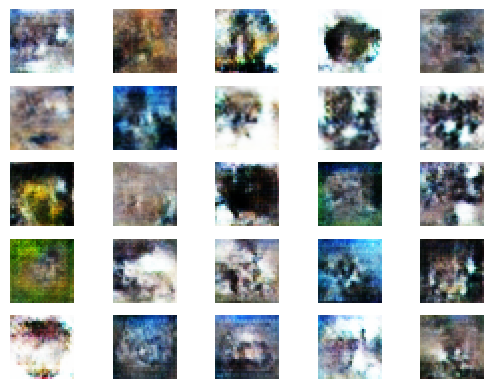

2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 1/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 3/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 6/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 7/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>46, Batch 8/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>46, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>46, Batch 10/390, d1=0.693, d2=0.6

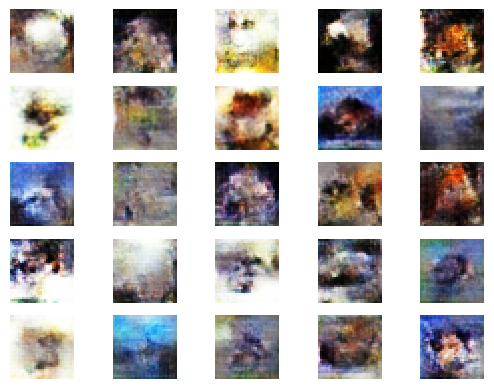

2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 1/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>47, Batch 2/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>47, Batch 4/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>47, Batch 5/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>47, Batch 7/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>47, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>47, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>47, Batch 10/390, d1=0.693, d2=0.6

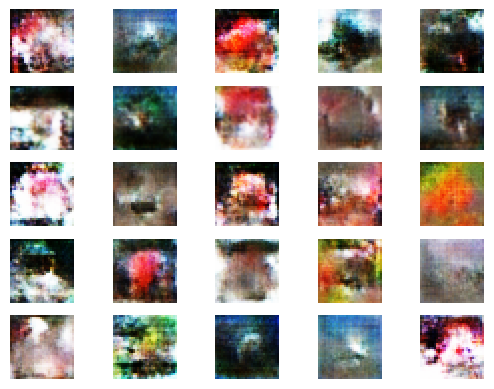

2/2 [==============================] - 0s 7ms/step
Epoch>48, Batch 1/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>48, Batch 2/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 3/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 4ms/step
Epoch>48, Batch 4/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 5/390, d1=0.694, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 6/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 7/390, d1=0.692, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 9/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>48, Batch 10/390, d1=0.693, d2=0.6

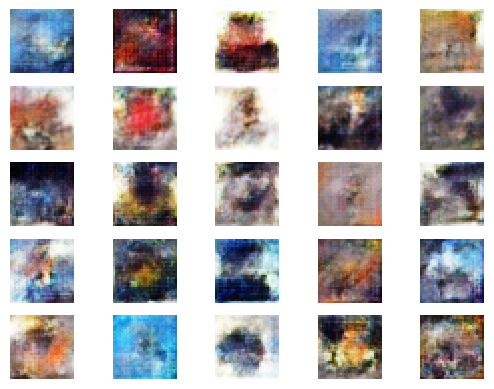

2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 1/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 2/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 3/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 7ms/step
Epoch>49, Batch 4/390, d1=0.692, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>49, Batch 5/390, d1=0.692, d2=0.694 g=0.692
2/2 [==============================] - 0s 6ms/step
Epoch>49, Batch 6/390, d1=0.692, d2=0.695 g=0.693
2/2 [==============================] - 0s 9ms/step
Epoch>49, Batch 7/390, d1=0.693, d2=0.694 g=0.692
2/2 [==============================] - 0s 4ms/step
Epoch>49, Batch 8/390, d1=0.692, d2=0.695 g=0.692
2/2 [==============================] - 0s 8ms/step
Epoch>49, Batch 9/390, d1=0.691, d2=0.694 g=0.692
2/2 [==============================] - 0s 5ms/step
Epoch>49, Batch 10/390, d1=0.691, d2=0.6

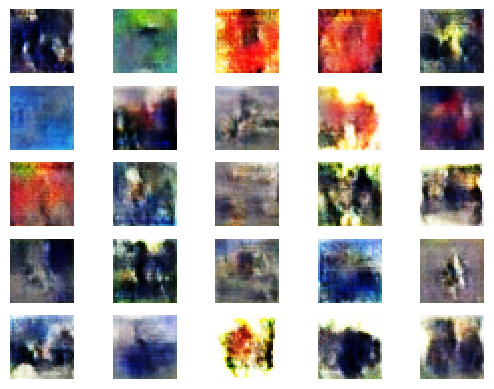

2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 1/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 7ms/step
Epoch>50, Batch 2/390, d1=0.693, d2=0.692 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 3/390, d1=0.694, d2=0.692 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 4/390, d1=0.694, d2=0.694 g=0.694
2/2 [==============================] - 0s 9ms/step
Epoch>50, Batch 5/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 6/390, d1=0.693, d2=0.693 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>50, Batch 7/390, d1=0.693, d2=0.693 g=0.694
2/2 [==============================] - 0s 5ms/step
Epoch>50, Batch 8/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 5ms/step
Epoch>50, Batch 9/390, d1=0.693, d2=0.694 g=0.693
2/2 [==============================] - 0s 6ms/step
Epoch>50, Batch 10/390, d1=0.692, d2=0.6

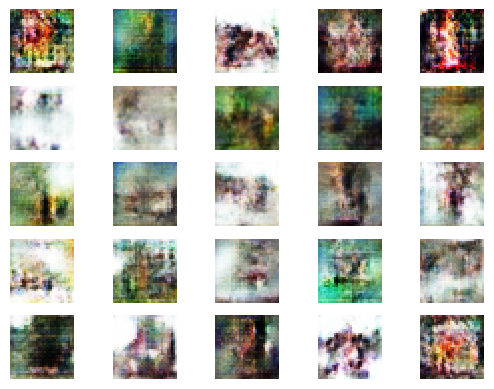

In [ ]:
# more traininggg

from keras.models import load_model
from numpy.random import randn
# size of the latent space
latent_dim = 100

# create the discriminator
discriminator = define_discriminator()

# Load the saved model
generator = load_model('/content/drive/MyDrive/GAN/cifar_GAN_2.h5')

# create the gan
gan_model = define_gan(generator, discriminator)

# load image data
dataset = load_real_samples()

# train model
train(generator, discriminator, gan_model, dataset, latent_dim, n_epochs=50)


1/1 [==============================] - 0s 96ms/step


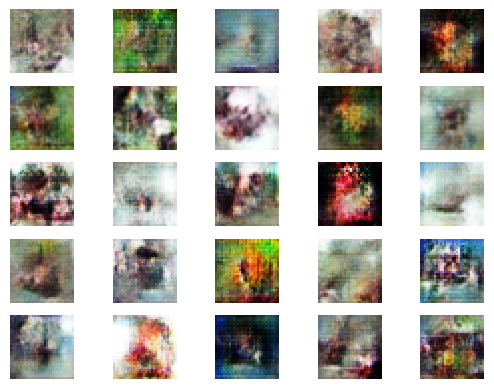

In [ ]:
from keras.models import load_model
from numpy.random import randn
import numpy as np
# load model
model = load_model('/content/drive/MyDrive/GAN/cifar_GAN_3.h5') #Model trained for 70 epochs
# generate images
latent_points = generate_latent_points(100, 25)  #Latent dim and n_samples
# generate images
X = model.predict(latent_points)
# scale from [-1,1] to [0,1]
X = (X + 1) / 2.0

import numpy as np
X = (X*255).astype(np.uint8)

# plot the result
show_plot(X, 5)

#Note: CIFAR10 classes are: airplane, automobile, bird, cat, deer, dog, frog, horse,
# ship, truck